In [64]:
from data_ini import dataFrameInitilizer
from mpl_toolkits.axes_grid.inset_locator import (inset_axes, InsetPosition,mark_inset)

import ShapeFactor as shape
import pandas as pd
import AnalFunctions as af
import numpy as np
import matplotlib.pyplot as plt
import os
import math as m
import seaborn as sns
from scipy.spatial import Delaunay
import CorFunFast as cff
import scipy.integrate
from multiprocessing import Pool
import networkx as nx
import StructureFunctions as sf
from itertools import groupby
import cmath
from ripser import ripser
from persim import plot_diagrams
from ripser import Rips
import matplotlib.cm as cm
from scipy.spatial import Voronoi, voronoi_plot_2d
from shapely.geometry import Point, Polygon
from scipy.stats import moment
import matplotlib.pyplot as plt
from matplotlib.collections import LineCollection
path, folder_list, N_runs, b, cross_var, folder_frame, test_str, test_var, test_var2, test_str2, lin_var, T_test_list, sec_test_var, N_ped, fps, mot_frac = af.var_ini()

current path is  trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/
Index(['Unnamed: 0', 'ini_folder', 'b', 'v0', 'T', 'rho', 'esigma', 'N_ped',
       'mot_frac'],
      dtype='object')
0    1.0
1    1.0
2    1.0
3    1.0
4    1.0
5    1.0
6    1.0
7    1.0
8    1.0
9    1.0
Name: T, dtype: float64
[1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
[[-2.00e-01  1.50e+01  1.34e+00  1.00e+00  2.00e+00  1.00e+03  1.00e+00
   4.00e-01]
 [-1.50e-01  1.50e+01  1.34e+00  1.00e+00  2.00e+00  1.00e+03  1.00e+00
   4.00e-01]
 [-1.00e-01  1.50e+01  1.34e+00  1.00e+00  2.00e+00  1.00e+03  1.00e+00
   4.00e-01]
 [-5.00e-02  1.50e+01  1.34e+00  1.00e+00  2.00e+00  1.00e+03  1.00e+00
   4.00e-01]
 [-0.00e+00  1.50e+01  1.34e+00  1.00e+00  2.00e+00  1.00e+03  1.00e+00
   4.00e-01]
 [ 5.00e-02  1.50e+01  1.34e+00  1.00e+00  2.00e+00  1.00e+03  1.00e+00
   4.00e-01]
 [ 1.00e-01  1.50e+01  1.34e+00  1.00e+00  2.00e+00  1.00e+03  1.00e+00
   4.00e-01]
 [ 1.50e-01  1.50e+01  1.34e+00  1.00e+00  2.00e+00  1

In [65]:
def widthOfGaußian(fwhm):
    return fwhm * np.sqrt(2) / (2 * m.sqrt(2 * np.log(2)))

def densty1d(delta_x, a):
    return np.array(list(map(lambda x: 1 / (m.sqrt(m.pi) * a) * m.e ** (-x ** 2 / a ** 2), delta_x)))

def densty1dWeight(delta_x, weight,a):
    return np.array(list(map(lambda var: var[1] / (m.sqrt(m.pi) * a) * m.e ** (-var[0] ** 2 / a ** 2), zip(delta_x,weight))))

def densityField(x_dens, y_dens, a):
    #x_dens = np.array([lattice_x - x for x in x_array])  # calculate the distant of lattice pedestrians to the measuring lattice
    #y_dens = np.array([lattice_y - y for y in y_array])

    #rho_matrix_x = np.array([densty1d(delta_x, a) for delta_x in x_dens])  # density matrix is calculated
    #rho_matrix_y = np.array([densty1d(delta_y, a) for delta_y in y_dens])
    #rho_matrix_x = densty1d(x_dens, a)
    #rho_matrix_y = densty1d(y_dens, a)
    
    rho_matrix_x = np.array([densty1d(delta_x, a) for delta_x in x_dens])  # density matrix is calculated
    rho_matrix_y = np.array([densty1d(delta_y, a) for delta_y in y_dens])
    
    rho_matrix = np.matmul(rho_matrix_x, np.transpose(rho_matrix_y))
    return rho_matrix.T

def xdensYdens(lattice_x,lattice_y,x_array,y_array):
    x_dens = np.array([lattice_x - x for x in x_array])  # calculate the distant of lattice pedestrians to the measuring lattice
    y_dens = np.array([lattice_y - y for y in y_array])
    return x_dens,y_dens

def orderField(x_dens,y_dens,order,a):
    #x_dens = np.array([lattice_x - x for x in x_array])  # calculate the distant of lattice pedestrians to the measuring lattice
    #y_dens = np.array([lattice_y - y for y in y_array])
    #rho_matrix_x = densty1d(x_dens, a)  # density matrix is calculated
    #rho_matrix_y = densty1dWeight(y_dens, order, a)
    rho_matrix_x = np.array([densty1d(delta_x, a) for delta_x in x_dens])  # density matrix is calculated
    rho_matrix_y = np.array([densty1dWeight(delta_y,order, a) for delta_y in y_dens])
    rho_matrix = np.matmul(rho_matrix_x, np.transpose(rho_matrix_y))
    order_matrix = rho_matrix.T#/densityField(x_dens, y_dens, a)
    
    return order_matrix

def OrderFieldPlot(order_matrix_2,x_heat,y_heat,XY_red,foldername,datname,form,value_max,value_min,colorscheme,savenpy):    
    #print(np.array(order_matrix_2).mean())
    #print(XY_red['Bf'].values.mean())
    if foldername != False:
        foldermaker(foldername)
    #os.system("mkdir " + path + "plots/structure" + foldername)
    if savenpy:
        np.save(path + "plots/structure/"+ foldername + datname + ".npy",np.array(order_matrix_2))
    ordermatrix = np.array(order_matrix_2).mean(axis=1).mean(axis=0)[:-1, :-1]
    z_min, z_max = ordermatrix.min(), ordermatrix.max()

    fig, ax = plt.subplots(figsize = (13, 10))
    if value_max == "none":
        value_max = z_max
    if value_min == "none":
        value_min = z_min
    c = ax.pcolormesh(x_heat, y_heat, ordermatrix, cmap=colorscheme,vmin = value_min, vmax = value_max)
    # set the limits of the plot to the limits of the data
    ax.axis([x_heat.min(), x_heat.max(), y_heat.min(), y_heat.max()])
    fig.colorbar(c, ax=ax)
    if foldername != False:
        plt.savefig(path + "plots/structure/"+ foldername + datname + "." + form)
    plt.show()


In [66]:
def widthOfGaußian(fwhm):
    return fwhm * np.sqrt(2) / (2 * m.sqrt(2 * np.log(2)))

def densty1d(delta_x, a):
    return np.array(list(map(lambda x: 1 / (m.sqrt(m.pi) * a) * m.e ** (-x ** 2 / a ** 2), delta_x)))

def densty1dWeight(delta_x, weight,a):
    return np.array(list(map(lambda var: var[1] / (m.sqrt(m.pi) * a) * m.e ** (-var[0] ** 2 / a ** 2), zip(delta_x,weight))))

def densityField(x_dens, y_dens, a):
    #x_dens = np.array([lattice_x - x for x in x_array])  # calculate the distant of lattice pedestrians to the measuring lattice
    #y_dens = np.array([lattice_y - y for y in y_array])

    #rho_matrix_x = np.array([densty1d(delta_x, a) for delta_x in x_dens])  # density matrix is calculated
    #rho_matrix_y = np.array([densty1d(delta_y, a) for delta_y in y_dens])
    #rho_matrix_x = densty1d(x_dens, a)
    #rho_matrix_y = densty1d(y_dens, a)
    
    rho_matrix_x = np.array([densty1d(delta_x, a) for delta_x in x_dens])  # density matrix is calculated
    rho_matrix_y = np.array([densty1d(delta_y, a) for delta_y in y_dens])
    
    rho_matrix = np.matmul(rho_matrix_x, np.transpose(rho_matrix_y))
    return rho_matrix.T

def xdensYdens(lattice_x,lattice_y,x_array,y_array):
    x_dens = np.array([lattice_x - x for x in x_array])  # calculate the distant of lattice pedestrians to the measuring lattice
    y_dens = np.array([lattice_y - y for y in y_array])
    return x_dens,y_dens

def orderField(x_dens,y_dens,order,a):
    #x_dens = np.array([lattice_x - x for x in x_array])  # calculate the distant of lattice pedestrians to the measuring lattice
    #y_dens = np.array([lattice_y - y for y in y_array])
    #rho_matrix_x = densty1d(x_dens, a)  # density matrix is calculated
    #rho_matrix_y = densty1dWeight(y_dens, order, a)
    rho_matrix_x = np.array([densty1d(delta_x, a) for delta_x in x_dens])  # density matrix is calculated
    rho_matrix_y = np.array([densty1dWeight(delta_y,order, a) for delta_y in y_dens])
    rho_matrix = np.matmul(rho_matrix_x, np.transpose(rho_matrix_y))
    order_matrix = rho_matrix.T#/densityField(x_dens, y_dens, a)
    
    return order_matrix

def OrderFieldPlot(order_matrix_2,x_heat,y_heat,XY_red,foldername,datname,form,value_max,value_min,colorscheme,savenpy):    
    #print(np.array(order_matrix_2).mean())
    #print(XY_red['Bf'].values.mean())
    if foldername != False:
        foldermaker(foldername)
    #os.system("mkdir " + path + "plots/structure" + foldername)
    if savenpy:
        np.save(path + "plots/structure/"+ foldername + datname + ".npy",np.array(order_matrix_2))
    ordermatrix = np.array(order_matrix_2).mean(axis=1).mean(axis=0)[:-1, :-1]
    z_min, z_max = ordermatrix.min(), ordermatrix.max()

    fig, ax = plt.subplots(figsize = (13, 10))
    if value_max == "none":
        value_max = z_max
    if value_min == "none":
        value_min = z_min
    c = ax.pcolormesh(x_heat, y_heat, ordermatrix, cmap=colorscheme,vmin = value_min, vmax = value_max)
    # set the limits of the plot to the limits of the data
    ax.axis([x_heat.min(), x_heat.max(), y_heat.min(), y_heat.max()])
    fig.colorbar(c, ax=ax)
    if foldername != False:
        plt.savefig(path + "plots/structure/"+ foldername + datname + "." + form)
    plt.show()


In [67]:
def foldermaker(foldername):
    folder = ''
    folderold = ''
    for l in foldername:
        if l != "/":
            folder += l
        else:
            print(folder)
            if folderold == '':
                os.system("mkdir " + path + "plots/structure/" + folder)
            else:
                os.system("mkdir " + path + "plots/structure/"+ folderold + "/" + folder)
            folderold = folder
            folder = ''
         
        
def add_wall(line_width,bi):
    wall1 = plt.Line2D((-bi / 2, -bi / 2), (0, 100), lw=line_width)
    wall2 = plt.Line2D((bi / 2, bi / 2), (0, 100), lw=line_width)
    wall3 = plt.Line2D((-bi / 2, -0.45), (0, 0), lw=line_width)
    wall4 = plt.Line2D((0.45, bi / 2), (0, 0), lw=line_width)
    wall5 = plt.Line2D((0.45, 0.25), (0., -0.15), lw=line_width)
    wall6 = plt.Line2D((-0.45, -0.25), (0., -0.15), lw=line_width)
    wall7 = plt.Line2D((0.25, 0.25), (-0.15, -1.0), lw=line_width)
    wall8 = plt.Line2D((-0.25, -0.25), (-0.15, -1.), lw=line_width)
    plt.gca().add_line(wall1)
    plt.gca().add_line(wall2)
    plt.gca().add_line(wall3)
    plt.gca().add_line(wall4)
    plt.gca().add_line(wall5)
    plt.gca().add_line(wall6)
    plt.gca().add_line(wall7)
    plt.gca().add_line(wall8)
            
"""def plotter(df,esigmas,test2,plotinfo,factor,xscale,binval,bins,inter,color,error_bar,label):
    for t2 in test2:
        df_t2 = df[df[test_str2] == t2]
        for esigma in esigmas:
            df_sigma = df_t2[df_t2['esigma'] == esigma]
            df_sigma = grouper(df_sigma,binval,bins,inter)
            
            plot = df_sigma.groupby(bins).mean()
            #print(df_sigma)
            if binval == xscale:
                xplot = plot[binval].index
            else:
                xplot = plot[xscale]
            if error_bar:
                plot = df_sigma.groupby(bins)[factor].mean()
                p025 = df_sigma.groupby(bins)[factor].quantile(0.025)
                p975 = df_sigma.groupby(bins)[factor].quantile(0.975)
                yerr = [plot - p025, plot - p025]
                plt.errorbar(plot.index,plot,yerr,marker = "o",linestyle = "none")
            else:
                if color:
                    #plt.scatter(xplot,plot[factor],c = plot[binval],label = "$\sigma$ = " + str(esigma))
                    cm = plt.cm.get_cmap("plasma")
                    sc = plt.scatter(xplot,plot[factor], c = plot[binval] , cmap=cm)
                    fig.colorbar(sc,ax = ax)
                else:
                    return plt.scatter(xplot,plot[factor],label = label)"""

def plotter(df,esigmas,test2,plotinfo,factor,xscale,binval,bins,inter,color,error_bar,label):
    for t2 in test2:
        print("t2 = ", t2)
        df_t2 = df[df[test_str2] == t2]
        for esigma in esigmas:
            df_sigma = df_t2[df_t2['esigma'] == esigma]
            df_sigma = grouper(df_sigma,binval,bins,inter)
            
            plot = df_sigma.groupby([bins]).mean()
            yerr = df_sigma.groupby([bins]).std()
            #print(df_sigma)
            if binval == xscale:
                xplot = plot[binval].index
            else:
                xplot = plot[xscale]
            if error_bar:

                plt.errorbar(xplot,plot[factor],yerr[factor],marker='o',linestyle = "none",label = label)
            else:
                if color:
                    #plt.scatter(xplot,plot[factor],c = plot[binval],label = "$\sigma$ = " + str(esigma))
                    cm = plt.cm.get_cmap("plasma")
                    sc = plt.scatter(xplot,plot[factor], c = plot[binval] , cmap=cm)
                    fig.colorbar(sc,ax = ax)
                else:
                    return plt.scatter(xplot,plot[factor],label = label)
    
def labeler(label):
    if label == "Nd":
        return "<1/d> in $m^{-1}$"
    if label == "r":
        return "r in m"
    if label == "Bf":
        return "$\psi_6$"
    if label == "Dm":
        return "var(d)"
    if label == "speed_nn":
        return "v in m/s"
    if label == "angle":
        return "$\Theta$ in rad"
    if label == "dens":
        return "$\\rho$ in $m^2$"
    if label == "second":
        return "$t$ in s"
    return "unknown label"

In [68]:
def orderfilter(df_new,filtervalue,lb,hb,order,i,superior):
    df_i = df_new[df_new['i'] == i]
    df_i = df_i[df_i[filtervalue] > lb]
    df_i = df_i[df_i[filtervalue] < hb]

    if superior:
        df_i = df_i[df_i['Bf'] >= order]
    else:
        df_i = df_i[df_i['Bf'] < order]
    return df_i['id'].values

def putter(counter,filler,filling,count_up = True):
    arange = np.arange(counter,counter + filling.shape[0])
    np.put(filler,arange,filling)
    if count_up:
        counter += filling.shape[0]
        return counter
    return

def grouper(df_bin,binval,bins,inter):
    minval = df_bin[binval].min()
    maxval = df_bin[binval].max()
    #print(minval,maxval)
    interval_range = np.arange(minval,maxval + inter,inter)

    lables = [i for i in interval_range]
    #print(lables)
    bins_array = np.arange(minval-inter,maxval+inter,inter)
    #print(bins_array)
    df_bin[bins] = pd.cut(x = df_bin[binval], bins=bins_array, labels=[i for i in interval_range])
    return df_bin

def filtrationplot(df_g,graphs,color,size):
    for g,col in zip(graphs,color):
        graph_list = []
        """if len(g) > size:
            graph_list.append(list(g))
            graph_len.append(len(list(g)))"""
        df_cg = df_g[df_g['id'].isin(g)]
        ax.scatter(df_cg['x'], df_cg['y'],c = col)

def ShapeFactor(lat,room):
    if lat.shape[0] == 0:
        print("WARING: lat.shape[0] = 0")
        return
    vor = Voronoi(lat,qhull_options='Qbb Qc Qx')
    vert = vor.regions
    rig_vert = []
    poly_room = shape.room_geo(room)
    centerpoints = []
    for note,centerpoint,i in zip(vert,vor.points,range(vor.points.shape[0])):
        if -1 in note:
            continue
        rig_vert.append(note)
        ki = np.where(vor.point_region == i)[0][0]
        centerpoints.append(vor.points[ki])

    pol_area_list = []
    pol_perimeter_list = []
    pol_centroid_x = []
    pol_centroid_y = []
    for note in rig_vert:
        coords = [(vor.vertices[i][0], vor.vertices[i][1]) for i in note]
        poly = Polygon(coords)
        if poly.centroid.within(poly_room):
            pol_area_list.append(poly.area)
            pol_perimeter_list.append(poly.length)
            pol_centroid_x.append(poly.centroid.x)
            pol_centroid_y.append(poly.centroid.y)

    return np.array(pol_perimeter_list) ** 2 / (4 * np.pi * np.array(pol_area_list)),np.array(centerpoints)[:,0],np.array(centerpoints)[:,1]

def addPedFrame(box):
    Nx = int((box[1] - box[0]) * 10)
    Ny = int((box[3] - box[2]) * 10)
    x_frame = np.linspace(box[0],box[1],Nx)
    x_frame = np.append(x_frame, np.linspace(box[0],box[1],Nx))
    x_frame = np.append(x_frame, sf.listMaker(box[0],Ny))
    x_frame = np.append(x_frame, sf.listMaker(box[1],Ny))
    
    y_frame = sf.listMaker(box[2],Nx)
    y_frame = np.append(y_frame,sf.listMaker(box[3],Nx))
    y_frame = np.append(y_frame,np.linspace(box[2],box[3],Ny) )
    y_frame = np.append(y_frame,np.linspace(box[2],box[3],Ny))
    
    return np.array([np.array([xi, yi]) for xi, yi in zip(x_frame, y_frame)])

    

In [69]:
def groupPlot(df_total,xval,yval,ax_i,inter,error,label = " "):
    df_grouped = grouper(df_total,xval,"val_0",inter)
    plot = df_grouped.groupby(["val_0"]).mean()
    
    xplot = plot[xval]
    if error:
        val_0_sorted = np.sort(np.unique(df_grouped.val_0.to_numpy()))
        error_list025 = []
        error_list075 = []

        for val_0,ymean in zip(val_0_sorted,plot[yval]):
            #print(val_0)
            df_g = df_grouped[df_grouped.val_0 == val_0]

            error_list025.append(ymean - np.quantile(df_g[yval],0.15))
            error_list075.append(np.quantile(df_g[yval],0.75) - ymean)

            #print(interval95)
        errors = np.array([error_list025[1:],error_list075[1:]])

        #print(errors)
        #plt.scatter(plot[xval],plot[yval])
        #print([error_list025,error_list075][2:])
        ax_i.errorbar(
            plot[xval][1:],
            plot[yval][1:],
            yerr = errors,
            marker = "o",
            linestyle = "none",
            label = label)
    else:
        ax_i.scatter(xplot,plot[yval],label = label)

def densNormCalc(df_r,t_list,alpha):
    i_list = np.unique(df_r.i.to_numpy())
    print(i_list)
    mean_dens_list = []
    dens_normal = np.empty(df_r.shape[0])
    counter = 0
    for i in i_list:
        #print(i)
        df_i = df_r[df_r['i'] == i]
        #df_i = df
        #df_i = df_i.sort_values(by = ['second','x','y'])
        for t in t_list:
            df_t = df_i[df_i['second'] == t]
            #print(df_t.shape)
            #df_t = df_t.sort_values(by = ['x','y'])
            #print(df_t['x'].to_numpy(),df_t['y'].to_numpy())
            length = df_t.shape[0]
            #mean_dens = df_t['dens'].to_numpy().mean()
            #std_dens = df_t['dens'].to_numpy().std()

            mean_dens = df_t['dens'].to_numpy().mean()
            std_dens = df_t['dens'].to_numpy().std()

            mean_dens_array = ((df_t.dens.to_numpy() - mean_dens)   / std_dens) * (df_t.dens.to_numpy()/rho_max) ** alpha  

            #mean_dens_array = (df_t['dens'].to_numpy() - mean_dens)/std_dens
            counter =  putter(counter,dens_normal,mean_dens_array)
    df_r['dens_norm'] = dens_normal
    return df_r

def dfRsegmenter(df_seg,r_min,r_max,r_jump,t_list,alpha):
    df_r_list = []
    r_list = np.arange(r_min,r_max,r_jump)
    for r in r_list:
        df_r = df_seg[df_seg.r > r]
        df_r = df_r[df_r.r <= r + r_jump]
        df_r = densNormCalc(df_r,t_list,alpha)
        df_r_list.append(df_r)
    return df_r_list

def dfMeanDensityAtTimeMaker(df_r_list,t_array):
    mean = []
    for df_r in df_r_list:
        mean_r = []
        for t in t_array:
            df_tr = df_r[df_r['second'] == t]
            mean_r.append(round(df_tr.dens.mean(),2))
        mean.append(mean_r)
    
    map_df = {'t':t_array}
    for m,z in zip(mean,range(len(mean))):
        map_df['z' + str(z)] = m
    df_mean = pd.DataFrame(map_df)
    return df_mean

def timeListEqualDensityMaker(df_mean,mean_list,meanint):
    
    df_mean_keys = df_mean.keys().to_numpy()[1:]
    time_list = []

    for ml in mean_list:
        print(ml)
        time_list_i = []
        for key in df_mean_keys:
            df_filter = df_mean[df_mean[key] > ml]
            time_filter = df_filter[df_filter[key] < ml + meanint]['t'].to_numpy()
            if time_filter.shape[0] > 0:
                time_list_i.append(df_filter[df_filter[key] < ml + meanint]['t'].to_numpy()[0])
            else:
                print("WARNING: density is nan")

        time_list.append(time_list_i)
    return time_list

def dfMeanDensityCombine(df_r_list,t_ml):
    df_tr_list = []
    for df_r,ti in zip(df_r_list,t_ml):
        df_tr = df_r[df_r.second == ti]
        df_tr_list.append(df_tr)
    df_total = pd.concat(df_tr_list)
    return df_total

In [70]:
def VoronoiRidges(vor,ax):
    lines = []
    for simplex in vor.ridge_vertices:
            simplex = np.asarray(simplex)
            if np.all(simplex >= 0):
                #print(vor.vertices[simplex, 0])
                lines.append([(vor.vertices[simplex, 0][0],vor.vertices[simplex, 1][0]) , (vor.vertices[simplex, 0][1],vor.vertices[simplex, 1][1])])
                #x.append(vor.vertices[simplex, 0])
                #y.append(vor.vertices[simplex, 1])


    #lines = [[(0, 1), (1, 1)], [(2, 3), (3, 3)], [(1, 2), (1, 3)]]
    #print(lines)
    lc = LineCollection(lines,color = 'black')
    ax.add_collection(lc)
    ax.autoscale()
    
def frameOrderFilter(df_i,filtertime,threshold,i,supremumfilter):
    id_list = sf.orderfilter(df_i,filtertime,threshold,i,supremumfilter)
    df_filtered = df_i[df_i['id'].isin(id_list)]
    
    return df_filtered

def PlotHistogramHeatMap(df_h,distvalue,dimension,dr,bin_array,r_array,ax_i,colormap,max_scale):
    DensityHeatMatrix = np.empty([r_array.shape[0],bin_array[:-1].shape[0]],dtype = float)
    for r,i in zip(r_array,range(r_array.shape[0])):
        df_t_r = df_h[(df_h[dimension] > r) & (df_h[dimension] < r + dr) ]
        #print(df_t_r.shape)
        n,bins = np.histogram(df_t_r[distvalue], bins = bin_array, density = True)
        DensityHeatMatrix[i,:] = n
    vmax = DensityHeatMatrix.max()/max_scale
    vmin = DensityHeatMatrix.min()
    #print(vmin,vmax)
    ax_i.pcolormesh(bin_array, r_array, DensityHeatMatrix, cmap = colormap,vmin = vmin, vmax = vmax)
    
def add_wall(line_width,bi,ax):
    wall1 = plt.Line2D((-bi / 2, -bi / 2), (0, 100), lw=line_width)
    wall2 = plt.Line2D((bi / 2, bi / 2), (0, 100), lw=line_width)
    wall3 = plt.Line2D((-bi / 2, -0.45), (0, 0), lw=line_width)
    wall4 = plt.Line2D((0.45, bi / 2), (0, 0), lw=line_width)
    wall5 = plt.Line2D((0.45, 0.25), (0., -0.15), lw=line_width)
    wall6 = plt.Line2D((-0.45, -0.25), (0., -0.15), lw=line_width)
    wall7 = plt.Line2D((0.25, 0.25), (-0.15, -1.0), lw=line_width)
    wall8 = plt.Line2D((-0.25, -0.25), (-0.15, -1.), lw=line_width)
    ax.add_line(wall1)
    ax.add_line(wall2)
    ax.add_line(wall3)
    ax.add_line(wall4)
    ax.add_line(wall5)
    ax.add_line(wall6)
    ax.add_line(wall7)
    ax.add_line(wall8)

def EvacuationPlot(sec,df_i,x_min,x_max,y_min,y_max,ax):
    df_ti_i = df_i[df_i['second'] == sec]
    cm = plt.cm.get_cmap('plasma')
    add_wall(2.5,50,ax)
    for x,y in zip(df_ti_i['x'],df_ti_i['y']):
        circ = plt.Circle((x,y), radius=0.2, color='grey',alpha = 0.5)
        ax.add_patch(circ)
    #ax.scatter(df_ti_i['x'],df_ti_i['y'], c = df_ti_i['Bf'], cmap=cm,vmax = 1,vmin = 0, alpha = 1)
    ax.scatter(df_ti_i['x'],df_ti_i['y'])
    
def groupValPlot(df_total,groupval,xval,yval,ax_i,inter,error,color,colormap,label = ' '):
    df_grouped = grouper(df_total,groupval,"val_0",inter)
    df_grouped = df_grouped[df_grouped.r > 1]
    #print(df_grouped.sort_values(by = "val_0"))
    plot = df_grouped.groupby(["val_0"]).mean()
    xplot = plot[xval]
    if error:
        val_0_sorted = np.sort(np.unique(df_grouped.val_0.to_numpy()))
        error_list025 = []
        error_list075 = []

        for val_0,ymean in zip(val_0_sorted,plot[yval]):
            df_g = df_grouped[df_grouped.val_0 == val_0]
            error_list025.append(ymean - np.quantile(df_g[yval],0.025))
            error_list075.append(np.quantile(df_g[yval],0.975) - ymean)
        errors = np.array([error_list025[1:],error_list075[1:]])
        ax_i.errorbar(
            plot[xval][1:],
            plot[yval][1:],
            yerr = errors,
            marker = "o",
            linestyle = "none",
            label = label)
    else:
        if color:
            print(plot.index.min(),plot.index.max())
            ax_i.scatter(xplot,plot[yval], c = plot[groupval],cmap = colormap, vmin = plot.index.min(), vmax = plot.index.max(), label = label)
        else:
            ax_i.scatter(xplot,plot[yval],label = label)
            
def PlotHistogramHeatMap(df_h,distvalue,dimension,dr,bin_array,r_array,ax_i,colormap,max_scale,ranges = True):
    DensityHeatMatrix = np.empty([r_array.shape[0],bin_array[:-1].shape[0]],dtype = float)
    for r,i in zip(r_array,range(r_array.shape[0])):
        if ranges:
            df_t_r = df_h[(df_h[dimension] > r) & (df_h[dimension] < r + dr)]
        else:
            df_t_r = df_h[(df_h[dimension] == r)]
        #print(df_t_r.shape)
        n,bins = np.histogram(df_t_r[distvalue], bins = bin_array, density = True)
        DensityHeatMatrix[i,:] = n
    #print(n,bins)
    vmax = DensityHeatMatrix.max()/max_scale
    vmin = DensityHeatMatrix.min()
    #print(vmin,vmax)
    ax_i.pcolormesh(bin_array, r_array, DensityHeatMatrix, cmap = colormap,vmin = vmin, vmax = vmax)
    
def HistoPlot(data,bins_array,ax_i,color,marker,label):
    n,bins = np.histogram(data,bins = bins_array,density = True)
    line, = ax_i.plot((bins[:-1] + bins[1:])/2,n,color = color,marker = marker,linestyle = "none",label = label)
    return line

def imgName(i):
    if i < 10:
        return "00" + str(i)
    if i >= 10 and i < 100:
        return "0" + str(i) 
    if i < 1000:
        return str(i)

def filelistWriter(load,li,lf,index_bool,ind,time_list):
    
    path, folder_list, N_runs, b, cross_var, folder_frame, test_str, test_var, test_var2, test_str2, lin_var, T_test_list, sec_test_var, N_ped, fps, mot_frac = af.var_ini()
    af.file_writer(path, folder_list, N_runs, b, cross_var, folder_frame, test_str, test_var)

    sl = "/"
    T_test_list = lin_var[test_var2]
    lattice_type = 'jule'
    runs_tested = N_runs
    traj_testvar2 = []

    sf.folderBuilder(path)
    x_min = 7
    x_max = -7
    y_min = 0
    y_max = 14
    box= [x_min,x_max,y_min,y_max]
    x_l = []
    y_l = []
    col = ["ID","FR","X","Y","speed_nn","COLOR","ANGLE"]
    #col = ["id" ,"frame", "x/cm", "y/cm"]
    sig = 3.

    t2 = T_test_list[-1]

    T_test_list = [T_test_list[-1]]
    esigmas = lin_var[test_var][li:lf]
    print("esigmas = ", esigmas)

    blist = 2 * lin_var[test_var]
    filtered = True
    XYFileSystem = []
    #time_list = np.arange(0,900,1)
    time_list = sorted(np.unique(time_list))

    for T_test in T_test_list:
        bi = li
        loc_list = sf.folderCollector(folder_frame,T_test)
        loc_list = loc_list[li:lf]
        for loc_list_runs in loc_list:
            print("<calculating " + test_str + " = " + str(lin_var[test_var][bi]) + ">")
            print(len(loc_list_runs))
            df_list = []
            for loc, ni in zip(loc_list_runs,range(len(loc_list_runs))):
                if sf.filechecker(loc) and load:
                    continue
                print("ni = ", ni)
                df_list.append(sf.fileload(loc,load,col))
                    
            
            for second in time_list:
                print("second = " , second)
                for df, ni in zip(df_list,range(len(df_list))):
                    csvname = path + "plots/structure/XYcsv/" + af.b_data_name(lin_var[test_var][bi],3) + "t" + str(second) + "runi_" + str(ni) + test_str2+ str(T_test) + ".csv"
                    print(csvname)
                    if os.path.isfile(csvname):
                        print("file exists")
                        df_read = pd.read_csv(csvname)
                        box = [df_read['x'].min() - 0.1,df_read['x'].max() + 0.1,df_read['y'].min() - 0.1,df_read['y'].max() - 0.1]
                        keys = df_read.keys()
                        if 'id' in keys:
                            print("id is in keys")
                        #else:
                            #sf.orderfetch(second,ni,df,fps,test_str2,T_test,csvname,True,box)
                        
                    #else:
                        #sf.orderfetch(second ,ni,df,fps,test_str2,T_test,csvname,True,box)
                    XYFileSystem.append([csvname,second,ni,lin_var[test_var][bi],T_test])
            bi += 1
            
    dfcsv = pd.DataFrame()
    dfcsv['files'] = [i[0] for i in XYFileSystem]
    dfcsv['time'] = [i[1] for i in XYFileSystem]
    dfcsv['index'] = [i[2] for i in XYFileSystem]
    dfcsv['testvar'] = [i[3] for i in XYFileSystem]
    dfcsv[test_str2] = [i[4] for i in XYFileSystem]
    if index_bool:
        dfcsv = dfcsv[dfcsv['index'].isin(ind)]
    dfcsv.to_csv(path + "plots/structure/XYcsv/filelist.csv")

In [74]:
load = True
esigmas = lin_var[test_var]
print(esigmas)
"""li = 1 #points in test_list
lf = li + 1"""
li = 0 #points in test_list
lf = -1
index_bool = True
range_max = 1
ind = np.arange(0,range_max)
print(ind)
t_max = 2200
t_min = 0
t_int = int((t_max - t_min)/61)
t_jump = 10

#time_list = np.arange(0,1000,50)

#time_list = np.arange(0,1000,10)
#time_list = np.append(time_list,np.arange(1000,11000,50))
#time_list = np.arange(0,10000,100)
time_list = np.arange(100,200,1)
#time_list = [350,450,500,600]
print(time_list)
#time_list = np.arange(0,1000,50)
#time_list = np.append(time_list,np.arange(1500,11000,500))
#time_list = np.array([100,400,750,1060,1350,1700,2000,4000,7000,10000])
#time_list = np.append(time_list,np.arange(1000,11000,50))
#print(time_list)
#time_list = [1440,1506,1542,1604,1640,1728,1830,1928,2082,2190]
#time_list = time_list[::10]

[-0.2  -0.15 -0.1  -0.05 -0.    0.05  0.1   0.15  0.2   0.25]
[0]
[100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135
 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153
 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171
 172 173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189
 190 191 192 193 194 195 196 197 198 199]


In [75]:
#df = pd.read_csv("14_06_2021_large_simulation_with_shape.csv")

In [90]:
df,df_list = dataFrameInitilizer(load,li,lf,index_bool,ind,time_list)


current path is  trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/
Index(['Unnamed: 0', 'ini_folder', 'b', 'v0', 'T', 'rho', 'esigma', 'N_ped',
       'mot_frac'],
      dtype='object')
0    1.0
1    1.0
2    1.0
3    1.0
4    1.0
5    1.0
6    1.0
7    1.0
8    1.0
9    1.0
Name: T, dtype: float64
[1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
[[-2.00e-01  1.50e+01  1.34e+00  1.00e+00  2.00e+00  1.00e+03  1.00e+00
   4.00e-01]
 [-1.50e-01  1.50e+01  1.34e+00  1.00e+00  2.00e+00  1.00e+03  1.00e+00
   4.00e-01]
 [-1.00e-01  1.50e+01  1.34e+00  1.00e+00  2.00e+00  1.00e+03  1.00e+00
   4.00e-01]
 [-5.00e-02  1.50e+01  1.34e+00  1.00e+00  2.00e+00  1.00e+03  1.00e+00
   4.00e-01]
 [-0.00e+00  1.50e+01  1.34e+00  1.00e+00  2.00e+00  1.00e+03  1.00e+00
   4.00e-01]
 [ 5.00e-02  1.50e+01  1.34e+00  1.00e+00  2.00e+00  1.00e+03  1.00e+00
   4.00e-01]
 [ 1.00e-01  1.50e+01  1.34e+00  1.00e+00  2.00e+00  1.00e+03  1.00e+00
   4.00e-01]
 [ 1.50e-01  1.50e+01  1.34e+00  1.00e+00  2.00e+00  1

second =  100
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_2t100runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  101
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_2t101runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  102
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_2t102runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  103
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_2t103runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  104
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_2t104runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  105
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plo

second =  145
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_2t145runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  146
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_2t146runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  147
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_2t147runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  148
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_2t148runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  149
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_2t149runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  150
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plo

second =  190
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_2t190runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  191
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_2t191runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  192
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_2t192runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  193
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_2t193runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  194
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_2t194runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  195
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plo

second =  135
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_15t135runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  136
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_15t136runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  137
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_15t137runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  138
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_15t138runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  139
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_15t139runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  140
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigm

second =  180
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_15t180runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  181
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_15t181runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  182
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_15t182runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  183
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_15t183runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  184
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_15t184runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  185
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigm

second =  125
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_1t125runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  126
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_1t126runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  127
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_1t127runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  128
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_1t128runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  129
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_1t129runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  130
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plo

second =  170
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_1t170runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  171
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_1t171runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  172
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_1t172runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  173
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_1t173runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  174
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_1t174runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  175
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plo

second =  115
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_05t115runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  116
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_05t116runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  117
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_05t117runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  118
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_05t118runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  119
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_05t119runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  120
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigm

second =  160
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_05t160runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  161
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_05t161runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  162
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_05t162runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  163
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_05t163runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  164
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_05t164runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  165
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigm

second =  105
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_0t105runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  106
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_0t106runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  107
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_0t107runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  108
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_0t108runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  109
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_0t109runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  110
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plo

second =  150
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_0t150runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  151
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_0t151runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  152
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_0t152runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  153
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_0t153runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  154
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_0t154runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  155
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plo

second =  195
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_0t195runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  196
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_0t196runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  197
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_0t197runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  198
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_0t198runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  199
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/-0_0t199runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
<calculating esigma = 0.05>
1
False
ni =  0
second =  100
trajectories/ini_lm_N_ped10

second =  140
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/0_05t140runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  141
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/0_05t141runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  142
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/0_05t142runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  143
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/0_05t143runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  144
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/0_05t144runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  145
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plo

second =  185
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/0_05t185runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  186
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/0_05t186runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  187
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/0_05t187runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  188
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/0_05t188runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  189
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/0_05t189runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  190
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plo

second =  130
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/0_1t130runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  131
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/0_1t131runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  132
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/0_1t132runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  133
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/0_1t133runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  134
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/0_1t134runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  135
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/st

second =  176
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/0_1t176runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  177
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/0_1t177runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  178
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/0_1t178runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  179
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/0_1t179runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  180
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/0_1t180runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  181
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/st

second =  121
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/0_15t121runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  122
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/0_15t122runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  123
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/0_15t123runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  124
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/0_15t124runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  125
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/0_15t125runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  126
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plo

second =  166
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/0_15t166runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  167
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/0_15t167runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  168
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/0_15t168runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  169
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/0_15t169runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  170
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/0_15t170runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  171
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plo

second =  111
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/0_2t111runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  112
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/0_2t112runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  113
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/0_2t113runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  114
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/0_2t114runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  115
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/0_2t115runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  116
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/st

second =  157
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/0_2t157runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  158
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/0_2t158runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  159
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/0_2t159runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  160
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/0_2t160runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  161
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/structure/XYcsv/0_2t161runi_0T1.0.csv
Calculate Order
(1000,)
(1100,) (1100,) (1100,) (1100,)
second =  162
trajectories/ini_lm_N_ped1000_tmax200_size_0_1_fps_1_testvar_esigma/plots/st

/Users/jonas/Documents/phd/c++/jpsgithub/jurecajps/files/jureca_upload/StructureFunctions.py:610: RuntimeWarning: divide by zero encountered in true_divide
  esigmadf = listMaker(esigma,length)


24 / 900
25 / 900
26 / 900
27 / 900
28 / 900
29 / 900
30 / 900
31 / 900
32 / 900
33 / 900
34 / 900
35 / 900
36 / 900
37 / 900
38 / 900
39 / 900
40 / 900
41 / 900
42 / 900
43 / 900
44 / 900
45 / 900
46 / 900
47 / 900
48 / 900
49 / 900
50 / 900
51 / 900
52 / 900
53 / 900
54 / 900
55 / 900
56 / 900
57 / 900
58 / 900
59 / 900
60 / 900
61 / 900
62 / 900
63 / 900
64 / 900
65 / 900
66 / 900
67 / 900
68 / 900
69 / 900
70 / 900
71 / 900
72 / 900
73 / 900
74 / 900
75 / 900
76 / 900
77 / 900
78 / 900
79 / 900
80 / 900
81 / 900
82 / 900
83 / 900
84 / 900
85 / 900
86 / 900
87 / 900
88 / 900
89 / 900
90 / 900
91 / 900
92 / 900
93 / 900
94 / 900
95 / 900
96 / 900
97 / 900
98 / 900
99 / 900
100 / 900
101 / 900
102 / 900
103 / 900
104 / 900
105 / 900
106 / 900
107 / 900
108 / 900
109 / 900
110 / 900
111 / 900
112 / 900
113 / 900
114 / 900
115 / 900
116 / 900
117 / 900
118 / 900
119 / 900
120 / 900
121 / 900
122 / 900
123 / 900
124 / 900
125 / 900
126 / 900
127 / 900
128 / 900
129 / 900
130 / 900
131 / 

/Users/jonas/Documents/phd/c++/jpsgithub/jurecajps/files/jureca_upload/StructureFunctions.py:610: RuntimeWarning: invalid value encountered in true_divide
  esigmadf = listMaker(esigma,length)


313 / 900
314 / 900
315 / 900
316 / 900
317 / 900
318 / 900
319 / 900
320 / 900
321 / 900
322 / 900
323 / 900
324 / 900
325 / 900
326 / 900
327 / 900
328 / 900
329 / 900
330 / 900
331 / 900
332 / 900
333 / 900
334 / 900
335 / 900
336 / 900
337 / 900
338 / 900
339 / 900
340 / 900
341 / 900
342 / 900
343 / 900
344 / 900
345 / 900
346 / 900
347 / 900
348 / 900
349 / 900
350 / 900
351 / 900
352 / 900
353 / 900
354 / 900
355 / 900
356 / 900
357 / 900
358 / 900
359 / 900
360 / 900
361 / 900
362 / 900
363 / 900
364 / 900
365 / 900
366 / 900
367 / 900
368 / 900
369 / 900
370 / 900
371 / 900
372 / 900
373 / 900
374 / 900
375 / 900
376 / 900
377 / 900
378 / 900
379 / 900
380 / 900
381 / 900
382 / 900
383 / 900
384 / 900
385 / 900
386 / 900
387 / 900
388 / 900
389 / 900
390 / 900
391 / 900
392 / 900
393 / 900
394 / 900
395 / 900
396 / 900
397 / 900
398 / 900
399 / 900
400 / 900
401 / 900
402 / 900
403 / 900
404 / 900
405 / 900
406 / 900
407 / 900
408 / 900
409 / 900
410 / 900
411 / 900
412 / 900


In [91]:
df

,Unnamed: 0,id,x,y,speed_nn,Nn,Dm,Bf,Nd,T,second,i,esigma,angle,r
0,0,1,-3.550000,3.09,-1.0,6.0,0.017878,0.902878,0.296900,1.0,100.0,0.0,-0.2,-0.854565,4.706442
1,1,2,-1.180000,5.01,-1.0,6.0,0.006034,0.944588,0.313730,1.0,100.0,0.0,-0.2,-0.231313,5.147087
2,2,3,-0.740000,3.60,-1.0,6.0,0.024502,0.852366,0.264182,1.0,100.0,0.0,-0.2,-0.202732,3.675269
3,3,4,1.380000,5.21,-1.0,6.0,0.002661,0.895415,0.326495,1.0,100.0,0.0,-0.2,0.258929,5.389666
4,4,5,-1.440000,1.32,-1.0,6.0,0.018419,0.846990,0.233671,1.0,100.0,0.0,-0.2,-0.828849,1.953458
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1095,1095,2000,22.979798,-0.10,0.0,3.0,9.624697,0.987545,7.289028,1.0,199.0,0.0,0.2,-1.566445,22.980016
1096,1096,2000,23.484848,-0.10,0.0,3.0,9.640451,0.998505,7.370018,1.0,199.0,0.0,0.2,-1.566538,23.485061
1097,1097,2000,23.989899,-0.10,0.0,3.0,9.656452,0.998945,7.454069,1.0,199.0,0.0,0.2,-1.566628,23.990107
1098,1098,2000,24.494949,-0.10,0.0,3.0,9.672654,0.989523,7.541074,1.0,199.0,0.0,0.2,-1.566714,24.495154


In [92]:
df['dens'] = (df['Nn'].to_numpy() * 0.5 ) * 0.9 / (np.pi * df['Nd'] ** 2 - np.pi * 0.04)
rho_max = (6 * 0.5 ) * 0.9 / (np.pi * 0.2**2 - np.pi * 0.1**2)
print(rho_max)
print(df[df.y > 1].dens.max())

28.64788975654116
7774218.357758004


In [83]:
df_new = sf.pedReducer(df,-10,10,0.,25,50)


# Histogram Data Frame

In [215]:
mean_bf = []
var_bf = []
mean_rho = []
time = []
Z_crystal = []
time_1000 = time_list[1:]
Z_defect = []
shape = []
bf_list = []
r_list = np.arange(0,24,1)
time_collection = np.empty(0)
r_slice = []
for r in r_list:
    df_r = df_new[(df_new['r'] > r) & (df_new['r'] < r + 1)]
    #df_r = df_r[df_r.Nn == 6]
    print("r = ", r)
    for t in time_1000:
        time.append(t)
        df_t = df_r[df_r.second == t]
        mean_bf.append(df_t.Bf.mean())
        var_bf.append(df_t.Bf.var())
        mean_rho.append(df_t.dens.mean()/rho_max)
        Z_crystal.append(df_t[df_t.Bf > 0.9].shape[0]/df_t.shape[0])
        Z_defect.append(df_t[df_t.Nn != 6].shape[0]/df_t.shape[0])
        shape.append(df_t.ShapeFactor.mean())
        r_slice.append(r)

r =  0
r =  1
r =  2
r =  3
r =  4
r =  5
r =  6
r =  7
r =  8
r =  9
r =  10
r =  11
r =  12
r =  13
r =  14
r =  15
r =  16
r =  17
r =  18
r =  19
r =  20
r =  21
r =  22
r =  23


In [216]:
def LengthForDfCalculator():
    length = 0
    for r in r_list:
        df_r = df_new[(df_new['r'] > r) & (df_new['r'] < r + 1)]
        print(r)
        for t in time_1000:
            length += df_r[df_r.second == t].shape[0]
    return length

length = LengthForDfCalculator()

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23


In [217]:
mean_neighbour_distance_array = np.empty(length)
speed_nn_array = np.empty(length)
shape_array = np.empty(length)
shape_mean_array = np.empty(length)

dens_mean_array = np.empty(length)
bf_mean_array = np.empty(length)
speed_mean_array = np.empty(length)
time_array = np.empty(length)

bf_array = np.empty(length)
r_array = np.empty(length)
dens_array = np.empty(length)

percentage_6_neighbours_array = np.empty(length)
percentage_ordered_array = np.empty(length)
Nn_array = np.empty(length)

thrashold = 0.7
def FillEmptyArraysWithHistoData(count,r):
    putter(count, dens_mean_array,sf.listMaker(df_t.dens.mean()/rho_max, df_t.Bf.shape[0]), False)
    putter(count, bf_mean_array,sf.listMaker(df_t.Bf.mean(), df_t.Bf.shape[0]), False)
    putter(count, shape_mean_array,sf.listMaker(df_t.ShapeFactor.mean(), df_t.Bf.shape[0]), False)
    putter(count, speed_mean_array,sf.listMaker(df_t.speed_nn.mean(), df_t.Bf.shape[0]), False)

    
    putter(count, bf_array, df_t.Bf.to_numpy(), False)
    putter(count, dens_array, df_t.dens.to_numpy()/rho_max, False)
    putter(count, mean_neighbour_distance_array, df_t.Nd.to_numpy() - 0.4, False)
    
    putter(count, speed_nn_array, df_t.speed_nn.to_numpy(), False)
    putter(count, time_array, df_t.second.to_numpy(), False)
    putter(count, r_array, sf.listMaker(r, df_t.Nd.shape[0]))
    
    putter(count, percentage_6_neighbours_array, sf.listMaker(df_t[df_t.Nn == 6].shape[0]/df_t.shape[0],df_t.Bf.shape[0]),False)
    putter(count, percentage_ordered_array, sf.listMaker(df_t[df_t.Bf >= thrashold].shape[0]/df_t.shape[0],df_t.Bf.shape[0]),False)
    putter(count, Nn_array, df_t.Nn.to_numpy(),False)
    
    count = putter(count,shape_array,df_t.ShapeFactor.to_numpy())
    return count

count = 0
for r in r_list:
    df_r = df_new[(df_new['r'] > r) & (df_new['r'] < r + 1)]
    #df_r = df_r[df_r.Nn == 6]
    print("r = ", r)
    for t in time_1000:
        df_t = df_r[df_r.second == t]

        count = FillEmptyArraysWithHistoData(count,r)
          

r =  0
r =  1
r =  2
r =  3
r =  4
r =  5
r =  6
r =  7
r =  8
r =  9
r =  10
r =  11
r =  12
r =  13
r =  14
r =  15
r =  16
r =  17
r =  18
r =  19
r =  20
r =  21
r =  22
r =  23


In [218]:
print(len(time),len(r_slice),len(mean_rho))
df_slice = pd.DataFrame({'t':time,'r':r_slice,'dens':mean_rho,'Bf_var':var_bf,'Bf':mean_bf,'Z_crystal':Z_crystal,'Z_defect':Z_defect,'ShapeFactor':shape})
df_histo = pd.DataFrame({'t':time_array,'r':r_array,"ShapeFactor_mean":shape_mean_array,"dens": dens_array,'dens_mean':np.round(dens_mean_array,3),"Bf_mean":bf_mean_array,"Bf":bf_array,"Nn":Nn_array,"ShapeFactor":shape_array,"Nn_6":percentage_6_neighbours_array,"order_fraction":percentage_ordered_array,'Nd':mean_neighbour_distance_array,"speed_nn":speed_nn_array,"speed_mean":speed_mean_array})


7176 7176 7176


In [219]:
def grouper(df_bin,binval,bins,inter):
    minval = df_bin[binval].min()
    maxval = df_bin[binval].max()
    #print(minval,maxval)
    interval_range = np.arange(minval,maxval + inter,inter)

    lables = [i for i in interval_range]
    #print(lables)
    bins_array = np.arange(minval-inter,maxval+inter,inter)
    #print(bins_array)
    df_bin[bins] = pd.cut(x = df_bin[binval], bins=bins_array, labels=[i for i in interval_range])
    return df_bin

grouper(df_histo,'dens_mean','dens_0',0.01)
df_histo.dens_0 = np.round(df_histo.dens_0.to_numpy(),2)

# Time series of shape factor, order parameter and density

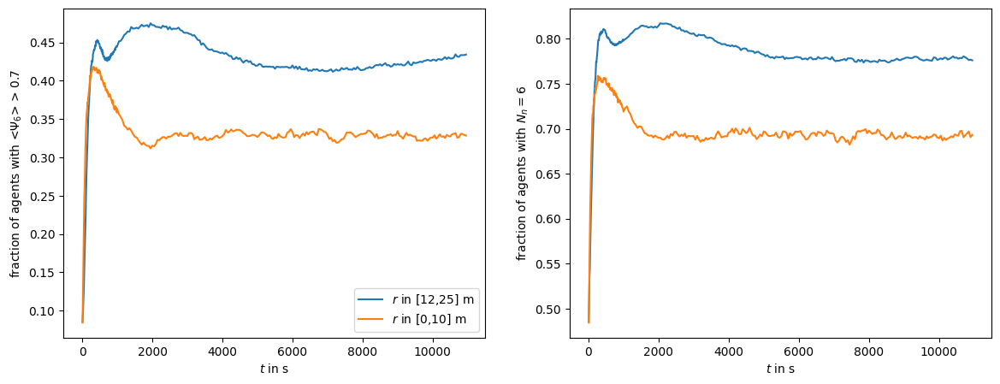

In [1342]:
plotpath = "texfiles/14_09_2021_consise_structure/Figures/TimeDensity"
os.system("mkdir " + plotpath)


fig, ax = plt.subplots(1,2,figsize=(14,5))
df_h_far = df_histo[(df_histo.r >= 12) & (df_histo.r < 25)]
df_h_close = df_histo[(df_histo.r <= 10)]
times = np.unique(df_h_far.t.to_numpy())

order_fraction = df_h_far.groupby('t').order_fraction.mean()
Nn_6 = df_h_far.groupby('t').Nn_6.mean()

order_fraction_close = df_h_close.groupby('t').order_fraction.mean()
Nn_6_close = df_h_close.groupby('t').Nn_6.mean()


ax[0].plot(times,order_fraction, label = "$r$ in [12,25] m")
ax[1].plot(times,Nn_6)

ax[0].plot(times,order_fraction_close, label = "$r$ in [0,10] m")
ax[1].plot(times,Nn_6_close)
ax[0].legend()
ax[0].set_xlabel('$t$ in s')
ax[1].set_xlabel('$t$ in s')

ax[0].set_ylabel('fraction of agents with <$\\Psi_6$> > 0.7')
ax[1].set_ylabel('fraction of agents with $N_n = 6$')
plt.savefig(plotpath + "/order_frac_Nn_6_timeseries.pdf")


0.1
0.2
0.3
0.4
0.5
0.6
0.7
0.8
0.9


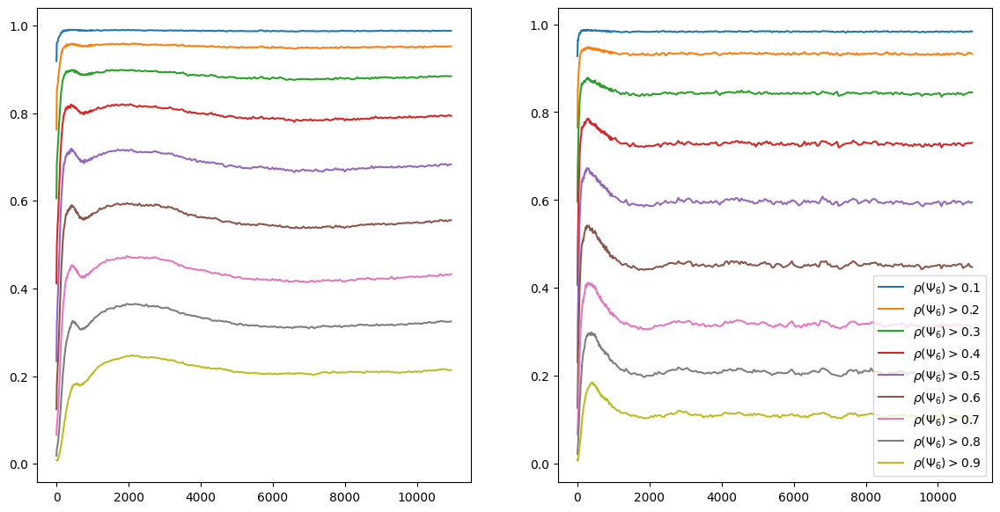

In [1344]:
df_new['exist'] = sf.listMaker(1,df_new.shape[0])
bf_thrashhold_list = [0.1,0.2,.3,0.4,0.5,0.6,0.7,0.8,0.9]

df_close = df_new.loc[df_new.r <= 10]
df_far = df_new.loc[(df_new.r >= 12) & (df_new.r <= 25)]
times= df_close.second.unique()
fig, ax = plt.subplots(1,2,figsize = (14, 7))

for th in bf_thrashhold_list:
    print(th)
    df_th_close = df_close[df_close.Bf >= th]
    df_th_far = df_far[df_far.Bf >= th]


    times = df_new.second.unique()
    density_close_array = df_th_close.groupby('second').exist.sum().to_numpy()/df_close.groupby('second').exist.sum().to_numpy()
    density_far_array = df_th_far.groupby('second').exist.sum().to_numpy()/df_far.groupby('second').exist.sum().to_numpy()
    ax[1].plot(times,density_close_array,label = "$\\rho(\\Psi_6) > $" + str(th))
    ax[0].plot(times,density_far_array)
ax[1].legend()

# Heatmap Radius and Time 

In [1366]:
df_histo = grouper(df_histo,'r','r_0',1)
df_histo_r = df_histo.groupby('r_0')
r_list = np.unique(df_histo.r_0.to_numpy())
r_shape = r_list.shape[0]
t_shape = time_list.shape[0] - 1
timeradius_array = np.empty([r_shape,t_shape])
dens_time_radius = np.empty([r_shape,t_shape])
speed_time_radius = np.empty([r_shape,t_shape])
order_fraction_time_radius = np.empty([r_shape,t_shape])
Nn_6_time_radius = np.empty([r_shape,t_shape])
for df_hr,i in zip(df_histo_r,range(r_shape)):
    r = df_hr[0]
    print(r)
    df_hr = df_hr[1]
    bf = df_hr.groupby('t').mean().Bf.to_numpy()
    timeradius_array[i,:] = bf
    dens_time_radius[i,:] = df_hr.groupby('t').mean().dens.to_numpy()/rho_max
    speed_time_radius[i,:] = df_hr.groupby('t').mean().speed_nn.to_numpy()
    order_fraction_time_radius[i,:] = df_hr.groupby('t').mean().order_fraction.to_numpy()
    Nn_6_time_radius[i,:] = df_hr.groupby('t').mean().Nn_6.to_numpy()
    #print(bf)
    #break


0.0
1.0
2.0
3.0
4.0
5.0
6.0
7.0
8.0
9.0
10.0
11.0
12.0
13.0
14.0
15.0
16.0
17.0
18.0
19.0
20.0
21.0
22.0
23.0


/Users/jonas/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:16: MatplotlibDeprecationWarning: The 'boundaries' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  app.launch_new_instance()
/Users/jonas/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:17: MatplotlibDeprecationWarning: The 'boundaries' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.


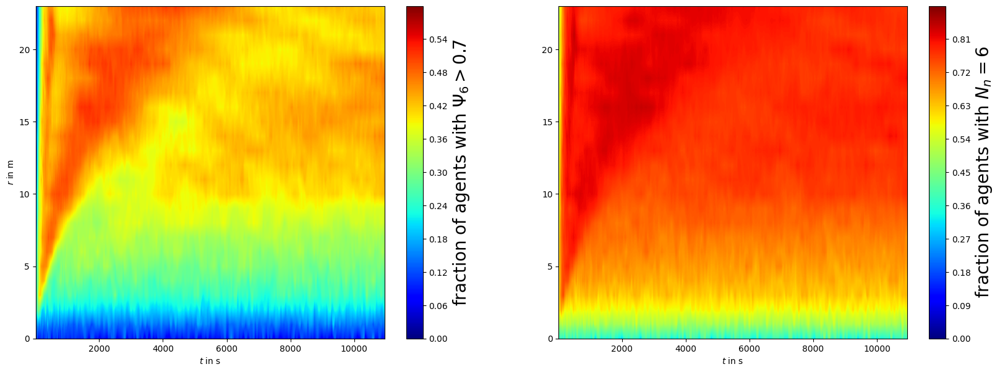

In [1367]:
plotpath = "texfiles/14_09_2021_consise_structure/Figures/TimeDensity"
os.system("mkdir " + plotpath)
levels_order = np.array(np.arange(0,0.6,0.001))
levels_dens = np.array(np.arange(0,0.9,0.001))
levels_speed = np.array(np.arange(-7.24,-0.64,0.01))

fig, ax = plt.subplots(1,2,figsize=(10 * 2,7))
order_frac = ax[0].contourf( time_list[1:], r_list,order_fraction_time_radius[:,:], cmap='jet',vmin = 0, vmax = 0.6,levels = levels_order)

Nn_6 = ax[1].contourf( time_list[1:], r_list,Nn_6_time_radius[:,:], cmap='jet',vmin = 0., vmax = 0.9,levels = levels_dens)
#ax[2].contourf( time_list[1:], r_list,np.log(speed_time_radius[:,:]), cmap='jet',vmin = np.log(speed_time_radius[:,:]).min(), vmax = np.log(speed_time_radius[:,:]).max(),levels = levels_speed)

ax[0].set_ylabel("$r$ in m")
[ax[j].set_xlabel("$t$ in s") for j in range(2)]

cbar = fig.colorbar(order_frac, ax=ax[0],boundaries = np.linspace(0,0.6,5), shrink=1.)
cbar1 = fig.colorbar(Nn_6, ax=ax[1], shrink=1.,boundaries = np.linspace(0,0.9,9))
cbar.set_label("fraction of agents with $\\Psi_6 > 0.7$",fontsize = 20)
cbar1.set_label("fraction of agents with $N_n = 6$",fontsize = 20)
plt.savefig(plotpath + "/timehead.png")
plt.show()

# Scatterplot at different times


In [93]:
df_new = sf.pedReducer(df,-5,5,0,7,50)


In [94]:
df

,Unnamed: 0,id,x,y,speed_nn,Nn,Dm,Bf,Nd,T,second,i,esigma,angle,r,dens
0,0,1,-3.550000,3.09,-1.0,6.0,0.017878,0.902878,0.296900,1.0,100.0,0.0,-0.2,-0.854565,4.706442,17.849275
1,1,2,-1.180000,5.01,-1.0,6.0,0.006034,0.944588,0.313730,1.0,100.0,0.0,-0.2,-0.231313,5.147087,14.709724
2,2,3,-0.740000,3.60,-1.0,6.0,0.024502,0.852366,0.264182,1.0,100.0,0.0,-0.2,-0.202732,3.675269,28.847722
3,3,4,1.380000,5.21,-1.0,6.0,0.002661,0.895415,0.326495,1.0,100.0,0.0,-0.2,0.258929,5.389666,12.904658
4,4,5,-1.440000,1.32,-1.0,6.0,0.018419,0.846990,0.233671,1.0,100.0,0.0,-0.2,-0.828849,1.953458,58.856222
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1095,1095,2000,22.979798,-0.10,0.0,3.0,9.624697,0.987545,7.289028,1.0,199.0,0.0,0.2,-1.566445,22.980016,0.008094
1096,1096,2000,23.484848,-0.10,0.0,3.0,9.640451,0.998505,7.370018,1.0,199.0,0.0,0.2,-1.566538,23.485061,0.007917
1097,1097,2000,23.989899,-0.10,0.0,3.0,9.656452,0.998945,7.454069,1.0,199.0,0.0,0.2,-1.566628,23.990107,0.007739
1098,1098,2000,24.494949,-0.10,0.0,3.0,9.672654,0.989523,7.541074,1.0,199.0,0.0,0.2,-1.566714,24.495154,0.007562


In [95]:
df_new.esigma.unique()

array([-0.2 , -0.15, -0.1 , -0.05, -0.  ,  0.05,  0.1 ,  0.15,  0.2 ])

-0.2
-0.15
-0.1
-0.05
-0.0
0.05
0.1
0.15
0.2


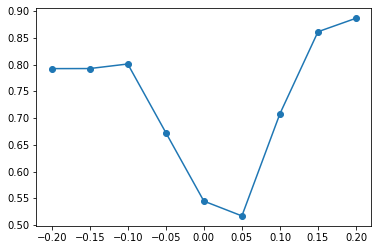

In [96]:
bf_list = []

for esig in df_new.esigma.unique():
    print(esig)
    df_esig = df_new[(df_new.esigma == esig) &(df_new.second > 100)]
    bf_list.append(df_esig.Bf.mean())
    
plt.plot(df_new.esigma.unique(),bf_list,marker = "o")

time =  199
strat plot
calculate voronoi
/calculate voronoi
plot voronoi
/plot voronoi
plot scatter
/plot scatter
finish plot
time =  199
strat plot
calculate voronoi
/calculate voronoi
plot voronoi
/plot voronoi
plot scatter
/plot scatter
finish plot
time =  199
strat plot
calculate voronoi
/calculate voronoi
plot voronoi
/plot voronoi
plot scatter
/plot scatter
finish plot
time =  199
strat plot
calculate voronoi
/calculate voronoi
plot voronoi
/plot voronoi
plot scatter
/plot scatter
finish plot
time =  199
strat plot
calculate voronoi
/calculate voronoi
plot voronoi
/plot voronoi
plot scatter
/plot scatter
finish plot
time =  199
strat plot
calculate voronoi
/calculate voronoi
plot voronoi
/plot voronoi
plot scatter
/plot scatter
finish plot
time =  199
strat plot
calculate voronoi
/calculate voronoi
plot voronoi
/plot voronoi
plot scatter
/plot scatter
finish plot
time =  199
strat plot
calculate voronoi
/calculate voronoi
plot voronoi
/plot voronoi
plot scatter
/plot scatter
fini

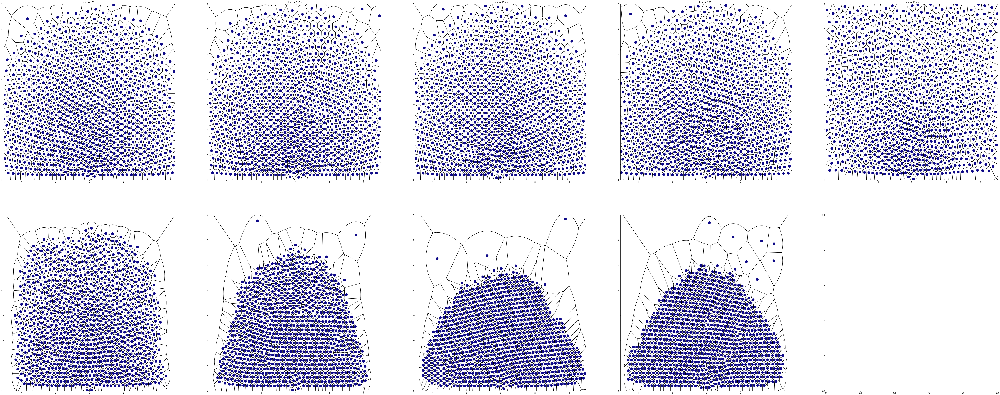

In [89]:
i = 0
df_i = df_new[df_new.i == i]
#id_list = df_dist[(df_dist.dist > 0.75) & (df_dist.i == i)].id
plotpath = "texfiles/14_09_2021_consise_structure/Figures/HexagonalOrderVornoi"
os.system("mkdir " + plotpath)
t = time_list[-1]
th = 0.88
fig, ax = plt.subplots(2,5,figsize = (5 * 10 * 2,10 * 20/20 * 2 * 2))
#for t,i in zip([100,300,7000],[0,1,2]):
for esig_total,j in zip([[-0.2,-0.15,-0.1,-0.05,0.0],[0.05,0.1,0.15,0.2]],[0,1]):
    for esig,i in zip(esig_total,[0,1,2,3,4,5]):
        print("time = ", t)
        df_t = df_i[(df_i.second == 199) & (df_i.esigma == esig)]
        #df_6 = df_t[df_t.Nn == 6]
        df_57 = df_t[df_t.Nn != 6]
        #df_id = df_t[df_t.id.isin(id_list)]
        print("strat plot")
        x = df_t.x.to_numpy()
        y = df_t.y.to_numpy()
        x_min = x.min()
        x_max = x.max()
        y_min = y.min()
        y_max = y.max()
        print("calculate voronoi")

        room = [x_min - 0.3, x_max + 0.3, y_min - 0.3, y_max + 0.3]
        pointframe = addPedFrame([x_min - 0.5, x_max + 0.5, y_min - 0.5, y_max + 0.5])
        lat = np.vstack((x,y)).T
        lat = np.vstack([lat,pointframe])
        vor = Voronoi(lat,qhull_options='Qbb Qc Qx')
        print("/calculate voronoi")

        print("plot voronoi")
        #for k in range(3):
        VoronoiRidges(vor,ax[j,i])

        print("/plot voronoi")

        cmapplasma = cm.get_cmap('plasma')
        cmapjet = cm.get_cmap('jet')
        cmapjet_r = cm.get_cmap('jet_r')
        print("plot scatter")
        order= ax[j,i].scatter(df_t.x,df_t.y,c=df_t.Bf, vmin=0., vmax=1., cmap = cmapplasma,alpha = 1., s = 200)
        #dens = ax[1,i].scatter(df_t.x,df_t.y,c=df_t.dens, cmap = cmapjet,alpha = 1.,s = 100)
        #speed = ax[2,i].scatter(df_t.x,df_t.y,color = "grey",s = 100)
        #df_t = df_t[df_t.Nn!=6]
        #speed = ax[2,i].scatter(df_t.x,df_t.y,c= df_t.Nn.to_numpy(),vmin = 4, vmax = 8, cmap = cm.get_cmap('PiYG', 5),alpha = 1.,s = 100)
        print("/plot scatter")

        #for k in range(3):
        ax[j,i].set_xlim([-5,5])
        ax[j,i].set_ylim([0,7])

        ax[0,i].set_title("time = " + str(t) + " s")

        print("finish plot")
    """cbar = fig.colorbar(dens, ax=ax[1,:], shrink=0.6)
    cbar1 = fig.colorbar(order, ax=ax[0,:], shrink=0.6)
    cbar2 = fig.colorbar(speed, ax=ax[2,:], shrink=0.6)
    cbar.set_label("$\\rho_n$",fontsize = 20)
    cbar1.set_label("$\\psi_6$",fontsize = 20)
    cbar2.set_label("$v$ in m/s",fontsize = 20)
    cbar.ax.tick_params(labelsize=20)
    cbar1.ax.tick_params(labelsize=20)
    cbar2.ax.tick_params(labelsize=20)"""
    #fig.savefig(plotpath + "/" + str(t) + ".png")
    #plt.close()
plt.show()


time =  990
time =  990
time =  990
time =  990
time =  990
time =  990
time =  990
time =  990
time =  990
time =  990


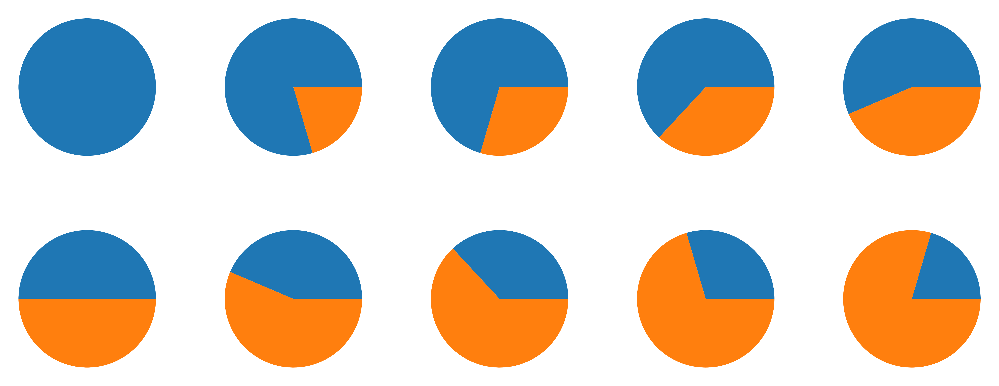

In [54]:
fig, ax = plt.subplots(2,5,figsize = (5 * 10 * 2,10 * 20/20 * 2 * 2))


for esig_total,j in zip([[-1,-0.8,-0.6,-0.4,-0.2],[0,0.2,0.4,0.6,0.8]],[0,1]):
    for esig,i in zip(esig_total,[0,1,2,3,4,5]):
        print("time = ", t)
        
        sizes = [np.arccos(esig)/np.pi,1 - np.arccos(esig)/np.pi]

#ax.quiver([0],[0],[0],[-1])

        ax[j,i].pie(sizes)
plt.show()

time =  100
strat plot
calculate voronoi
/calculate voronoi
plot voronoi
/plot voronoi
plot scatter
/plot scatter
finish plot
time =  8000
strat plot
calculate voronoi
/calculate voronoi
plot voronoi
/plot voronoi
plot scatter
/plot scatter
finish plot


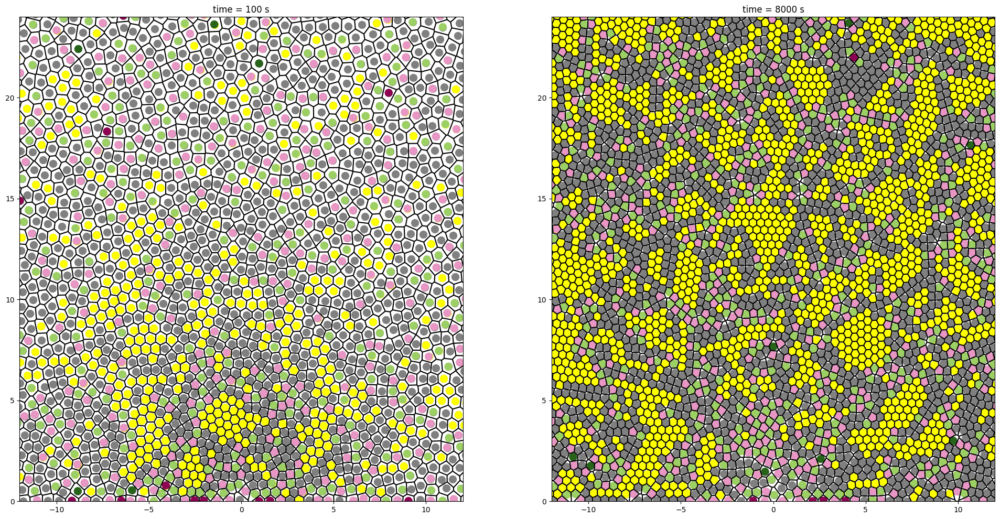

In [1276]:
i = 23
df_i = df_new[df_new.i == i]
#id_list = df_dist[(df_dist.dist > 0.75) & (df_dist.i == i)].id
plotpath = "texfiles/14_09_2021_consise_structure/Figures/HexagonalOrderVornoi"
os.system("mkdir " + plotpath)
t = time_list[-1]
th = 0.88
fig, ax = plt.subplots(1,2,figsize = (2 * 6 * 2,6 * 20/20 * 1 * 2))
for t,i in zip([100,8000],[0,1]):
    print("time = ", t)
    df_t = df_i[df_i.second == t]
    #df_6 = df_t[df_t.Nn == 6]
    df_57 = df_t[df_t.Nn != 6]
    #df_id = df_t[df_t.id.isin(id_list)]
    print("strat plot")
    x = df_t.x.to_numpy()
    y = df_t.y.to_numpy()
    x_min = x.min()
    x_max = x.max()
    y_min = y.min()
    y_max = y.max()
    print("calculate voronoi")

    room = [x_min - 0.3, x_max + 0.3, y_min - 0.3, y_max + 0.3]
    pointframe = addPedFrame([x_min - 0.5, x_max + 0.5, y_min - 0.5, y_max + 0.5])
    lat = np.vstack((x,y)).T
    lat = np.vstack([lat,pointframe])
    vor = Voronoi(lat,qhull_options='Qbb Qc Qx')
    print("/calculate voronoi")

    print("plot voronoi")
    VoronoiRidges(vor,ax[i])
    
    print("/plot voronoi")

    cmapplasma = cm.get_cmap('plasma')
    cmapjet = cm.get_cmap('jet')
    cmapjet_r = cm.get_cmap('jet_r')
    print("plot scatter")
    ax[i].scatter(df_t.x,df_t.y, color = "grey",alpha = 1., s = 100)
    df_t = df_t[df_t.Bf > 0.7]
    ax[i].scatter(df_t.x,df_t.y,color = "yellow",alpha = 1., s = 100)
    ax[i].scatter(df_57.x,df_57.y,c=df_57.Nn, vmin=4., vmax=8, cmap = cm.get_cmap('PiYG', 5),alpha = 1.,s = 100)
    
    print("/plot scatter")

    ax[i].set_xlim([-12,12])
    ax[i].set_ylim([0,24])

    ax[i].set_title("time = " + str(t) + " s")
    
    print("finish plot")
"""cbar = fig.colorbar(dens, ax=ax[1,:], shrink=0.6)
cbar1 = fig.colorbar(order, ax=ax[0,:], shrink=0.6)
cbar2 = fig.colorbar(speed, ax=ax[2,:], shrink=0.6)
cbar.set_label("$\\rho_n$",fontsize = 20)
cbar1.set_label("$\\psi_6$",fontsize = 20)
cbar2.set_label("$v$ in m/s",fontsize = 20)
cbar.ax.tick_params(labelsize=20)
cbar1.ax.tick_params(labelsize=20)
cbar2.ax.tick_params(labelsize=20)"""
fig.savefig(plotpath + "/order_filter_07_defect.png")
#plt.close()
plt.show()


strat plot
calculate voronoi
/calculate voronoi
plot voronoi


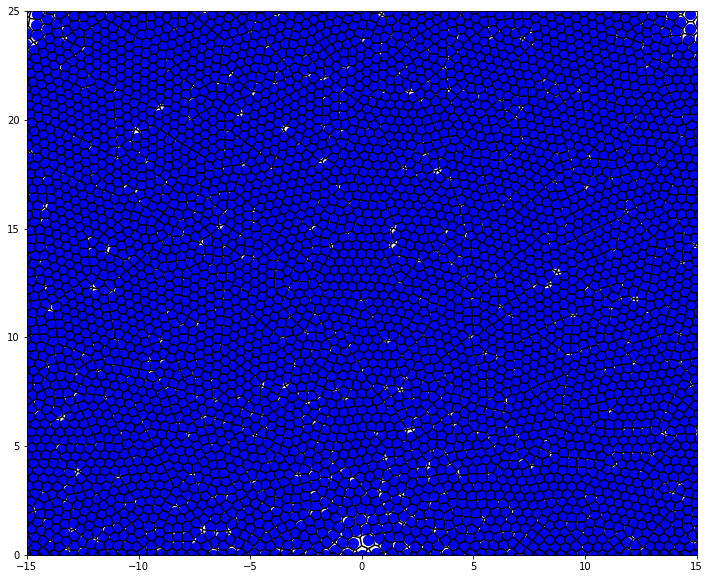

calculate voronoi
/calculate voronoi
plot voronoi


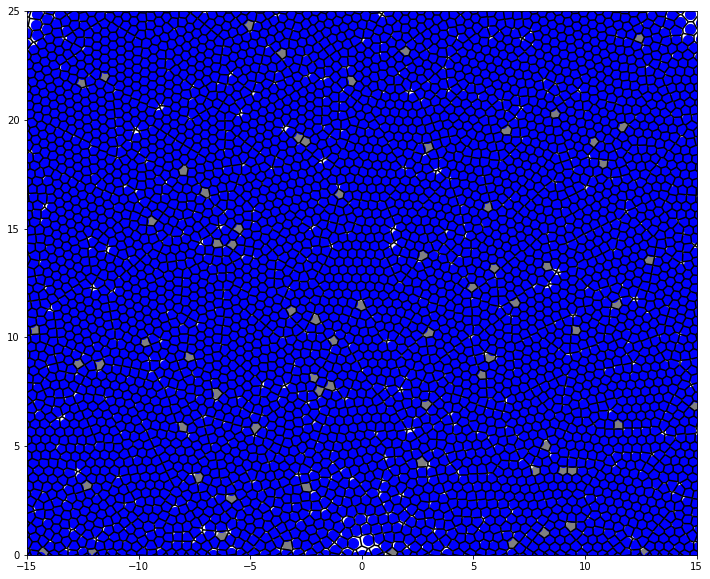

calculate voronoi
/calculate voronoi
plot voronoi


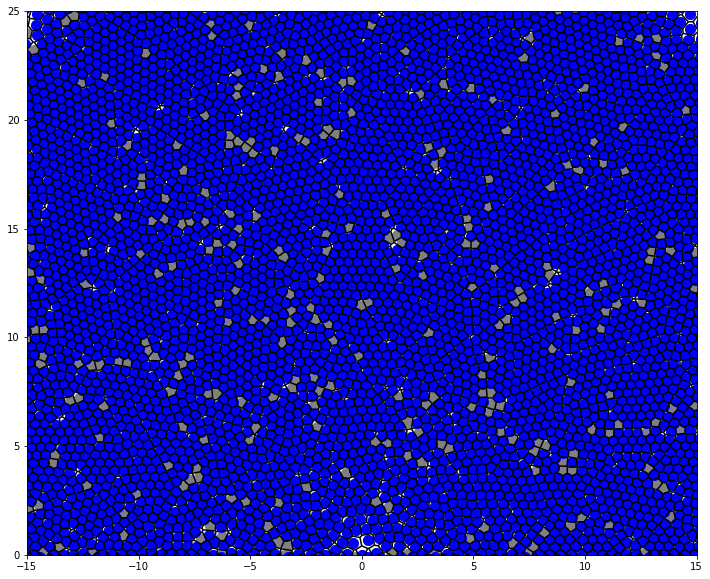

calculate voronoi
/calculate voronoi
plot voronoi


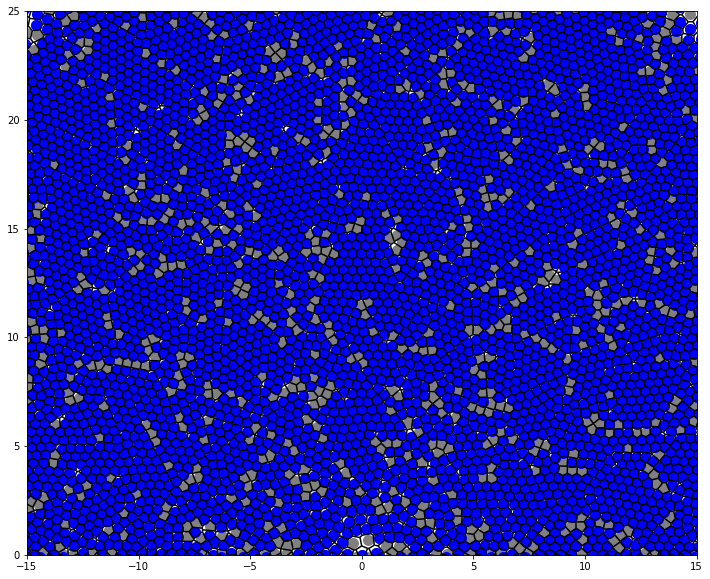

calculate voronoi
/calculate voronoi
plot voronoi


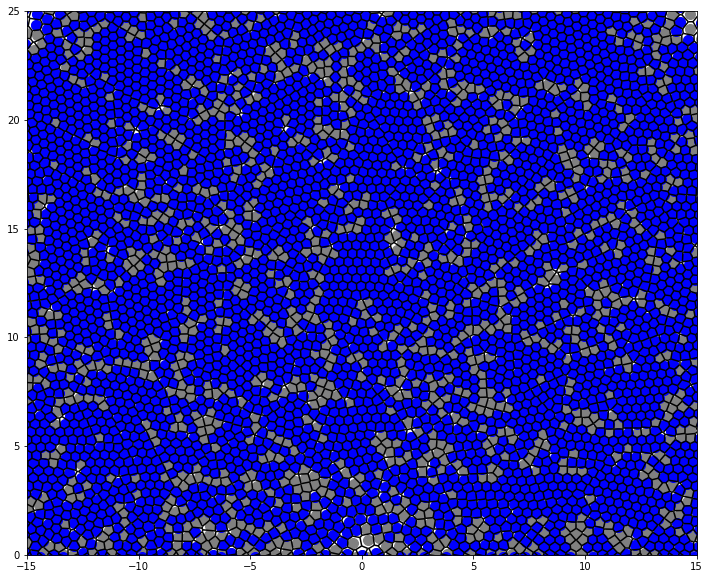

calculate voronoi
/calculate voronoi
plot voronoi


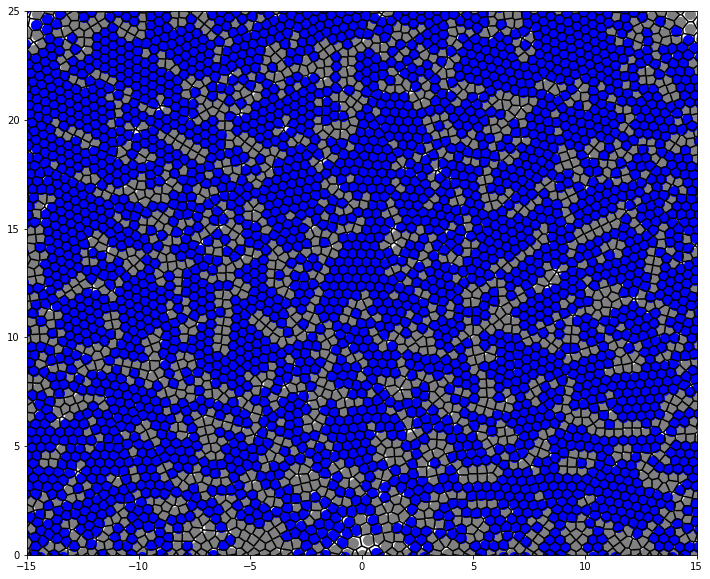

calculate voronoi
/calculate voronoi
plot voronoi


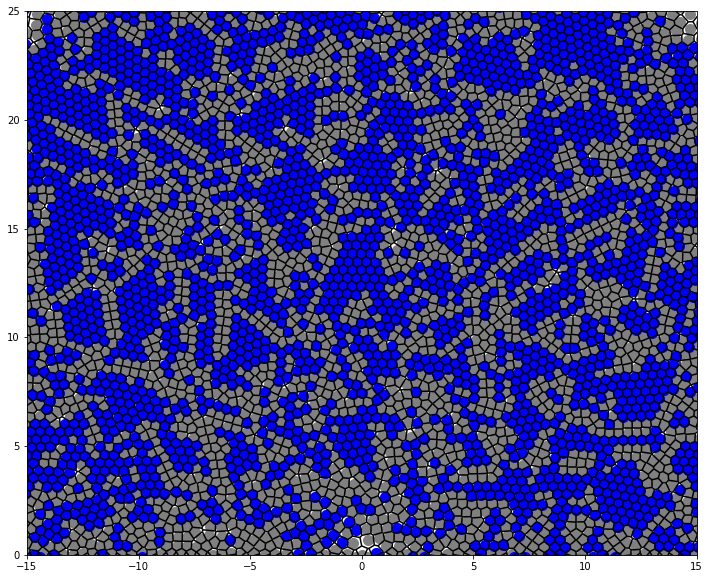

calculate voronoi
/calculate voronoi
plot voronoi


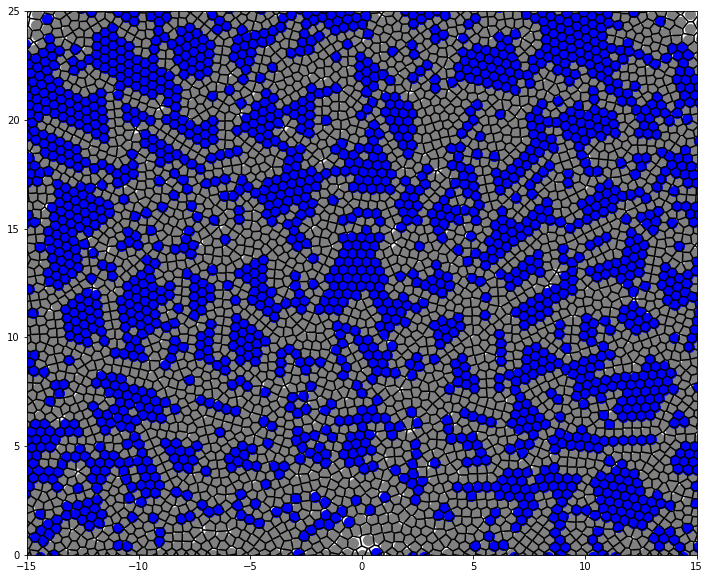

calculate voronoi
/calculate voronoi
plot voronoi


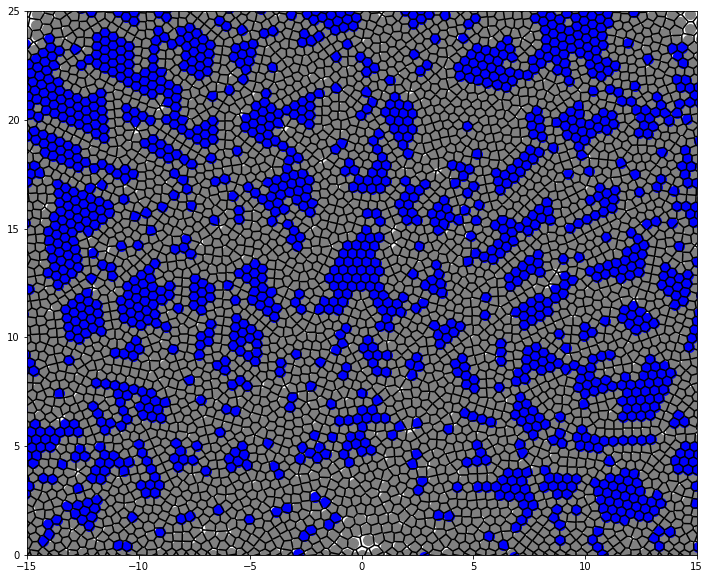

calculate voronoi
/calculate voronoi
plot voronoi


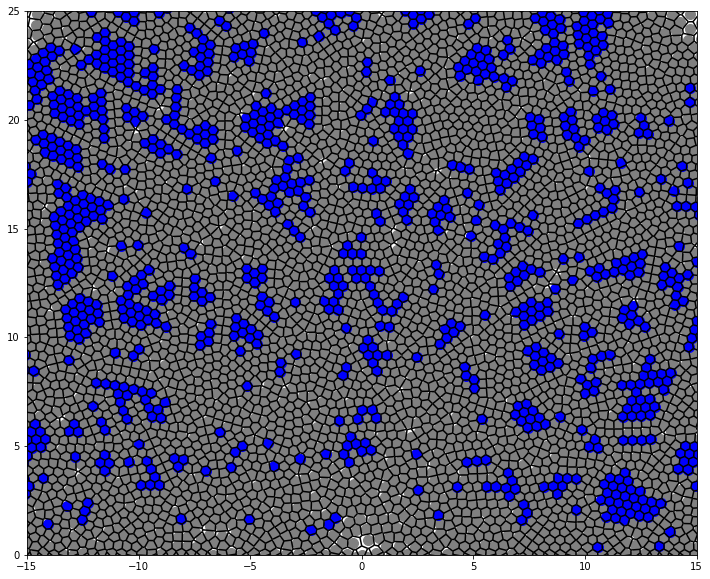

In [251]:
i = 23
print("strat plot")
plotpath = "texfiles/16_09_2021_videos/orientation_order_threshold_filter_no_defect" 
os.system("mkdir " + plotpath)
df_i = df[(df.i == i) & (df.second == 9000) &(abs(df.x) <= 16) & (df.y < 26)]
df_57 = df_i[(df_i.Nn != 6)]
for th,i in zip([0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9],range(10)):
    fig, ax = plt.subplots(1,1,figsize = (2 * 6 ,6 * 25/30 * 1 * 2))

    


    x = df_i.x.to_numpy()
    y = df_i.y.to_numpy()
    x_min = x.min()
    x_max = x.max()
    y_min = y.min()
    y_max = y.max()
    print("calculate voronoi")

    room = [x_min - 0.3, x_max + 0.3, y_min - 0.3, y_max + 0.3]
    pointframe = addPedFrame([x_min - 0.5, x_max + 0.5, y_min - 0.5, y_max + 0.5])
    lat = np.vstack((x,y)).T
    lat = np.vstack([lat,pointframe])
    vor = Voronoi(lat,qhull_options='Qbb Qc Qx')
    print("/calculate voronoi")

    print("plot voronoi")
    VoronoiRidges(vor,ax)

    ax.scatter(df_i.x,df_i.y, color = "grey",alpha = 1., s = 100)
    df_th = df_i[df_i.Bf >= th]
    ax.scatter(df_th.x,df_th.y,color = "blue",alpha = 1., s = 100)
    #ax.scatter(df_57.x,df_57.y,c = df_57.Nn, cmap = cm.get_cmap('PiYG', 5) , vmin = 4,vmax = 8,alpha = 1., s = 100)
    ax.set_ylim([0,25])
    ax.set_xlim([-15,15])
    fig.savefig(plotpath + "/" + imgName(i) + ".png")
        #fig.savefig(plotpath + "/" + af.b_data_name(esig,3) + ".png")
    #plt.close()

    plt.show()

# Plots for Videos 

texfiles/16_09_2021_videos/exponential_repulsion_larger0_0
\sigma^2 =  0.0
None
[  0 100 200 300 400 500 600 700 800 900]
(5100, 16) 0.0


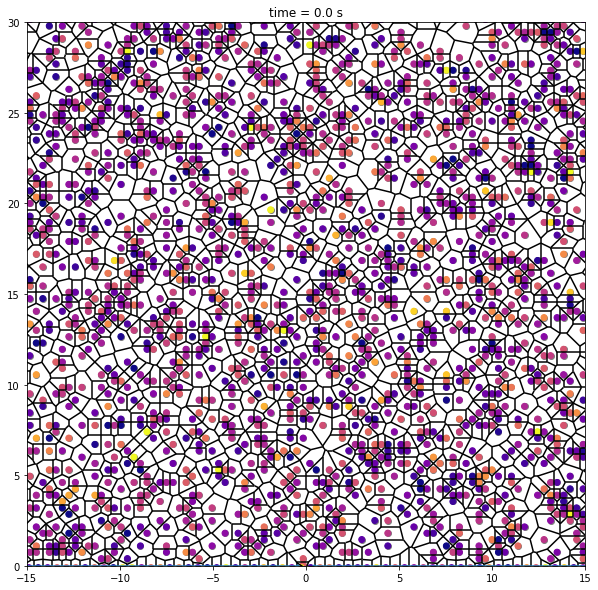

(5078, 16) 100.0


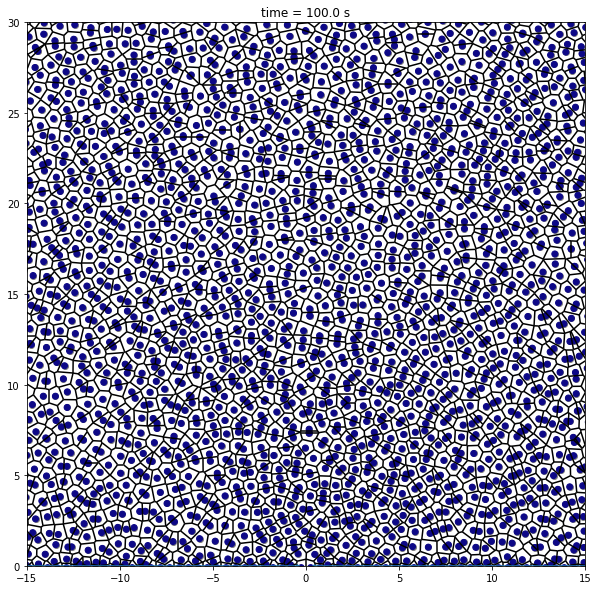

(5064, 16) 200.0


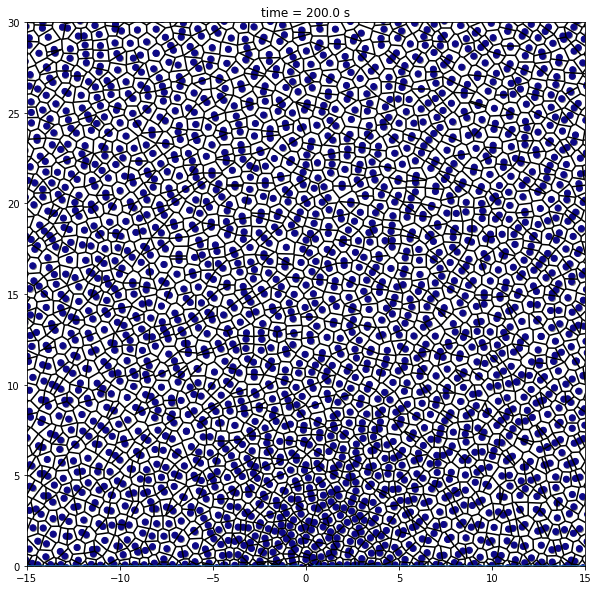

(5032, 16) 300.0


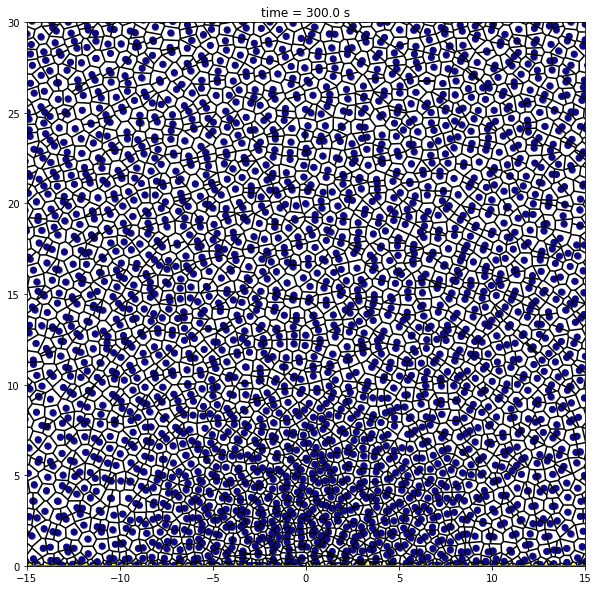

(4981, 16) 400.0


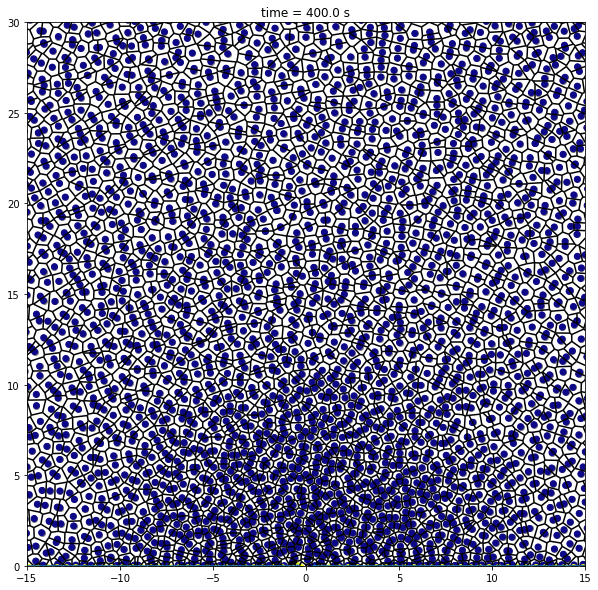

(4921, 16) 500.0


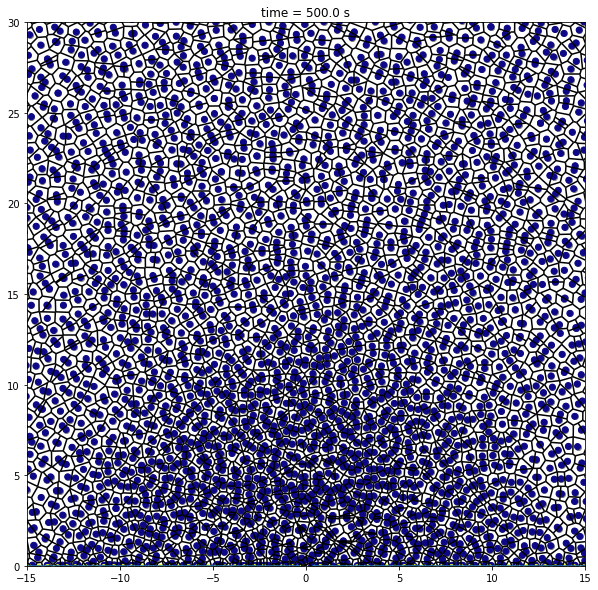

(4850, 16) 600.0


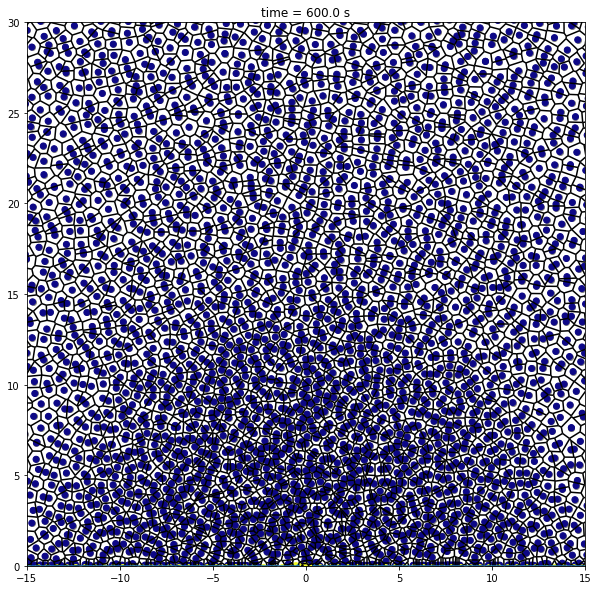

(4778, 16) 700.0


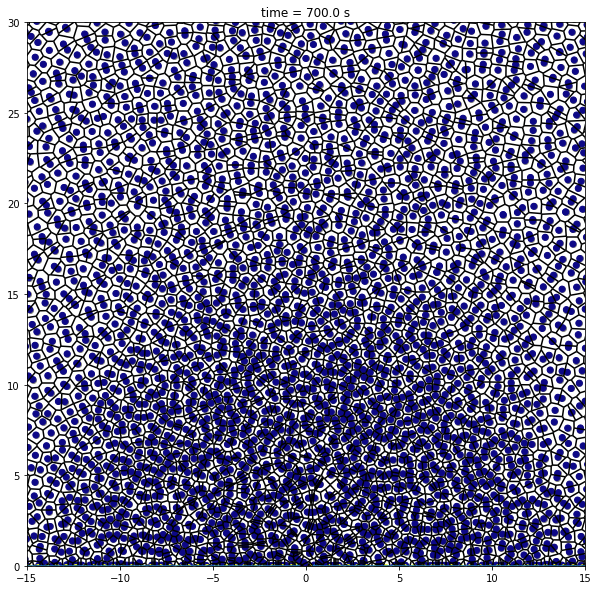

(4699, 16) 800.0


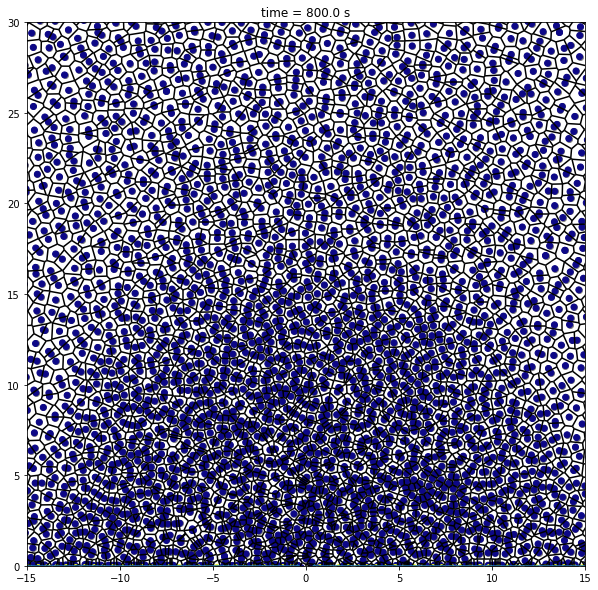

(4615, 16) 900.0


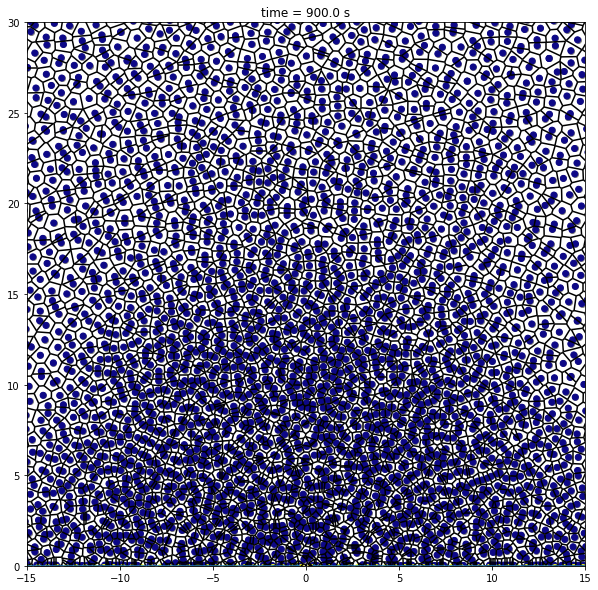

In [13]:
i = 0
df_i = df[df.i == i]
#id_list = df_dist[(df_dist.dist > 0.75) & (df_dist.i == i)].id

t = time_list[-1]
th = 0.88
#[10,50,100,400,1400]
#time_list = time_list[time_list > 2000]
#fig, axis = plt.subplots(2,4,figsize=(5 * 4 ,5 * 2))
for esig in np.unique(df_i.esigma.to_numpy()):
    plotpath = "texfiles/16_09_2021_videos/exponential_repulsion_larger" + af.b_data_name(esig,3) 
    os.system("mkdir " + plotpath)
    
    print(plotpath)

    df_esig = df_i[df_i.esigma == esig]
    print(print("\sigma^2 = ", esig))
    print(time_list)
    for t,i in zip(np.unique(df_esig.second.to_numpy()),range(np.array(time_list).shape[0])):
        df_t = df_esig[df_esig.second == t]
        df_57 = df_t[df_t.Nn != 6]
        print(df_t.shape,t)
        #df_6 = df_t[df_t.Nn == 6]
        #df_57 = df_t[df_t.Nn != 6]
        #df_id = df_t[df_t.id.isin(id_list)]

        x = df_t.x.to_numpy()
        y = df_t.y.to_numpy()
        x_min = x.min()
        x_max = x.max()
        y_min = y.min()
        y_max = y.max()

        room = [x_min - 0.3, x_max + 0.3, y_min - 0.3, y_max + 0.3]
        pointframe = addPedFrame([x_min - 0.5, x_max + 0.5, y_min - 0.5, y_max + 0.5])
        lat = np.vstack((x,y)).T
        lat = np.vstack([lat,pointframe])
        vor = Voronoi(lat,qhull_options='Qbb Qc Qx')
        fig, ax = plt.subplots(1,figsize = (10 * 1., 10 * 10/10))

        VoronoiRidges(vor,ax)
        b
        cmap = cm.get_cmap('plasma')
        shapescatter = ax.scatter(df_t.x,df_t.y,color = "grey")
        #df_t = df_t[df_t.Bf >= 0.8]
        shapescatter = ax.scatter(df_t.x,df_t.y,c=df_t.Bf, vmin=0, vmax=1, cmap = cmap,alpha = 1.)
        #shapescatter = ax.scatter(df_t.x,df_t.y,c=df_t.ShapeFactor, vmin=1.05, vmax=1.3, cmap = cmap,alpha = 1.)
        #sc = ax.scatter(df_t.x,df_t.y,color="grey")

        #sc = ax.scatter(df_57.x,df_57.y,c=df_57.Nn, vmin=3., vmax=9., cmap = cm.get_cmap('PiYG', 5),alpha = 1.)

        ax.set_xlim([-15,15])
        add_wall(2.5,50,ax)  
        ax.set_ylim([0,30])
        ax.set_title("time = " + str(t) + " s")

        #fig.colorbar(sc, ticks = [4,5,6,7,8], label = "Coordination Number")
        #fig.colorbar(shapescatter, label = "$\\zeta$")

        fig.savefig(plotpath + "/" + imgName(i) + ".png")
        #fig.savefig(plotpath + "/" + af.b_data_name(esig,3) + ".png")
        #plt.close()
        plt.show()
        #break

# Radius mean plots

/Users/jonas/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()
/Users/jonas/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()
/Users/jonas/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a

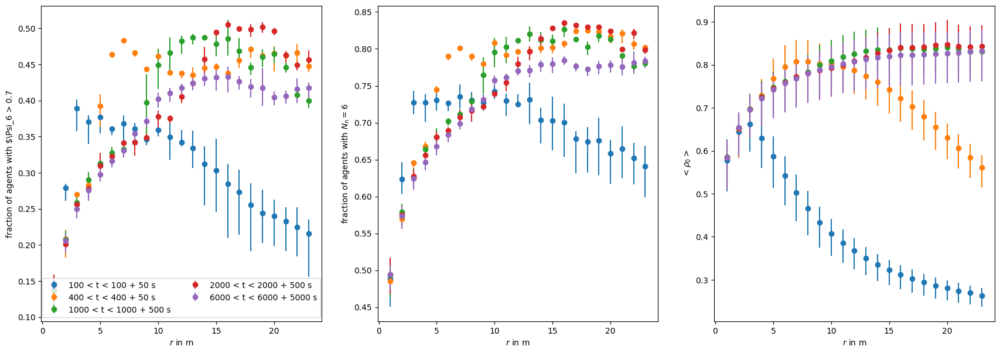

In [1368]:
fig, ax = plt.subplots(1,3,figsize = (21,7))
plotpath = "texfiles/14_09_2021_consise_structure/Figures/"
for t ,dt in zip([100,400,1000,2000,6000],[50,50,500,500,5000]):
    df_t = df_histo[(df_histo.t >= t) & (df_histo.t <= t + dt) ]
    groupPlot(df_t ,'r','order_fraction',ax[0],1,True,label = str(t) + " < t < " + str(t) + " + " + str(dt) + " s")

    groupPlot(df_t ,'r','Nn_6',ax[1],1,True)
    groupPlot(df_t ,'r','dens',ax[2],1,True)

for i in range(3):
    ax[i].set_xlabel('$r$ in m')
ax[0].set_ylabel('fraction of agents with $\\Psi_6 > 0.7')
ax[1].set_ylabel('fraction of agents with $N_n =6$')
ax[2].set_ylabel('$<\\rho_0>$')
ax[0].legend(ncol = 2, loc = 'lower center')
plt.savefig(plotpath + "radius_mean_plot.pdf")

# Shape factor distribution

In [1260]:
df_new = sf.pedReducer(df,-15,15,0,30,50)

/Users/jonas/opt/anaconda3/lib/python3.7/site-packages/pandas/core/generic.py:5208: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value
/Users/jonas/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:108: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.


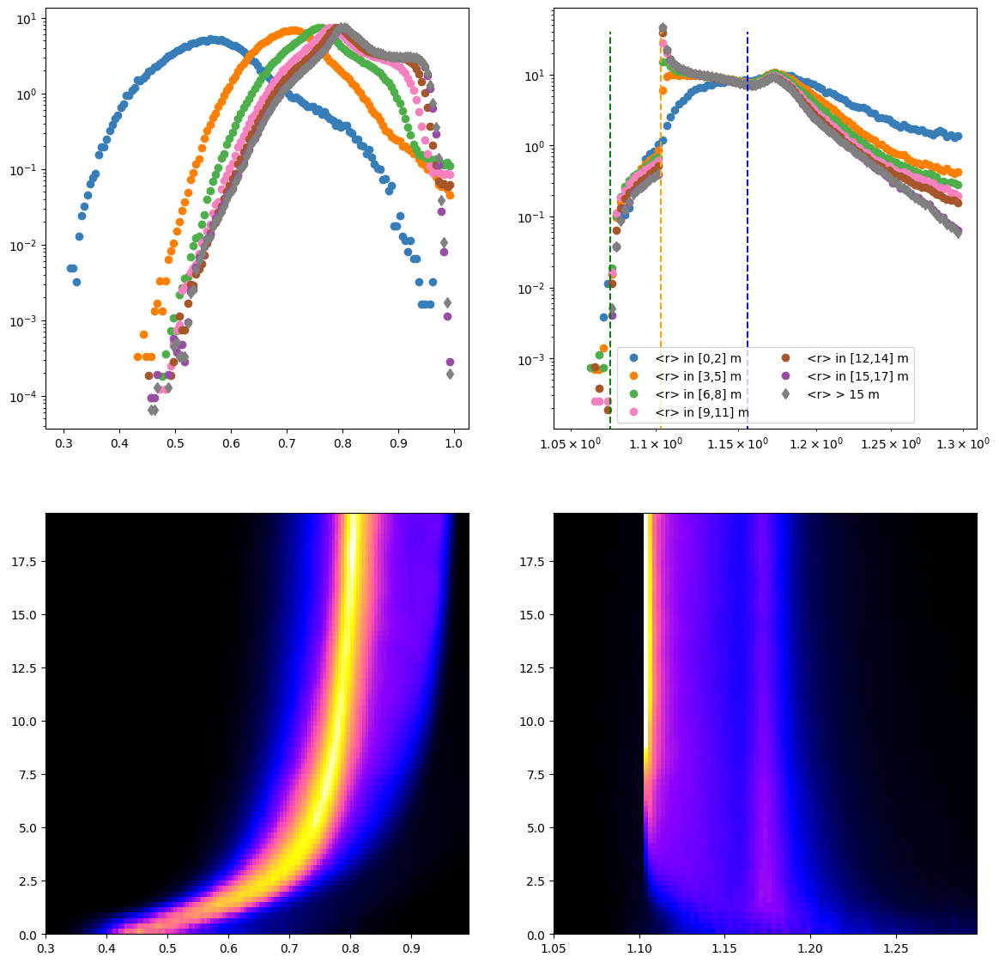

In [1262]:
plotpath = "texfiles/14_09_2021_consise_structure/Figures"
os.system("mkdir " + plotpath)
#print(df_new.second.max())
from scipy.stats import skewnorm

CB_color_cycle = ['#377eb8', '#ff7f00', '#4daf4a',
                  '#f781bf', '#a65628', '#984ea3',
                  '#999999', '#e41a1c', '#dede00']
r_list = np.arange(0,17,3)


bins_bf = np.arange(0.,1.,0.005)
bins_dens = np.arange(0.3,1.,0.005)
bins_shape = np.arange(1.05,1.3,0.0025)
r_array = np.arange(0,20,0.25)
for esig in [3]:
    fig, ax = plt.subplots(2,2,figsize = (7 * 2, 7 * 2 ))

    df_t = df_new[df_new.esigma == esig]
    for t in [4000]:
        df_t = df_new[df_new['second'] > t]

        df_t.dens = df_t.dens/rho_max

        #groupPlot(df_t,'r','dens',ax[0,1],0.25,True)
        #groupPlot(df_t,'r','Bf',ax[0,0],0.25,True)

        for r,color in zip(r_list,CB_color_cycle):
            df_t_r = df_t[(df_t.r > r) & (df_t.r < r + 2) ]
            #HistoPlot(df_t_r.Bf, bins_bf, ax[0,1], color, "o","<r> in ["+ str(r) + ","+ str(r + 2) + "]"  + " m")
            HistoPlot(df_t_r.dens, bins_dens, ax[0,0], color, "o", "<r> in ["+ str(r) + ","+ str(r + 2) + "]"  + " m")
            HistoPlot(df_t_r.ShapeFactor, bins_shape, ax[0,1], color, "o","<r> in ["+ str(r) + ","+ str(r + 2) + "]"  + " m")

        df_t_r = df_t[(df_t.r > 15) & ((df_t.r < 18))]
        HistoPlot(df_t_r.dens ,bins_dens, ax[0,0], "grey", "d", "<r> > 15 m")
        #HistoPlot(df_t_r.Bf,bins_bf,ax[0,1], "grey", "d","<r> > 15 m")
        HistoPlot(df_t_r.ShapeFactor, bins_shape, ax[0,1], "grey", "d","<r> > 15 m")
        ax[0,1].legend(loc = "lower center",ncol = 2)

        #ax[0,2].set_yscale('log')    
        ax[0,1].set_yscale('log')
        ax[0,1].set_xscale('log')
        ax[0,0].set_yscale('log')
        #plt.legend()
        ax[0,1].plot([1.103,1.103],[0.0,40],c = "orange",linestyle = "--")
        ax[0,1].plot([1.156,1.156],[0.0,40],c = "blue",linestyle = "--")
        ax[0,1].plot([1.073,1.073],[0.0,40],c = "green",linestyle = "--")

        PlotHistogramHeatMap(df_t,"dens",'r',1,bins_dens,r_array,ax[1,0],"gnuplot2",1)
        #PlotHistogramHeatMap(df_t,"Bf",'r',1,bins_bf,r_array,ax[1,1],"gnuplot2",2)
        PlotHistogramHeatMap(df_t,"ShapeFactor",'r',1,bins_shape,r_array,ax[1,1],"gnuplot2",2)
    #ax[1,1].set_xscale('log')
    plt.savefig(plotpath +"/shape_factor_distribution.pdf")
    plt.show()

# Field calculation

In [9]:
x_min = -25
x_max = 25
y_min = 0
y_max = 35
sig = 3
second = 11000
t2 = 8000
x_array = np.linspace(x_min,x_max,int(360))
y_array = np.linspace(y_min,y_max,int(260))

dx = (x_max - x_min)/360
dy = (y_max - y_min)/260

In [981]:
fwhm = 0.22
rho_max = 7.2
os.system("mkdir texfiles/field_N_ped_8000_Esigma_3")
os.system("mkdir " + "texfiles/" + "field_N_ped_8000_Esigma_3/fieldtemp_large")
os.system("mkdir " + "texfiles/" + "field_N_ped_8000_Esigma_3/fieldtemp_large/order")
os.system("mkdir " + "texfiles/" + "field_N_ped_8000_Esigma_3/fieldtemp_large/densnorm")
os.system("mkdir " + "texfiles/" + "field_N_ped_8000_Esigma_3/fieldtemp_large/dens")
def orderDensMatrix(df_t,i,a):
    print("calc " + str(i+1 + ti * ranger) + "/" + str(ranger * len(times)))
    df_ti = df_t[df_t.i == i]
    x_dens,y_dens = xdensYdens(df_ti['x'].to_numpy(),df_ti['y'].to_numpy(),x_array,y_array)
    dens_matrix = densityField(x_dens, y_dens, a)
    order_matrix = orderField(x_dens,y_dens,df_ti['Bf'].to_numpy(),a) / dens_matrix
    dist_matrix = orderField(x_dens,y_dens,df_ti['dens'].to_numpy()/rho_max,a) / dens_matrix
    speed_matrix = orderField(x_dens,y_dens,df_ti['speed_nn'].to_numpy(),a) / dens_matrix
    
    return order_matrix, dist_matrix, dens_matrix, speed_matrix
a = widthOfGaußian(fwhm)
ranger = int(np.unique(df_new.i.to_numpy()).max())
#ranger = [1]
#times = np.arange(50,1000,50)
times = np.arange(100,11000,100)
#times = [7000]
for second,ti in zip(times,range(len(times))):
    print(second)
    order_matrix1 = []
    dens_matrix1 = []
    dist_matrix1 = []
    speed_matrix1 = []
    if os.path.isfile(path + "plots/fieldtemp_large/speed" + str(second) + ".npy"):
        print("file exists")
        #continue
    print(second)
    df_t = df[df["second"] == second]
    
    """for i in range(ranger):
        print("calc " + str(i+1 + ti * ranger) + "/" + str(ranger * len(time_list)))"""
    print("start Pool")

    pool = Pool()
    print("GPool")

    g_pool = np.array(
        [pool.apply_async(orderDensMatrix, args = (df_t,i,a)) for i in range(ranger)])
    tensor_list = np.array([p.get() for p in g_pool])
    print("PoolClose")

    pool.close() 
    order_matrix1.append(np.array([tensor[0] for tensor in tensor_list]))
    dist_matrix1.append(np.array([tensor[1] for tensor in tensor_list]))
    dens_matrix1.append(np.array([tensor[2] for tensor in tensor_list]))
    speed_matrix1.append(np.array([tensor[3] for tensor in tensor_list]))
    np.save("texfiles/" + "field_N_ped_8000_Esigma_3/fieldtemp_large/order" + str(second) + ".npy" , np.array(order_matrix1))
    np.save("texfiles/" + "field_N_ped_8000_Esigma_3/fieldtemp_large/densnorm" + str(second) + ".npy" , np.array(dist_matrix1))
    np.save("texfiles/" + "field_N_ped_8000_Esigma_3/fieldtemp_large/dens" + str(second) + ".npy" , np.array(dens_matrix1))
    np.save("texfiles/" + "field_N_ped_8000_Esigma_3/fieldtemp_large/speed" + str(second) + ".npy" , np.array(speed_matrix1))

100
100
start Pool
GPool
calc 1/3161
calc 2/3161
calc 3/3161
calc 4/3161
calc 5/3161
calc 6/3161
calc 7/3161
calc 8/3161
calc 9/3161
calc 10/3161
calc 11/3161
calc 12/3161
calc 13/3161
calc 14/3161
calc 15/3161
calc 16/3161


Process ForkPoolWorker-3758:
Process ForkPoolWorker-3752:
Process ForkPoolWorker-3747:
Process ForkPoolWorker-3751:
Process ForkPoolWorker-3745:
Process ForkPoolWorker-3748:
Process ForkPoolWorker-3757:
Process ForkPoolWorker-3750:
Process ForkPoolWorker-3760:
Process ForkPoolWorker-3749:
Process ForkPoolWorker-3755:
Process ForkPoolWorker-3754:
Process ForkPoolWorker-3756:
Process ForkPoolWorker-3753:
Process ForkPoolWorker-3759:
Process ForkPoolWorker-3746:
Traceback (most recent call last):


KeyboardInterrupt: 

Traceback (most recent call last):
  File "/Users/jonas/opt/anaconda3/lib/python3.7/multiprocessing/process.py", line 297, in _bootstrap
    self.run()
  File "/Users/jonas/opt/anaconda3/lib/python3.7/multiprocessing/process.py", line 297, in _bootstrap
    self.run()
  File "/Users/jonas/opt/anaconda3/lib/python3.7/multiprocessing/process.py", line 99, in run
    self._target(*self._args, **self._kwargs)
Traceback (most recent call last):
  File "/Users/jonas/opt/anaconda3/lib/python3.7/multiprocessing/process.py", line 99, in run
    self._target(*self._args, **self._kwargs)
  File "/Users/jonas/opt/anaconda3/lib/python3.7/multiprocessing/pool.py", line 121, in worker
    result = (True, func(*args, **kwds))
Traceback (most recent call last):
  File "/Users/jonas/opt/anaconda3/lib/python3.7/multiprocessing/process.py", line 297, in _bootstrap
    self.run()
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent 

  File "/Users/jonas/opt/anaconda3/lib/python3.7/multiprocessing/pool.py", line 121, in worker
    result = (True, func(*args, **kwds))
  File "<ipython-input-981-81b1ac36a3e3>", line 12, in orderDensMatrix
    dens_matrix = densityField(x_dens, y_dens, a)
  File "<ipython-input-3-c2be6611fc99>", line 5, in <lambda>
    return np.array(list(map(lambda x: 1 / (m.sqrt(m.pi) * a) * m.e ** (-x ** 2 / a ** 2), delta_x)))
  File "<ipython-input-3-c2be6611fc99>", line 19, in <listcomp>
    rho_matrix_x = np.array([densty1d(delta_x, a) for delta_x in x_dens])  # density matrix is calculated
  File "/Users/jonas/opt/anaconda3/lib/python3.7/multiprocessing/process.py", line 99, in run
    self._target(*self._args, **self._kwargs)
  File "<ipython-input-3-c2be6611fc99>", line 19, in <listcomp>
    rho_matrix_x = np.array([densty1d(delta_x, a) for delta_x in x_dens])  # density matrix is calculated
  File "/Users/jonas/opt/anaconda3/lib/python3.7/multiprocessing/process.py", line 99, in run
    se

KeyboardInterrupt
  File "<ipython-input-3-c2be6611fc99>", line 5, in <lambda>
    return np.array(list(map(lambda x: 1 / (m.sqrt(m.pi) * a) * m.e ** (-x ** 2 / a ** 2), delta_x)))
  File "<ipython-input-3-c2be6611fc99>", line 5, in <lambda>
    return np.array(list(map(lambda x: 1 / (m.sqrt(m.pi) * a) * m.e ** (-x ** 2 / a ** 2), delta_x)))
  File "<ipython-input-3-c2be6611fc99>", line 5, in densty1d
    return np.array(list(map(lambda x: 1 / (m.sqrt(m.pi) * a) * m.e ** (-x ** 2 / a ** 2), delta_x)))
KeyboardInterrupt
  File "<ipython-input-3-c2be6611fc99>", line 19, in <listcomp>
    rho_matrix_x = np.array([densty1d(delta_x, a) for delta_x in x_dens])  # density matrix is calculated
KeyboardInterrupt
  File "<ipython-input-3-c2be6611fc99>", line 19, in densityField
    rho_matrix_x = np.array([densty1d(delta_x, a) for delta_x in x_dens])  # density matrix is calculated
  File "<ipython-input-3-c2be6611fc99>", line 5, in <lambda>
    return np.array(list(map(lambda x: 1 / (m.sqrt(m.p

calc 17/3161


/Users/jonas/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:13: RuntimeWarning: divide by zero encountered in true_divide
  del sys.path[0]
/Users/jonas/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in true_divide
  del sys.path[0]
/Users/jonas/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:14: RuntimeWarning: divide by zero encountered in true_divide
  
/Users/jonas/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in true_divide
  
/Users/jonas/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/Users/jonas/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in true_divide
  from ipykernel import kernelapp as app
Process ForkPoolWorker-3761:
Traceback (most 

In [ ]:
densnormatrix = np.load("texfiles/" + "field_N_ped_8000_Esigma_3/fieldtemp_large/densnorm" + str(second) + ".npy")
where_0 = np.where(np.isnan(densnormatrix))
densnormatrix[where_0] = 0


0.6910316730822913
0.9111615799023947
1.0118445026083314


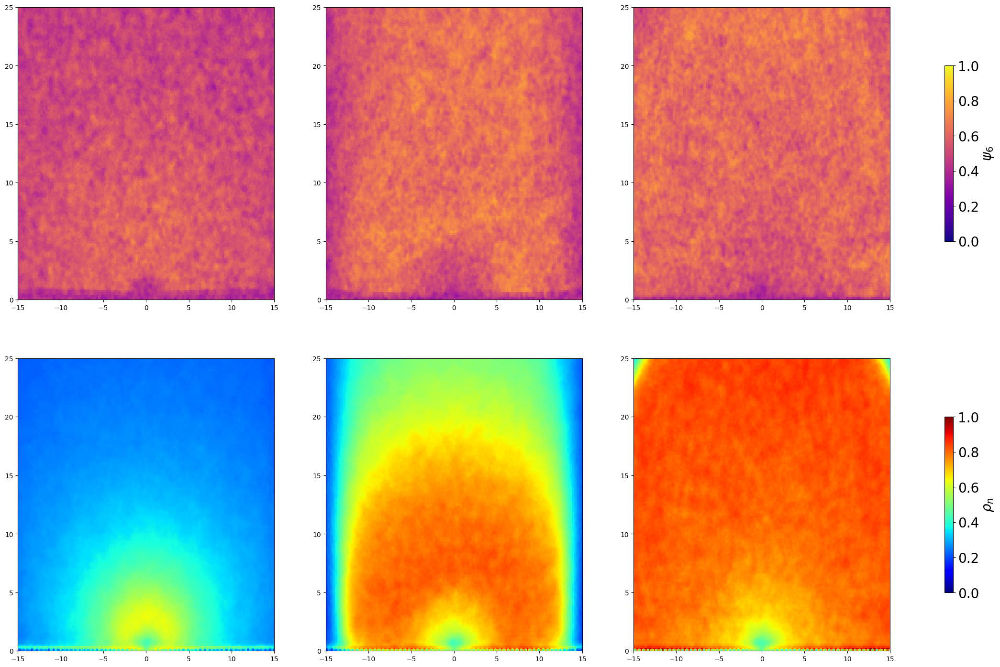

In [1238]:
plotpath = "texfiles/14_09_2021_consise_structure/Figures/fieldplot/"
os.system("mkdir " + plotpath)
fig, ax = plt.subplots(2,3,figsize = (3 * 7* 1.4,7 * 25/30 * 3))
x_circ = np.cos(np.linspace(0,np.pi,100))
y_circ = np.sin(np.linspace(0,np.pi,100))
for second,ti in zip([100,400,5000],range(len([100,400,5000]))):
    
    densnorm = np.load("texfiles/" + "field_N_ped_8000_Esigma_3/fieldtemp_large/densnorm" + str(second) + ".npy")
    ordermatrix = np.load("texfiles/" + "field_N_ped_8000_Esigma_3/fieldtemp_large/order" + str(second) + ".npy")
    where_dens = np.where(np.isnan(densnorm))
    where_order = np.where(np.isnan(densnorm))

    densnorm[where_dens] = 0
    ordermatrix[where_order] = 0
    #OrderFieldPlot(densnorm,x_array,y_array,df_t,"densnorm/" + test_str + af.b_data_name(sig,3) + "/", str(second) + "_Nped_" + str(t2) + "_fwhm" + af.b_data_name(fwhm,3), "png",1,0,"jet",True)
    #OrderFieldPlot(dens,x_array,y_array,df_t,"density/" + test_str + af.b_data_name(sig,3) + "/", str(second) + "_Nped_" + str(t2) + "_fwhm" + af.b_data_name(fwhm,3), "png",10,0,"plasma",True)
    #OrderFieldPlot(ordermatrix,x_array,y_array,df_t,"bondorientation/" + test_str + af.b_data_name(sig,3) + "/", str(second) + "_Nped_" + str(t2) + "_fwhm" + af.b_data_name(fwhm,3), "png",1,0,"plasma",True)
    
    ordermatrix = np.array(ordermatrix).mean(axis=1).mean(axis=0)[:-1, :-1]
    densmatrix = np.array(densnorm).mean(axis=1).mean(axis=0)[:-1, :-1]
    """if esig < 7:
        densmatrix = densmatrix * 7.2
    else:
        densmatrix = densmatrix * 7.2/9.9"""
    print(densmatrix.max())

    order = ax[0,ti].pcolormesh(x_array, y_array, ordermatrix, cmap='plasma',vmin = 0, vmax = 1.)
    dens = ax[1,ti].pcolormesh(x_array, y_array, densmatrix, cmap='jet',vmin = 0, vmax = 1.)
    
    """for r in [10,12]:
        ax[1,ti].plot(r * x_circ,r * y_circ,color = "black",linewidth = 5.4)
        ax[1,ti].plot(r * x_circ,r * y_circ,color = "red",linewidth = 4.8)"""
    
    """cbar = fig.colorbar(dens, ax=ax[1], shrink=1)
    cbar1 = fig.colorbar(order, ax=ax[0], shrink=1)"""

    """cbar.set_label("$\\rho_n$",fontsize = 20)
    cbar1.set_label("$\\psi_6$",fontsize = 20)
    cbar.ax.tick_params(labelsize=20)
    cbar1.ax.tick_params(labelsize=20)"""

    # set the limits of the plot to the limits of the data
    #ax.axis([x_heat.min(), x_heat.max(), y_heat.min(), y_heat.max()])
    #fig.colorbar(c, ax=ax)
#plt.savefig(plotpath +"/" + str(second) + ".pdf" )
#cbar2 = fig.colorbar(speed, ax=ax[2,:], shrink=0.6)
for i in range(2):
    for j in range(3):
        ax[i,j].set_xlim([-15,15])
        ax[i,j].set_ylim([0,25])
cbar1 = fig.colorbar(dens, ax=ax[1,:], shrink=0.6)
cbar = fig.colorbar(order, ax=ax[0,:], shrink=0.6)
#cbar2.set_label("$v$ in m/s",fontsize = 20)

cbar1.set_label("$\\rho_n$",fontsize = 20)
cbar.set_label("$\\psi_6$",fontsize = 20)
#cbar2.ax.tick_params(labelsize=20)

cbar1.ax.tick_params(labelsize=20)
cbar.ax.tick_params(labelsize=20)
plt.savefig(plotpath +"/" + str(second) + ".png")
plt.show()

6100
(360,) (260,) (1, 29, 260, 360)


/Users/jonas/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:19: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
/Users/jonas/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:21: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.


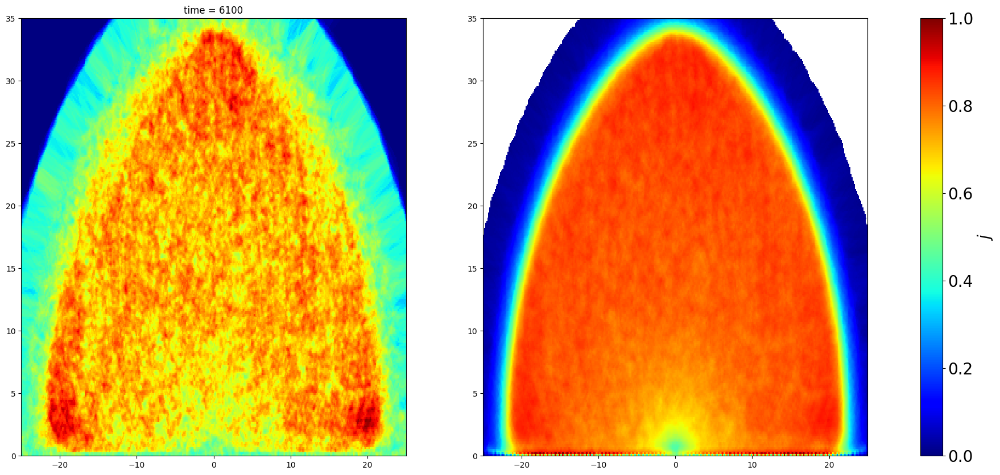

In [1245]:
#plotpath = path + "plots/fieldtemp_large/fieldplots"
#os.system("mkdir " + plotpath)
#time_list = np.arange(1000,2600,100)
#time_list = np.append(time_list,np.arange(3000,11000,500))
for second,ti in zip(times[1:2],range(len(times))):
    print(second)

    speed = np.load("texfiles/" + "field_N_ped_8000_Esigma_3/fieldtemp_large/densnorm" + str(second) + ".npy")
    dens = np.load("texfiles/" + "field_N_ped_8000_Esigma_3/fieldtemp_large/order" + str(second) + ".npy")
    where_0 = np.where(np.isnan(dens))


    dens[where_0] = 0
    speedmatrix = np.array(speed).mean(axis=1).mean(axis=0)
    densmatrix = np.array(dens).mean(axis=1).mean(axis=0)

    fig, ax = plt.subplots(1,2, figsize = (2 * 10 * 1.2,10 * 30/30))
    print(x_array.shape,y_array.shape,speed.shape)
    ax[0].pcolormesh(x_array, y_array, densmatrix, cmap='jet',vmin = densmatrix.min(), vmax = densmatrix.max())
    
    speed = ax[1].pcolormesh(x_array, y_array, speedmatrix, cmap='jet',vmin = 0, vmax = 1.0)
    
    cbar = fig.colorbar(speed, ax=ax, shrink=1)

    cbar.set_label("$j$",fontsize = 20)
    cbar.ax.tick_params(labelsize=20)

    ax[0].set_title("time = " + str(second))
    #plt.savefig(plotpath +"/flux" + str(second) + ".jpeg" )
    plt.show()
    
    

In [17]:
import itertools
import numpy as np
import matplotlib.pyplot as plt
from numba import jit

@jit
def hoshen_loop(n_columns,n_rows,occupied,label,largest_label):
    for x in range(n_columns):
        for y in range(n_rows):
            if occupied[x,y]:
                left = 0
                above = 0
                
                if x - 1 >= 0:
                    left = occupied[x-1,y]
                if y - 1 >= 0:
                    above = occupied[x,y-1]
                if (left == 0) and (above == 0):
                    largest_label += 1
                    label[x,y] = largest_label 
                elif (left != 0) and (above == 0):
                    label[x,y] = label[x - 1,y]
                elif (left == 0) and (above != 0):
                    label[x,y] = label[x,y - 1]
                else:
                    #print(x,y)
                    label[x,y] = label[x,y-1]
                    #print(label[x,y-1])
                    label = union(label[x-1,y],label[x,y-1],label,n_columns,n_rows)
                    #print("left",label[x-1,y],"above",label[x,y-1])
                    #print(x,y)
                    #label = union_faster(label[x-1,y],label[x,y-1],label,x-1,y)
                    #print(label)

                    #where_above = np.where(label == label[x,y-1])
                    #label[where_above] = label[x - 1,y]
    return label, largest_label

@jit
def hoshen_loop_new(n_columns,n_rows,occupied,label,largest_label):
    for y in range(n_rows):
        for x in range(n_columns):
        
            if occupied[y,x]:
                left = 0
                above = 0
                
                if x - 1 >= 0:
                    left = occupied[y,x - 1]
                if y - 1 >= 0:
                    above = occupied[y - 1,x]
                if (left == 0) and (above == 0):
                    largest_label += 1
                    label[y, x] = largest_label
                elif (left != 0) and (above == 0):
                    label[y, x] = label[y, x - 1]
                elif (left == 0) and (above != 0):
                    label[y, x] = label[y - 1, x]
                else:
                    #print(x,y)
                    label[y, x] = label[y - 1, x]
                    #print(label[x,y-1])
                    #label = union_new(label[y,x - 1],label[y - 1,x],label,n_columns,n_rows)
                    label = union_fast(label[y,x - 1],label[y - 1,x],label,x-1,y)
            
                
                
                    #print("left",label[x-1,y],"above",label[x,y-1])
                    #print(x,y)
                    #label = union_faster(label[x-1,y],label[x,y-1],label,x-1,y)
                    #print(label)

                    #where_above = np.where(label == label[x,y-1])
                    #label[where_above] = label[x - 1,y]
    return label, largest_label

@jit
def union(left_label,above_label,label,n_columns,n_rows):
    for x in range(n_columns):
        for y in range(n_rows):
            if label[x,y] == left_label:
                label[x,y] = above_label
    return label
@jit

def union_new(left_label,above_label,label,n_columns,n_rows):
    for y in range(n_rows):
        for x in range(n_columns):
        
            if label[y,x] == left_label:
                label[y,x] = above_label
    return label
@jit
def union_fast(left_label,above_label,label,x,y):
    while label[y,x] == left_label and x > -1:
        label[y,x] = above_label
        x -= 1
    return label

def hoshen_kopelman(occupied):
    largest_label = 0
    #n_columns = occupied.shape[0]
    #n_rows = occupied.shape[1]
    #label = np.zeros([n_columns,n_rows])
    
    n_rows = occupied.shape[0]
    n_columns = occupied.shape[1]
    label = np.zeros([n_rows,n_columns])

    #labels_x = np.arange(0,int(n_columns*n_rows) ,1)
    #labels_y = np.arange(0,int(n_columns*n_rows) ,1)

    #labels = []
    
    #for x in np.arange(0,n_columns, 1):
        #for y in np.arange(0,n_rows, 1):
    #print("start hoshen kopelman")
    label, largest_label = hoshen_loop(n_columns,n_rows,occupied,label,largest_label)
    
    return label




In [20]:
import itertools
import numpy as np
import matplotlib.pyplot as plt
from numba import jit

@jit
def hoshen_loop(n_columns,n_rows,occupied,label,largest_label):
    for x in range(n_columns):
        for y in range(n_rows):
            if occupied[x,y]:
                left = 0
                above = 0
                
                if x - 1 >= 0:
                    left = occupied[x-1,y]
                if y - 1 >= 0:
                    above = occupied[x,y-1]
                if (left == 0) and (above == 0):
                    largest_label += 1
                    label[x,y] = largest_label 
                elif (left != 0) and (above == 0):
                    label[x,y] = label[x - 1,y]
                elif (left == 0) and (above != 0):
                    label[x,y] = label[x,y - 1]
                else:
                    label[x,y] = label[x,y-1]
                    label = union(label[x-1,y],label[x,y-1],label,n_columns,n_rows)
    return label, largest_label

@jit
def union(left_label,above_label,label,n_columns,n_rows):
    for x in range(n_columns):
        for y in range(n_rows):
            if label[x,y] == left_label:
                label[x,y] = above_label
    return label

def hoshen_kopelman(occupied):
    largest_label = 0
    n_columns = occupied.shape[0]
    n_rows = occupied.shape[1]
    label = np.zeros([n_columns,n_rows])
    
    #n_rows = occupied.shape[0]
    #n_columns = occupied.shape[1]
    #label = np.zeros([n_rows,n_columns])

    #labels_x = np.arange(0,int(n_columns*n_rows) ,1)
    #labels_y = np.arange(0,int(n_columns*n_rows) ,1)

    #labels = []
    
    #for x in np.arange(0,n_columns, 1):
        #for y in np.arange(0,n_rows, 1):
    #print("start hoshen kopelman")
    label, largest_label = hoshen_loop(n_columns,n_rows,occupied,label,largest_label)
    
    return label




In [21]:
#occupied = np.array([[1,0,0,1,1,0],[0,1,1,1,1,0],[0,0,1,0,0,0],[1,1,0,1,1,0],[0,0,1,1,0,1],[0,0,0,0,1,1]])
occupied = np.random.binomial(n=1, p=0.5, size=[10,10])

print(occupied.shape)
print(occupied[1,:])

label = hoshen_kopelman(occupied)

#plt.pcolormesh(occupied.shape[0], occupied.shape[1], label,vmin = 0)
print(label)
#cmap = plt.get_cmap('flag', val.shape[0])
#cmap.set_under('gray')
#speed = ax[0].pcolormesh(x_array, y_array, ordermatrix,cmap = "plasma" ,vmin = 0)
#speed = plt.pcolormesh(range(11), range(11), label,cmap = "jet" ,vmin = 1)
#plt.pcolormesh(np.arange(0,img.shape[0]), np.arange(0,img.shape[1]), label,vmin = 0)


(10, 10)
[1 0 1 1 0 0 1 1 0 0]
[[ 0.  0.  0.  5.  0.  2.  0.  7.  7.  0.]
 [ 4.  0.  5.  5.  0.  0.  7.  7.  0.  0.]
 [ 0.  0.  0.  0.  7.  7.  7.  0.  0.  0.]
 [ 0.  0.  8.  0.  0.  0.  7.  7.  0.  9.]
 [ 0.  0.  0.  0. 15. 15.  0.  7.  0.  0.]
 [ 0.  0. 15. 15. 15.  0. 12.  0.  0. 13.]
 [14.  0. 15. 15. 15.  0.  0.  0.  0.  0.]
 [ 0. 15. 15.  0.  0. 16. 16.  0.  0. 18.]
 [ 0. 15. 15. 15. 15.  0.  0. 18. 18. 18.]
 [19.  0.  0. 15. 15. 15.  0. 18.  0. 18.]]


In [50]:
n_total = []
time_list = []
order_thrashold = 0.9
times = np.arange(100,11000,100)
x,y = np.meshgrid(x_array,y_array)
distfield = np.sqrt(x ** 2 + y ** 2)
for second,ti in zip(times,range(len(times))):
    print(second)
    ordermatrix = np.load("texfiles/" + "field_N_ped_8000_Esigma_3/fieldtemp_large/order" + str(second) + ".npy")
    densnorm = np.load("texfiles/" + "field_N_ped_8000_Esigma_3/fieldtemp_large/densnorm" + str(second) + ".npy") 

    
    where_0 = np.where(np.isnan(ordermatrix))
    ordermatrix[where_0] = 0
    ordermatrix = np.array(ordermatrix).mean(axis=0)
    densnorm = np.array(densnorm).mean(axis=0)



    #ordermatrix_i = ordermatrix[0]
    for ordermatrix_i,densnorm_i,i in zip(ordermatrix,densnorm,range(ordermatrix.shape[0])):
        #print(densnorm_i.shape)
        #print(ordermatrix_i.shape)
        ordermatrix_i = fieldFilter(ordermatrix_i,densnorm_i,0.1,0,False)
 
        ordermatrix_i = fieldFilter(ordermatrix_i,ordermatrix_i,order_thrashold,1,True)
        ordermatrix_i = fieldFilter(ordermatrix_i,ordermatrix_i,order_thrashold,0,False)
       
        #ordermatrix = fieldFilter(ordermatrix_i,distfield,10,0,False)
        #ordermatrix = fieldFilter(ordermatrix_i,distfield,25,0,True)
        label = hoshen_kopelman(ordermatrix_i)

        val,n1 = np.unique(label, return_counts = True)

        n_total.append(n1)
        #print(n1.shape,sf.listMaker(second,n1.shape[0]).shape)
        time_list.append(sf.listMaker(second,n1.shape[0]))
    
    


#x,y = np.meshgrid(x_array,y_array)

#x[where_0] = 0
#y[where_0] = 0




100


/Users/jonas/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in less_equal
  # This is added back by InteractiveShellApp.init_path()


200
300
400
500
600
700
800
900
1000
1100
1200
1300
1400
1500
1600
1700
1800
1900
2000
2100
2200
2300
2400
2500
2600
2700
2800
2900
3000
3100
3200
3300
3400
3500
3600
3700
3800
3900
4000
4100
4200
4300
4400
4500
4600
4700
4800
4900
5000
5100
5200
5300
5400
5500
5600
5700
5800
5900
6000
6100
6200
6300
6400
6500
6600
6700
6800
6900
7000
7100
7200
7300
7400
7500
7600
7700
7800
7900
8000
8100
8200
8300
8400
8500
8600
8700
8800
8900
9000
9100
9200
9300
9400
9500
9600
9700
9800
9900
10000
10100
10200
10300
10400
10500
10600
10700
10800
10900


In [51]:
#print(np.array(n_total).flatten())
n_array = np.empty(0)
time_array = np.empty(0)
for n,t_list in zip(n_total,time_list):
    n_array = np.append(n_array,np.array(n[1:]))
    time_array = np.append(time_array,np.array(t_list[1:]))

In [52]:
len(t_list), len(n)

(287, 287)

In [53]:
n_array = n_array * (dx * dy)/(np.pi * 0.2**2) * 0.9

In [54]:
max_bin = n_array.max()
print(max_bin)

309.85477983203367


In [55]:
print(time_array.shape[0],n_array.shape[0])

881317 881317


In [56]:
n,bins = np.histogram(n_array,bins = np.arange(0,int(max_bin + 20),10))


/Users/jonas/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in less_equal
  # This is added back by InteractiveShellApp.init_path()


(329,)


/Users/jonas/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:56: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.


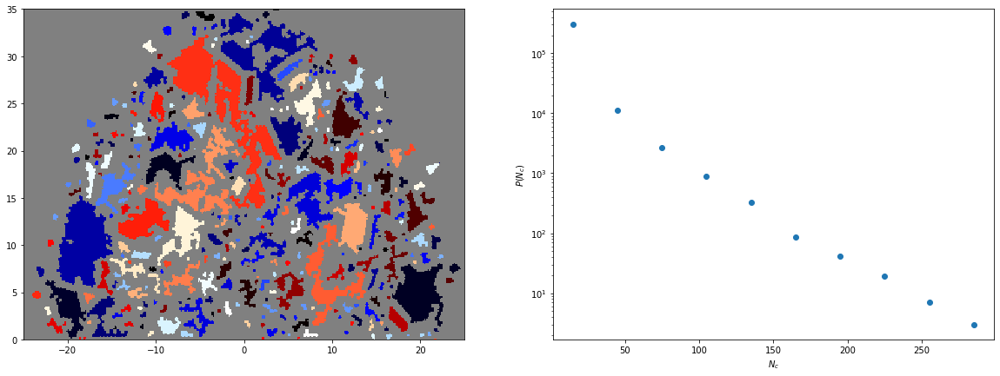

In [285]:
import matplotlib
import random
plotpath = "texfiles/14_09_2021_consise_structure/Figures/fieldplot/"
os.system("mkdir " + plotpath)
second = 6000
#order_thrashold = 0.8
def fieldFilter(field,filterfield,filtervalue,newvalue,sup):
    if sup == True:
        where_0 = np.where(filterfield >= filtervalue)
    else:
        where_0 = np.where(filterfield <= filtervalue)
    field[where_0] = newvalue
    return field

from_list = matplotlib.colors.LinearSegmentedColormap.from_list
val,n1 = np.unique(label, return_counts = True)

ordermatrix = np.load("texfiles/" + "field_N_ped_8000_Esigma_3/fieldtemp_large/order" + str(second) + ".npy")
densnorm = np.load("texfiles/" + "field_N_ped_8000_Esigma_3/fieldtemp_large/densnorm" + str(second) + ".npy") 

densnorm = np.array(densnorm)
densnorm = densnorm.mean(axis=0)
random_number = random.randint(1,28)
densnorm = densnorm[random_number]

ordermatrix = np.array(ordermatrix)
ordermatrix = ordermatrix.mean(axis=0)
ordermatrix = ordermatrix[random_number]

where_0 = np.where(np.isnan(ordermatrix))
ordermatrix[where_0] = 0

#where_dens = np.where(densnorm <= 0.4)

ordermatrix = fieldFilter(ordermatrix,densnorm,0.1,0,False)

#x,y = np.meshgrid(x_array,y_array)
#distfield = np.sqrt(x ** 2 + y ** 2)
#ordermatrix = fieldFilter(ordermatrix,distfield,10,0,False)
#ordermatrix = fieldFilter(ordermatrix,distfield,25,0,True)

ordermatrix = fieldFilter(ordermatrix,ordermatrix,order_thrashold,1,True)
ordermatrix = fieldFilter(ordermatrix,ordermatrix,order_thrashold,0,False)
densnorm = fieldFilter(densnorm,densnorm,0.4,0,False)


label = hoshen_kopelman(ordermatrix)

print(val.shape)
fig, ax = plt.subplots(1,2, figsize = (14 * 50/35,7))
#plt.pcolormesh(x_array, y_array, label,cmap = cmap,vmin = 6)
#plt.show()
cmap = plt.get_cmap('flag', val.shape[0])
cmap.set_under('gray')
#speed = ax[0].pcolormesh(x_array, y_array, ordermatrix,cmap = "plasma" ,vmin = 0)
speed = ax[0].pcolormesh(x_array, y_array, label,cmap = cmap ,vmin = 1)

#speed = ax.pcolormesh(x_array, y_array, densnorm,cmap = "jet" ,vmin = 0)

#cbar = fig.colorbar(speed, ax=ax, shrink=1)

#cbar.set_label("$j$",fontsize = 20)
#cbar.ax.tick_params(labelsize=20)
max_bin = df_val[df_val.time > 4000].n.max()

n,bins = np.histogram(df_val[df_val.time > 4000].n.to_numpy(),bins = np.arange(0,int(max_bin + 20),30))

ax[1].plot((bins[1:] + bins[:-1])/2,n,marker = "o",linestyle = "none")
ax[1].set_yscale('log')#
#ax[1].set_xscale('log')#

ax[1].set_ylabel('$P(N_c)$')
ax[1].set_xlabel("$N_c$")
#plt.savefig(plotpath + "cluster_distribution_th_"+ str(order_thrashold) + ".pdf")
plt.show()

In [61]:
os.system("mkdir cluster_csv")
df_val.to_csv("cluster_csv/cluster_frame_" + str(order_thrashold) + ".csv")

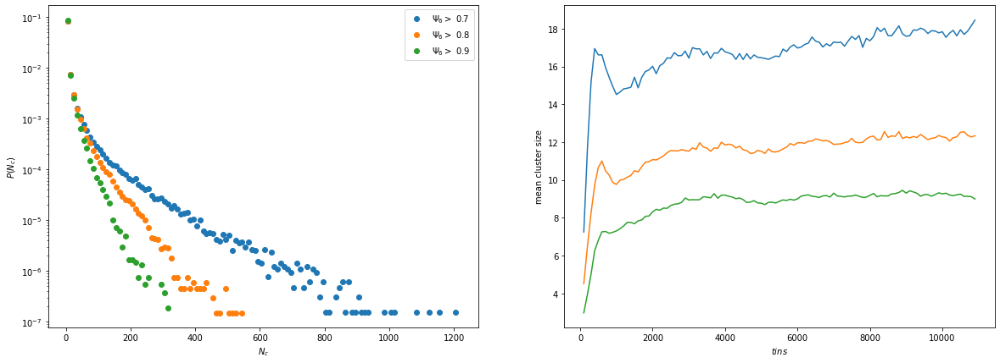

In [253]:
fig, ax = plt.subplots(1,2, figsize = (14 * 50/35,7))
for th in [0.7,0.8,0.9]:
    df_val = pd.read_csv("cluster_csv/cluster_frame_" + str(th) + ".csv")
    df_val.n = df_val.n.round()
    df_val = df_val[df_val.n > 0]
    max_bin = df_val[df_val.time > 4000].n.max()

    n,bins = np.histogram(df_val[df_val.time > 4000].n.to_numpy(),bins = np.arange(0,int(max_bin + 20),10),density = True)

    ax[0].plot((bins[1:] + bins[:-1])/2,n,marker = "o",linestyle = "none",label = "$\\Psi_6 >$ " + str(th))
    df_val = df_val[df_val.n > 1]
    ax[1].plot(df_val.groupby('time').n.mean())

ax[0].legend()
ax[0].set_yscale('log')#
#plt.xscale('log')#

ax[0].set_xlabel('$N_c$')
ax[0].set_ylabel("$P(N_c)$")


ax[1].set_xlabel('$t in s$')
ax[1].set_ylabel("mean cluster size")
plt.savefig(plotpath + "cluster_distribution_vergleich.pdf")
    

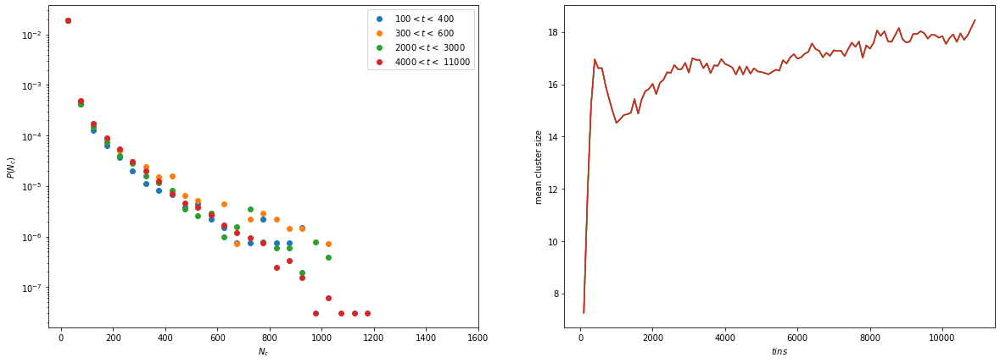

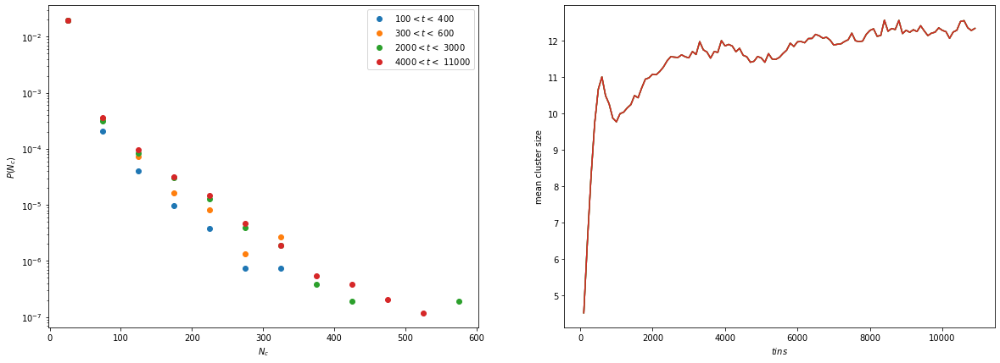

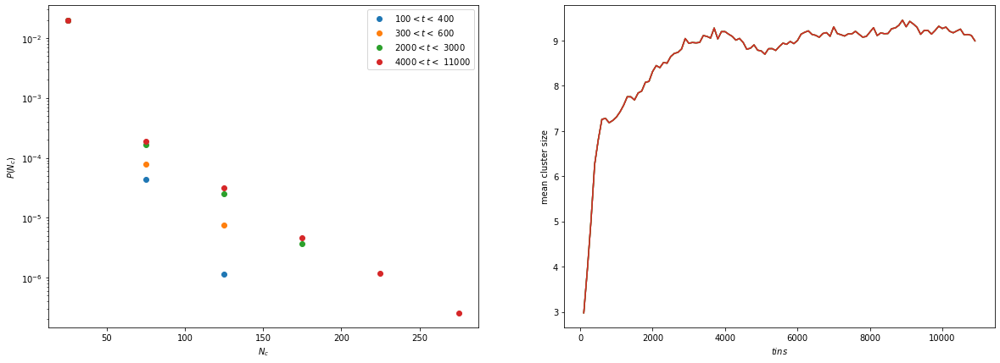

In [263]:
for th in [0.7,0.8,0.9]:
    fig, ax = plt.subplots(1,2, figsize = (14 * 50/35,7))

    for t, dt in zip([100,300,2000,4000],[300,300,1000,7000]):
        df_val = pd.read_csv("cluster_csv/cluster_frame_" + str(th) + ".csv")
        df_val.n = df_val.n.round()
        df_val = df_val[df_val.n > 0]
        max_bin = df_val[(df_val.time >= t) & (df_val.time <= t + dt)].n.max()

        n,bins = np.histogram(df_val[(df_val.time >= t) & (df_val.time <= t + dt)].n.to_numpy(),bins = np.arange(0,int(max_bin + 20),50),density = True)

        ax[0].plot((bins[1:] + bins[:-1])/2,n,marker = "o",linestyle = "none",label = str(t) + "$ < t <$ " + str(t + dt))
        df_val = df_val[df_val.n > 1]
        ax[1].plot(df_val.groupby('time').n.mean())

    ax[0].legend()
    ax[0].set_yscale('log')#
    #plt.xscale('log')#

    ax[0].set_xlabel('$N_c$')
    ax[0].set_ylabel("$P(N_c)$")


    ax[1].set_xlabel('$t in s$')
    ax[1].set_ylabel("mean cluster size")
#plt.savefig(plotpath + "cluster_distribution_time.pdf")

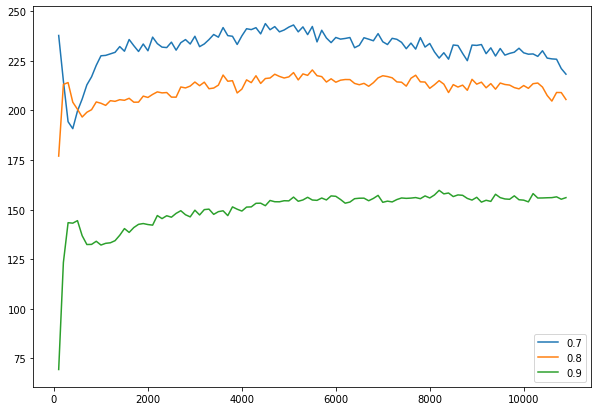

In [275]:
fig, ax = plt.subplots(1,1, figsize = (7 * 50/35,7))
for th in [0.7,0.8,0.9]:
    df_val = pd.read_csv("cluster_csv/cluster_frame_" + str(th) + ".csv")
    df_val = df_val[df_val.n > 1] 
    df_val['exist'] = sf.listMaker(1,df_val.shape[0])
    plt.plot(df_val.groupby('time').exist.sum()/30,label = str(th))
plt.legend()

100
(329,)


/Users/jonas/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in less_equal
  # This is added back by InteractiveShellApp.init_path()
/Users/jonas/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.


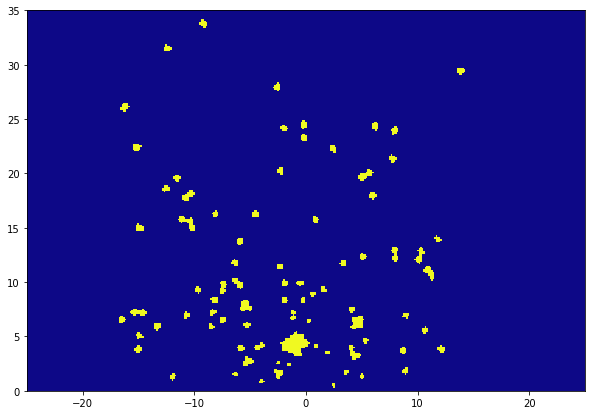

200
(329,)


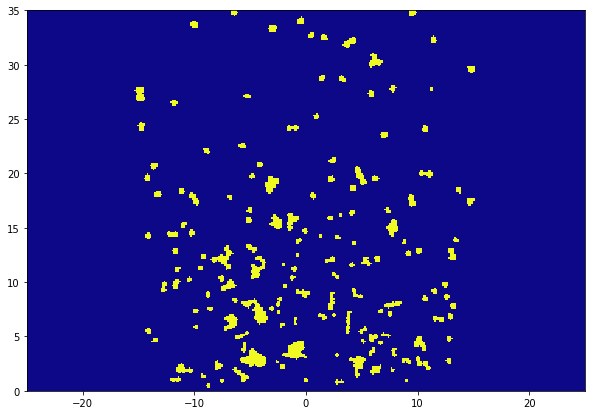

300
(329,)


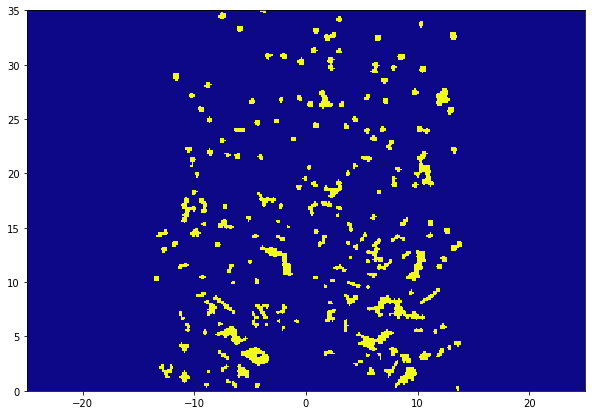

400
(329,)


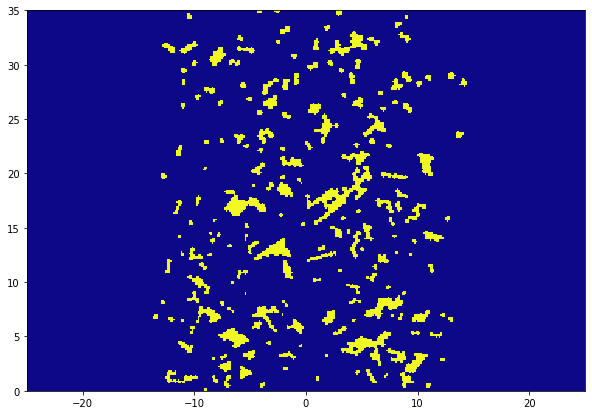

500
(329,)


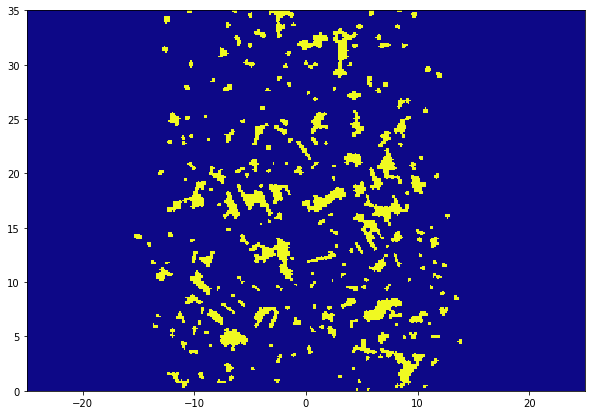

600
(329,)


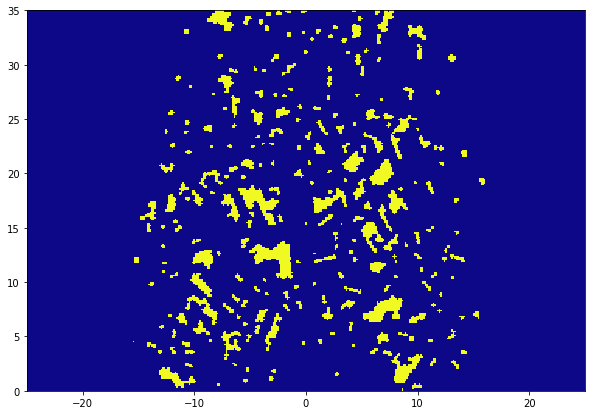

700
(329,)


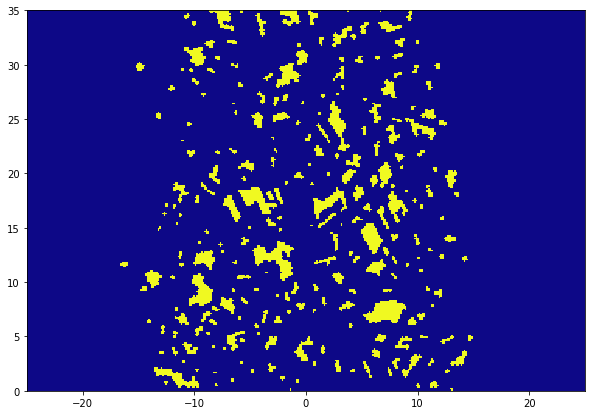

800
(329,)


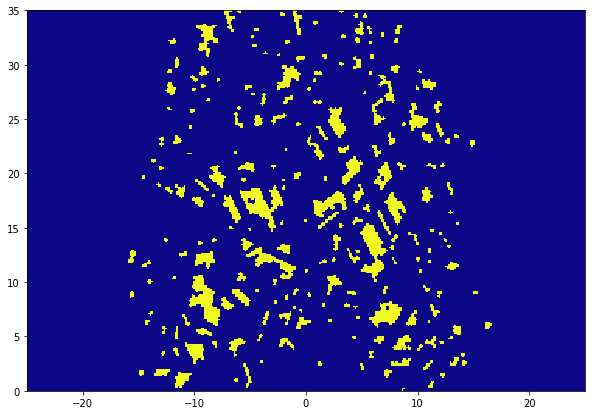

900
(329,)


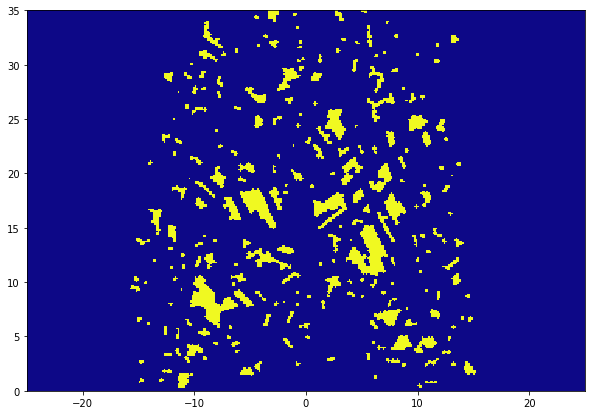

1000
(329,)


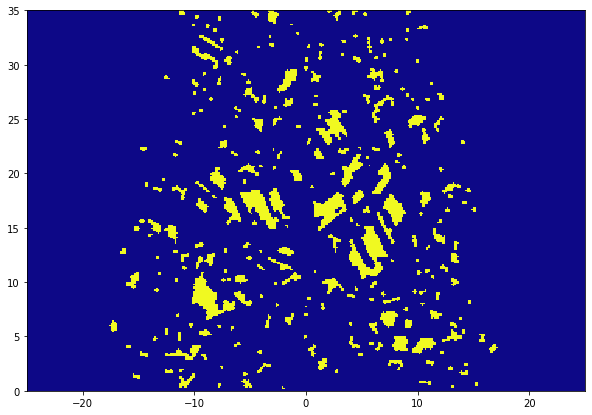

1100
(329,)


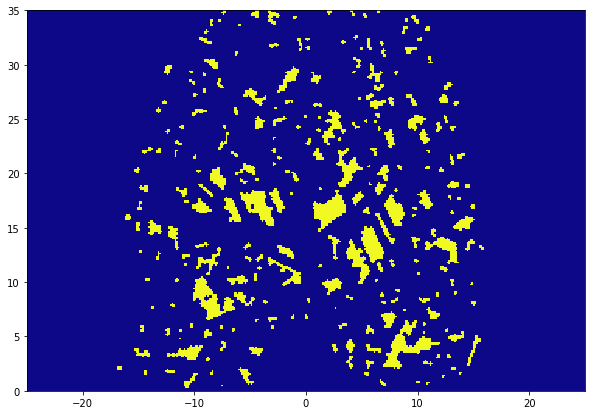

1200
(329,)


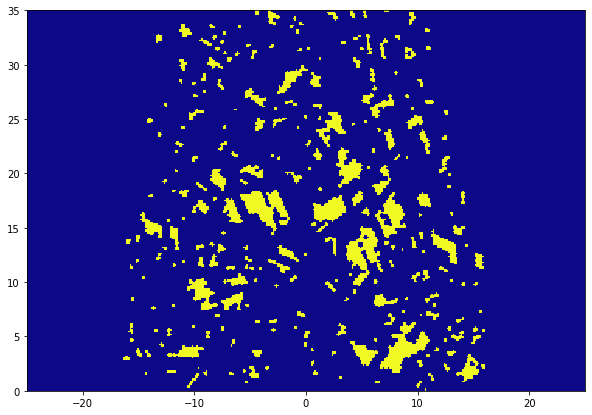

1300
(329,)


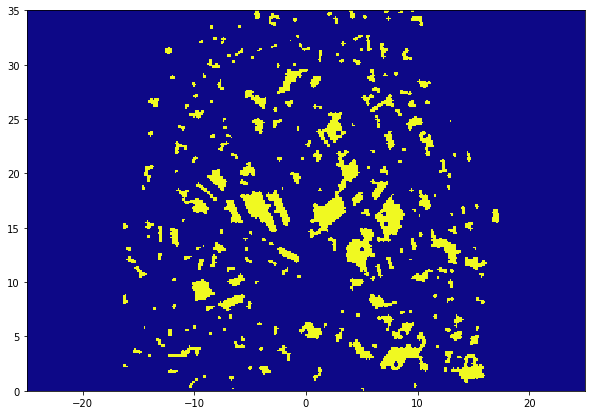

1400
(329,)


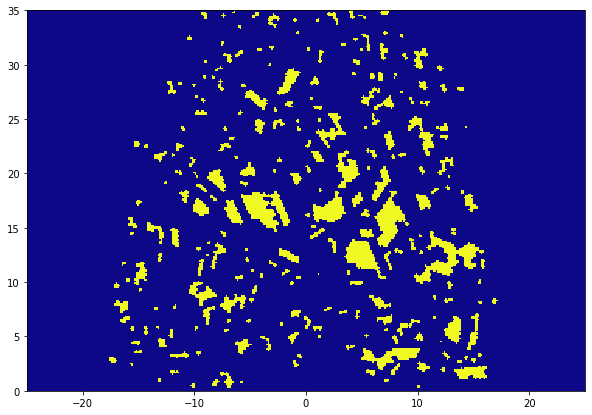

1500
(329,)


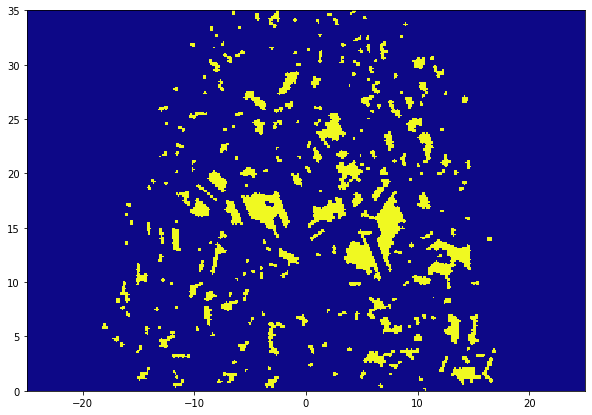

1600
(329,)


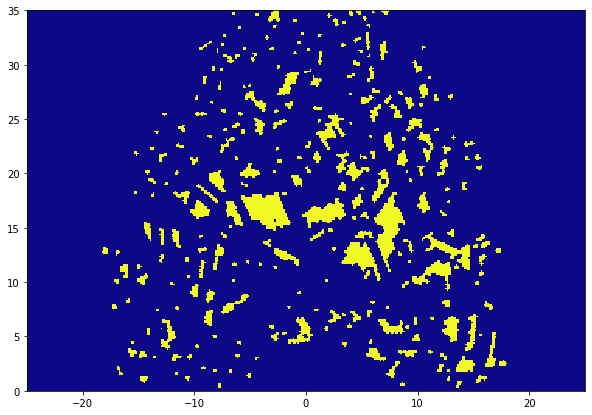

1700
(329,)


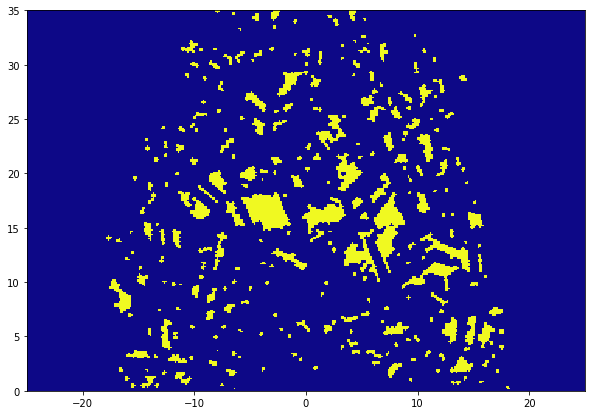

1800
(329,)


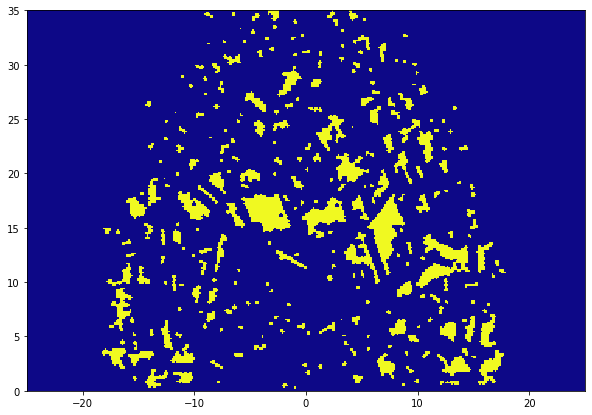

1900
(329,)


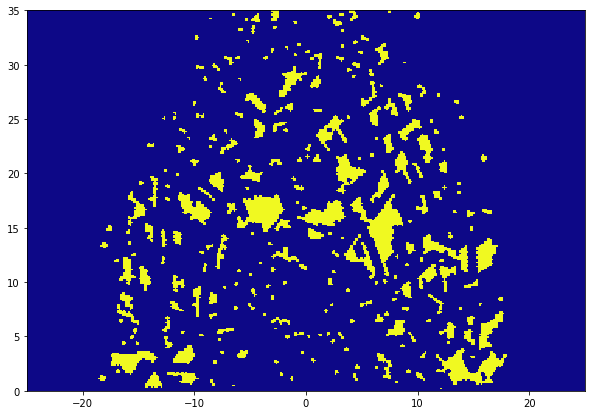

2000
(329,)


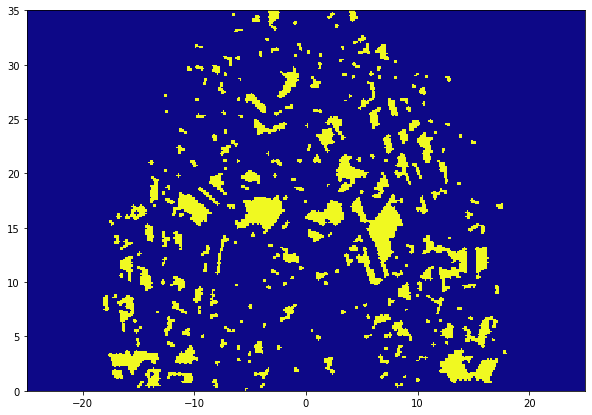

2100
(329,)


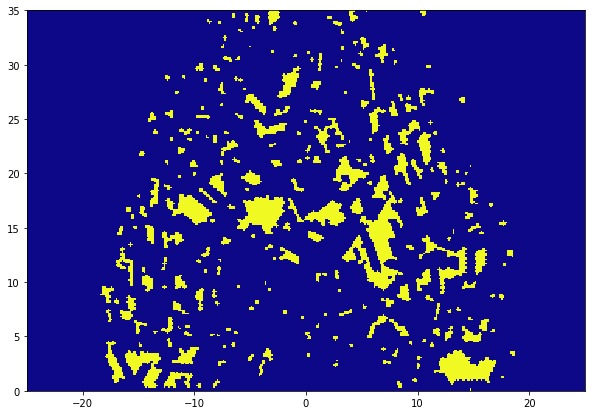

2200
(329,)


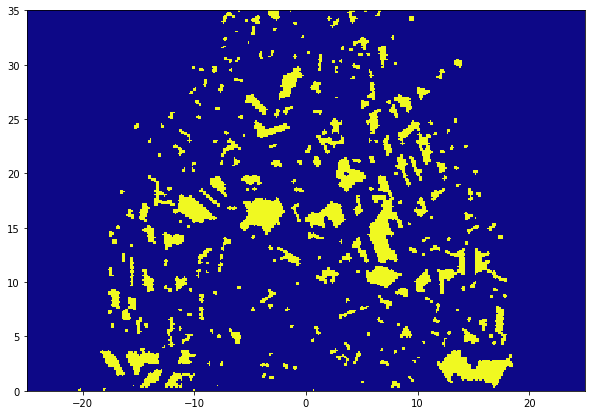

2300
(329,)


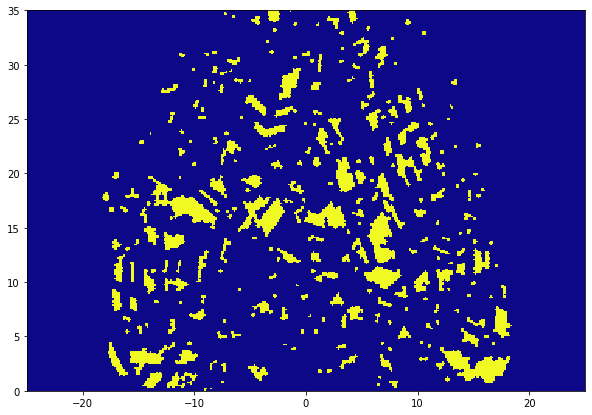

2400
(329,)


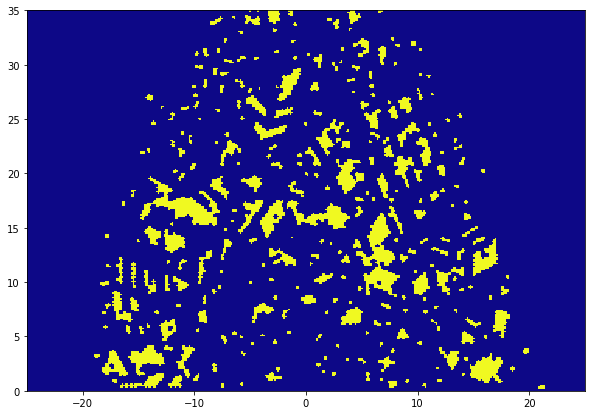

2500
(329,)


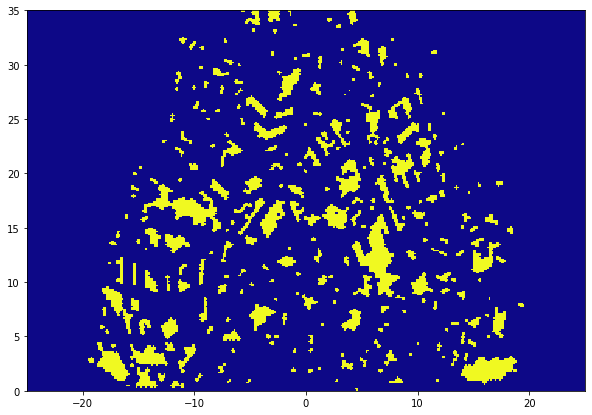

2600
(329,)


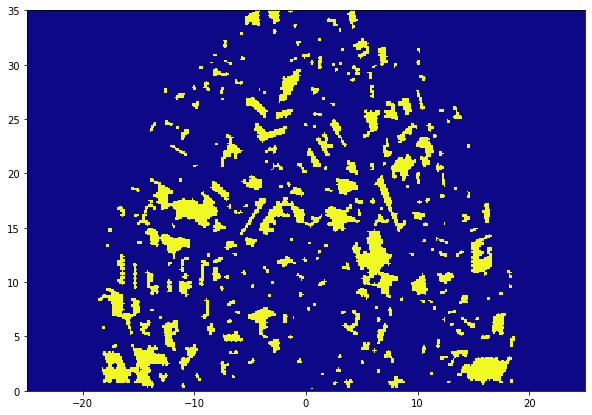

2700
(329,)


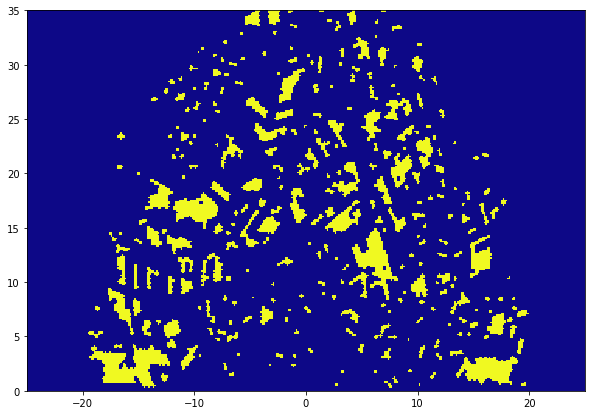

2800
(329,)


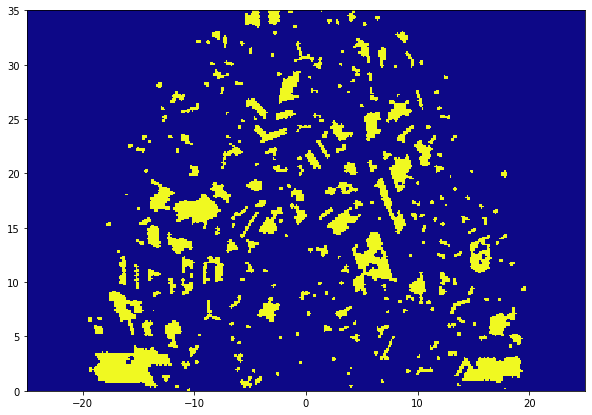

2900
(329,)


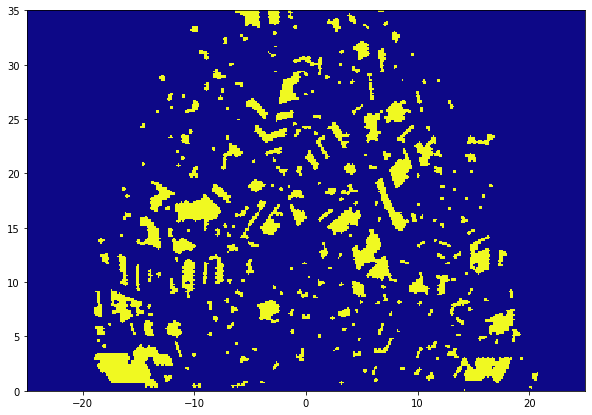

3000
(329,)


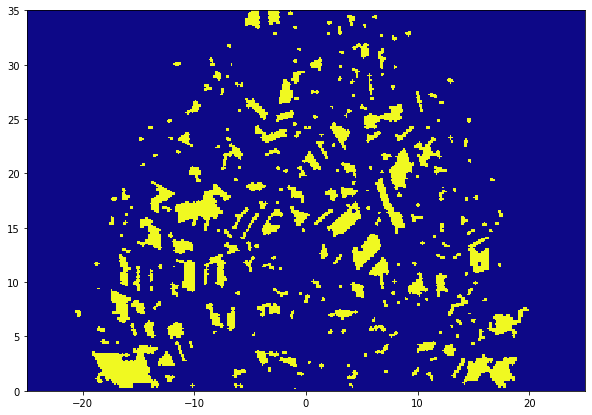

3100
(329,)


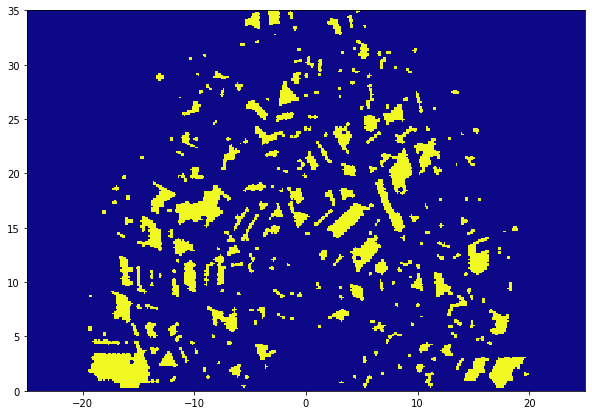

3200
(329,)


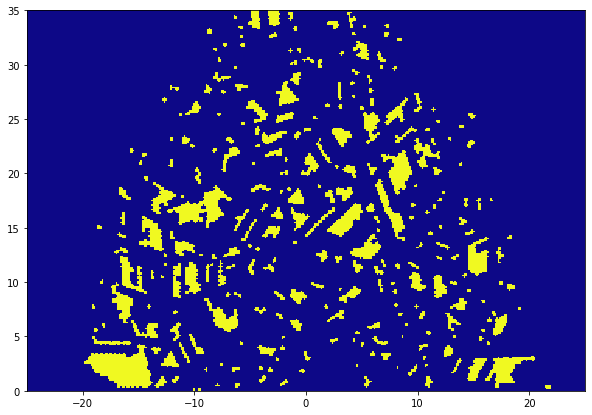

3300
(329,)


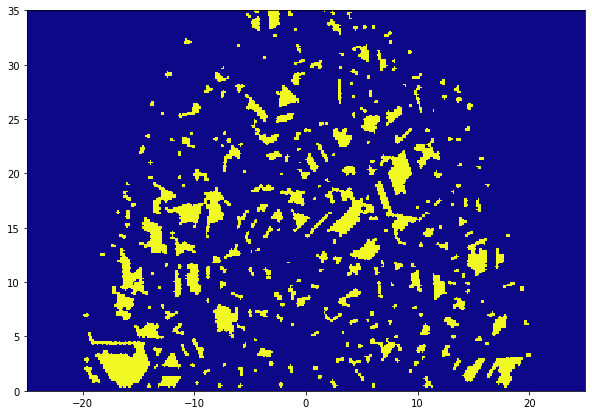

3400
(329,)


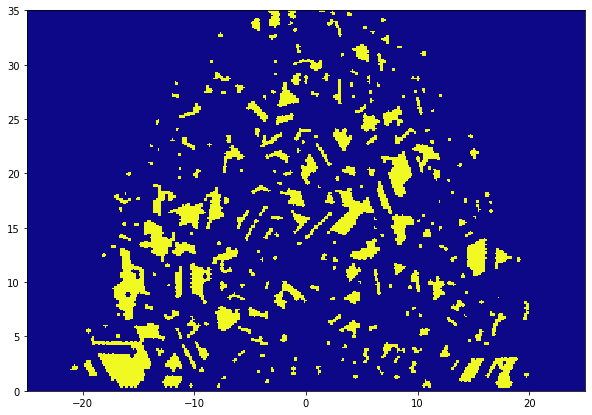

3500
(329,)


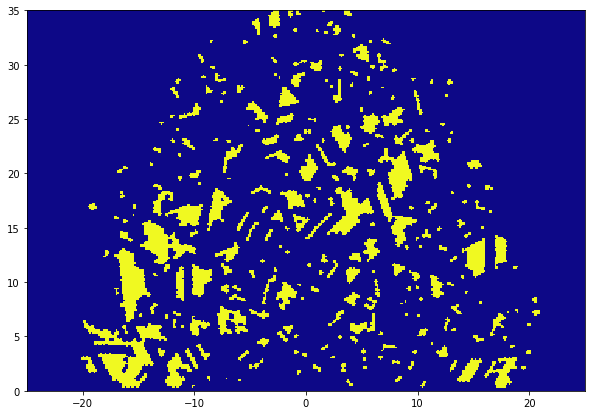

3600
(329,)


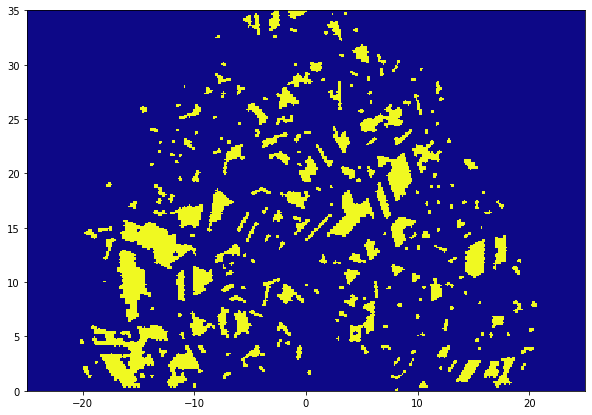

3700
(329,)


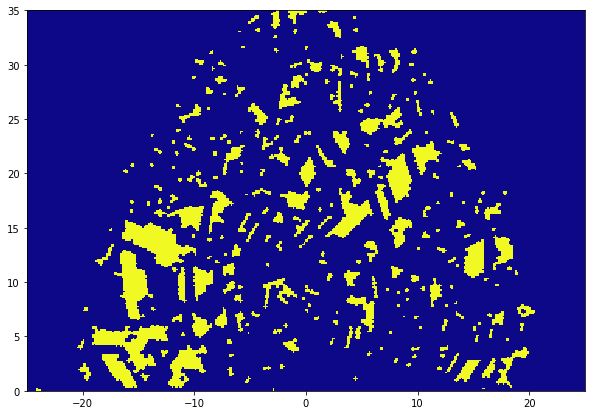

3800
(329,)


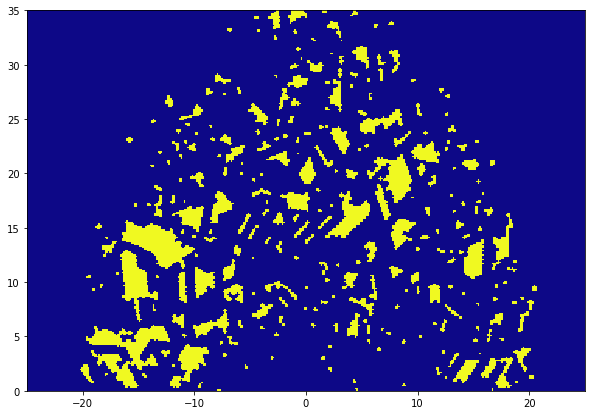

3900
(329,)


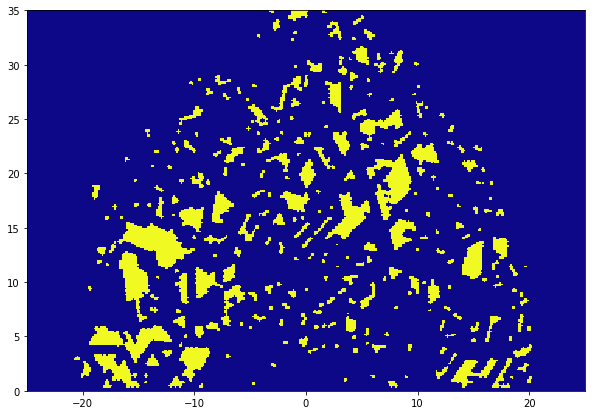

4000
(329,)


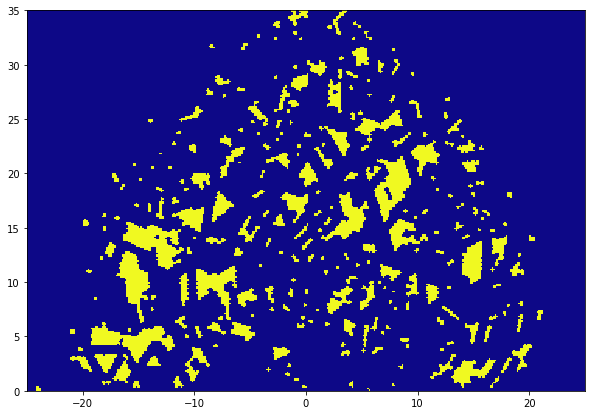

4100
(329,)


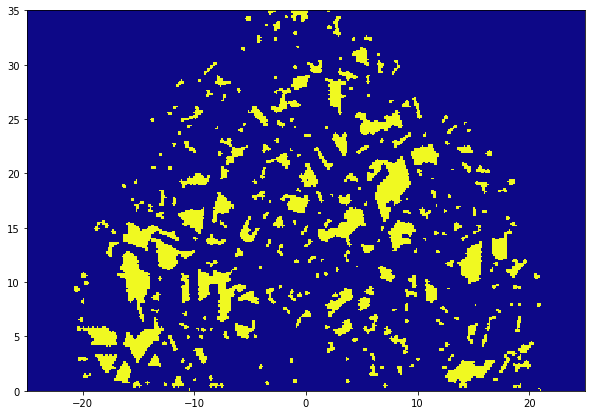

4200
(329,)


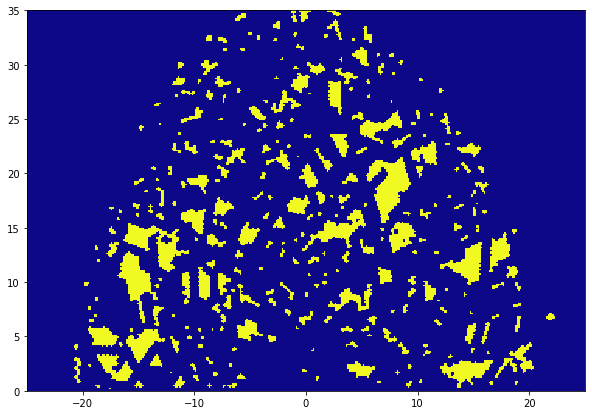

4300
(329,)


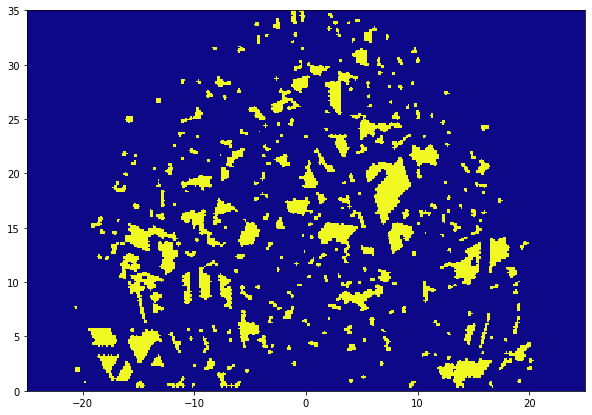

4400
(329,)


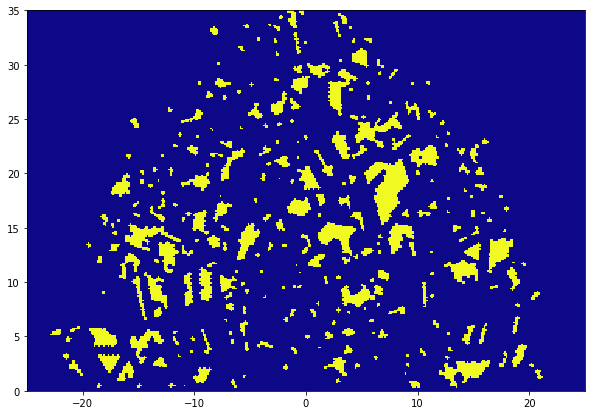

4500
(329,)


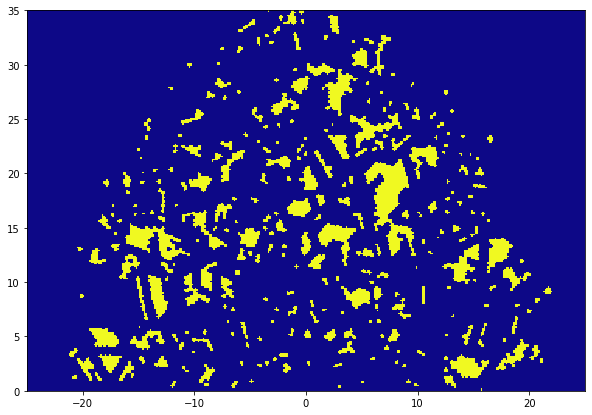

4600
(329,)


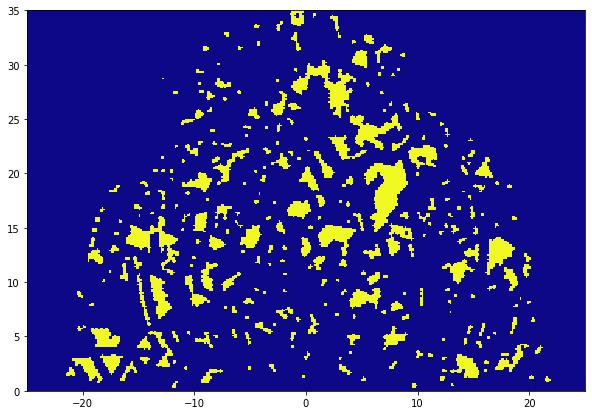

4700
(329,)


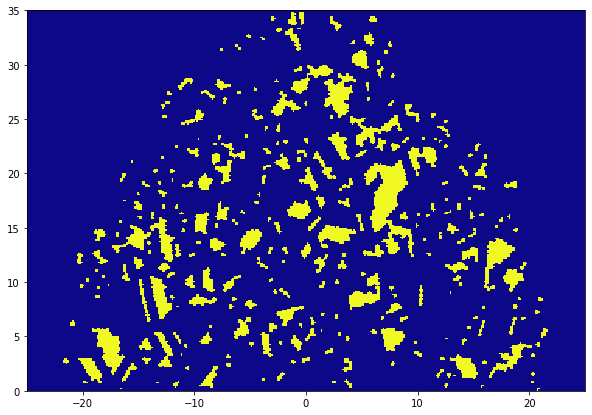

4800
(329,)


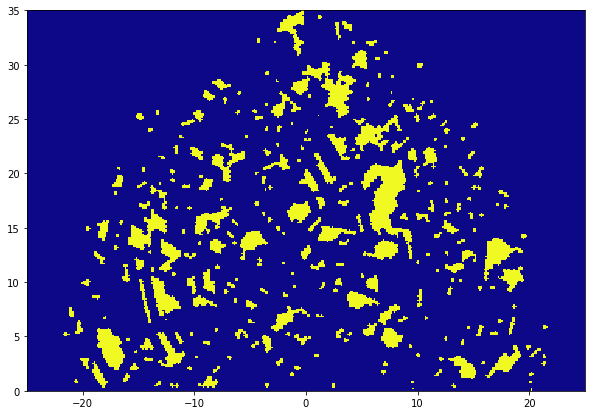

4900
(329,)


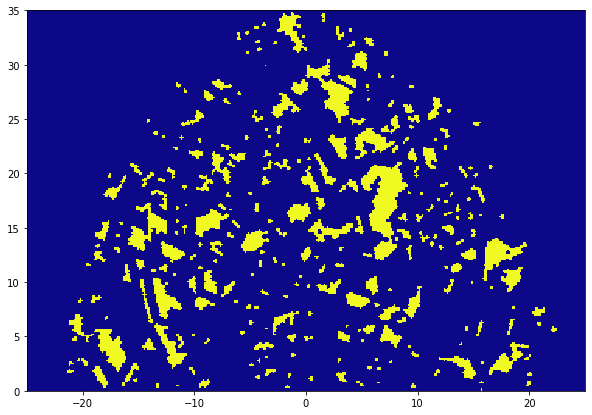

5000
(329,)


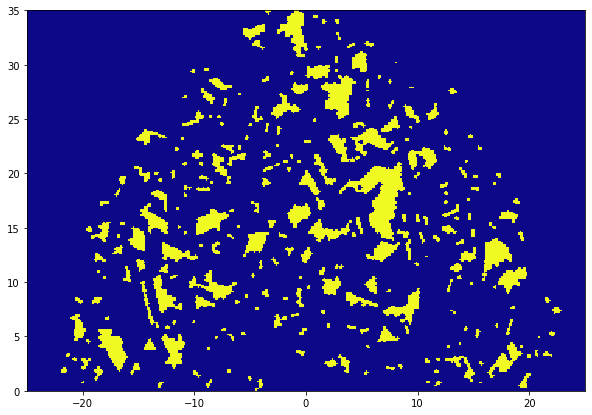

5100
(329,)


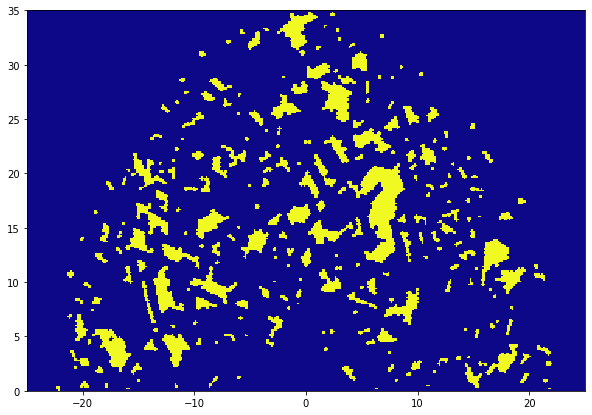

5200
(329,)


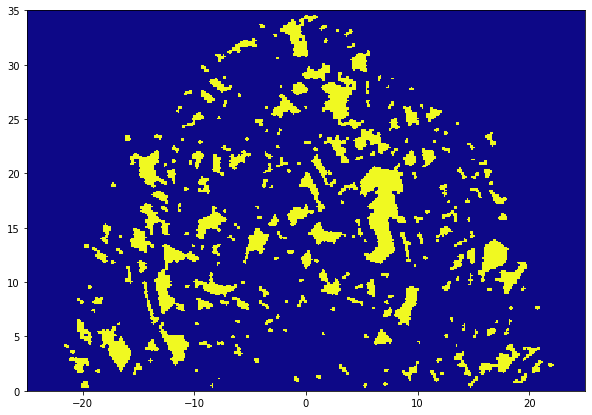

5300
(329,)


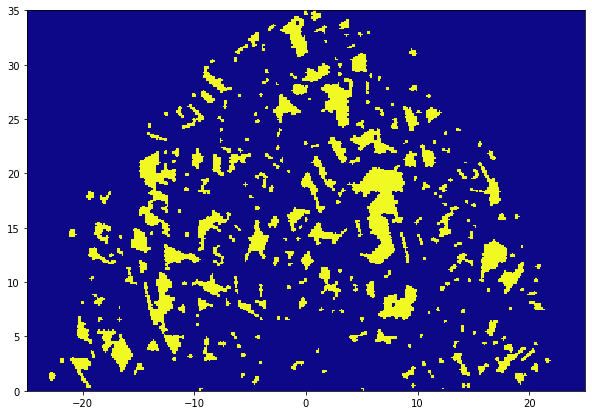

5400
(329,)


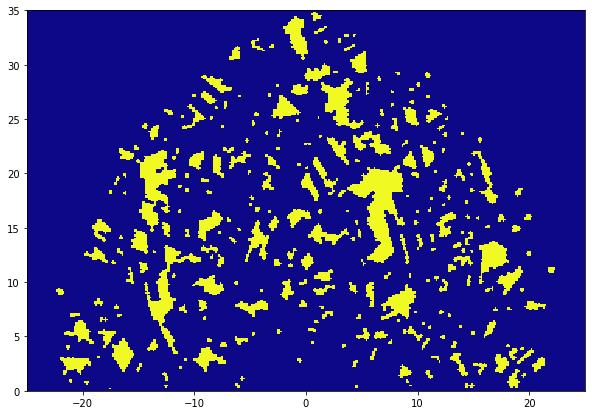

5500
(329,)


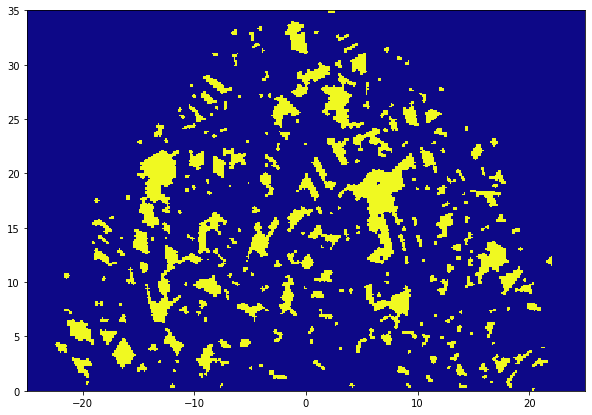

5600
(329,)


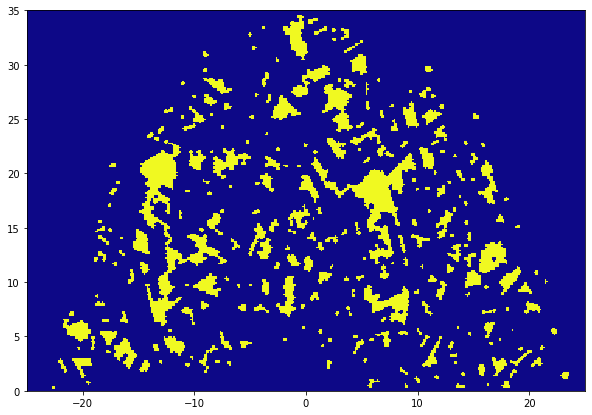

5700
(329,)


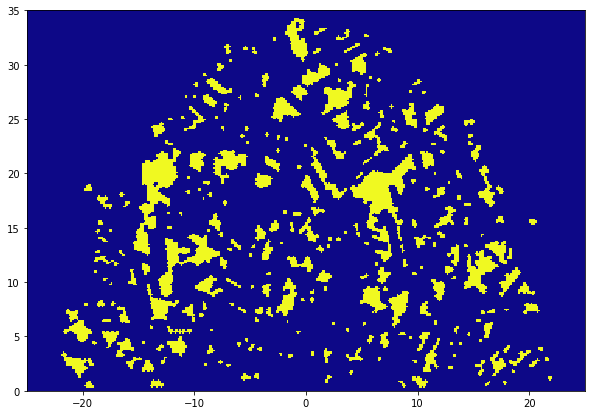

5800
(329,)


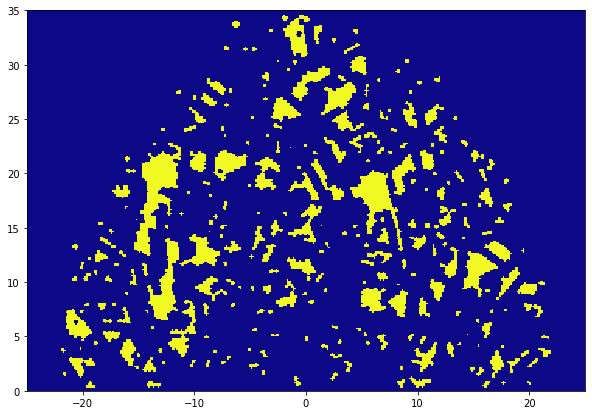

5900
(329,)


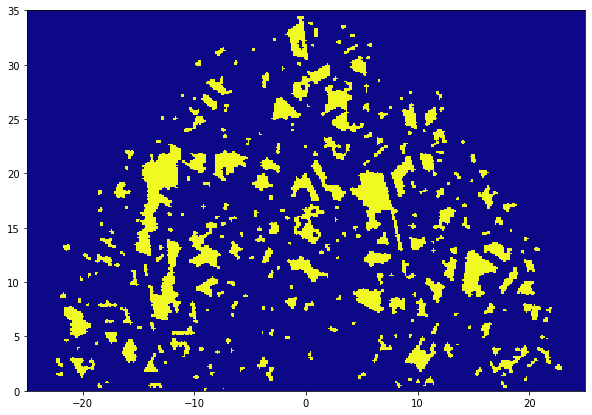

6000
(329,)


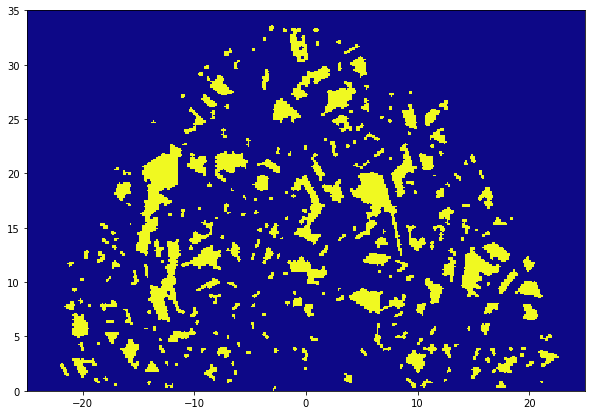

6100
(329,)


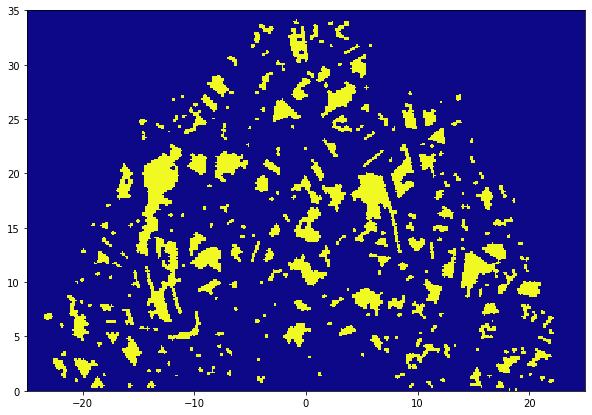

6200
(329,)


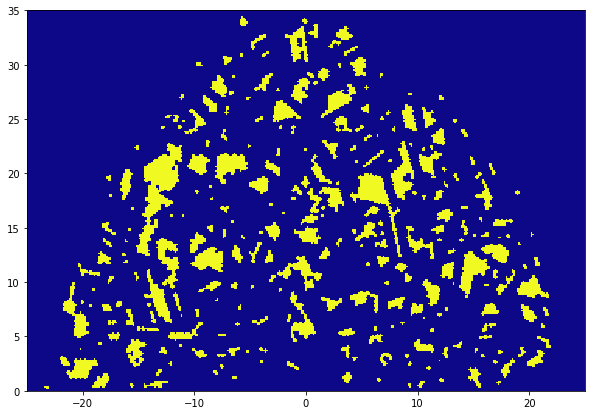

6300
(329,)


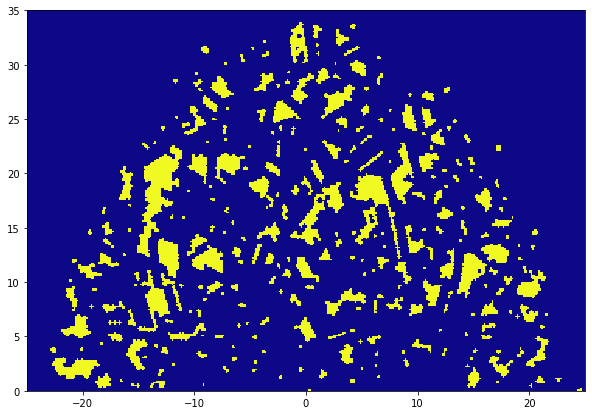

6400
(329,)


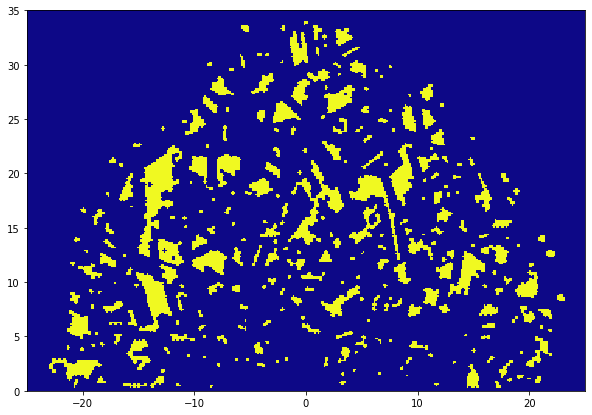

6500
(329,)


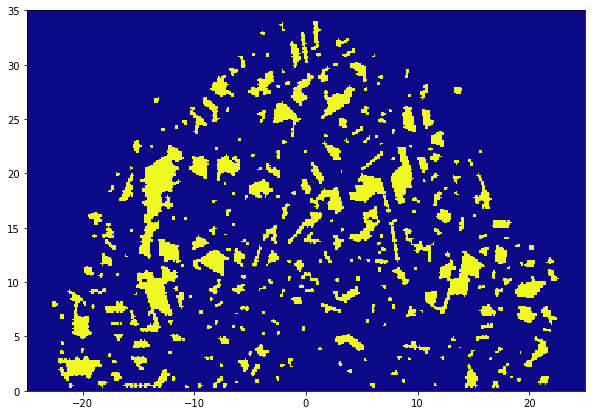

6600
(329,)


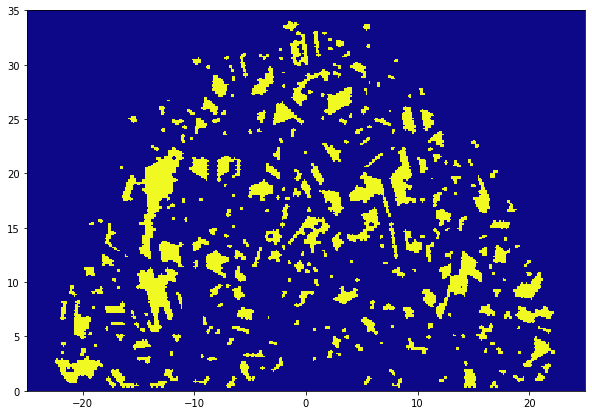

6700
(329,)


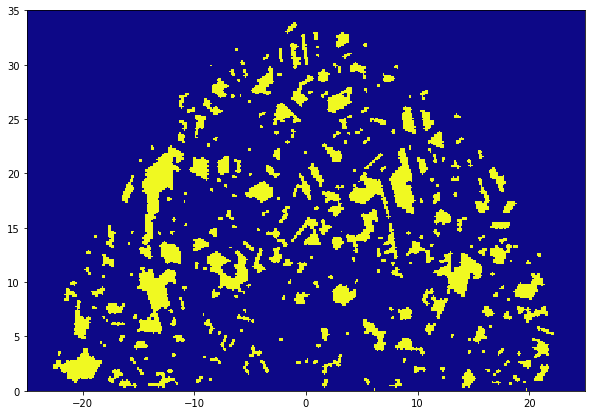

6800
(329,)


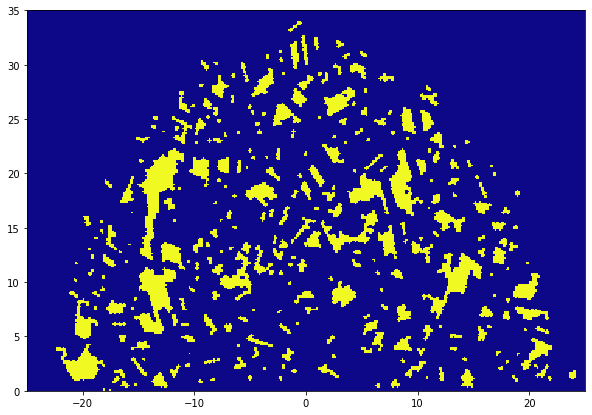

6900
(329,)


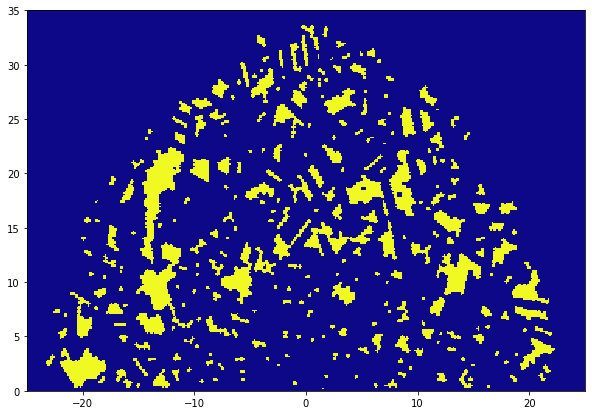

7000
(329,)


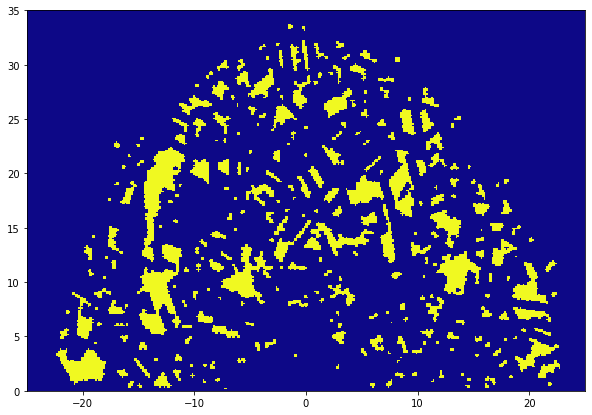

7100
(329,)


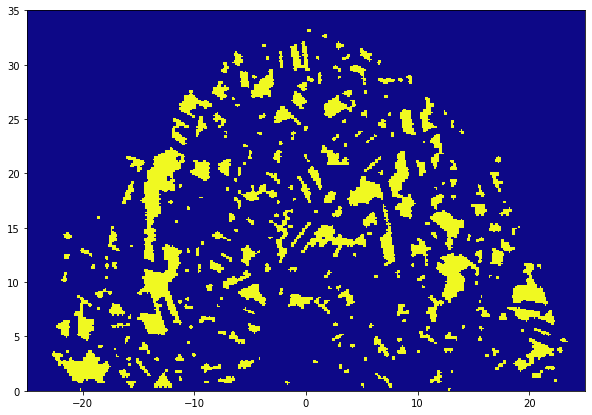

7200
(329,)


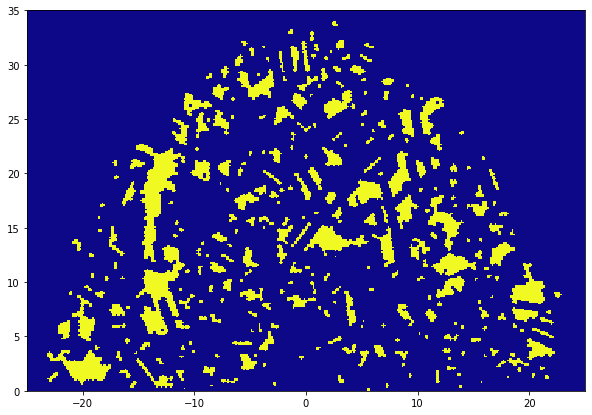

7300
(329,)


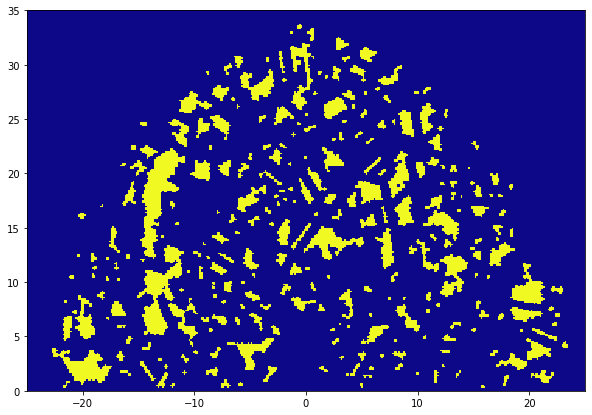

7400
(329,)


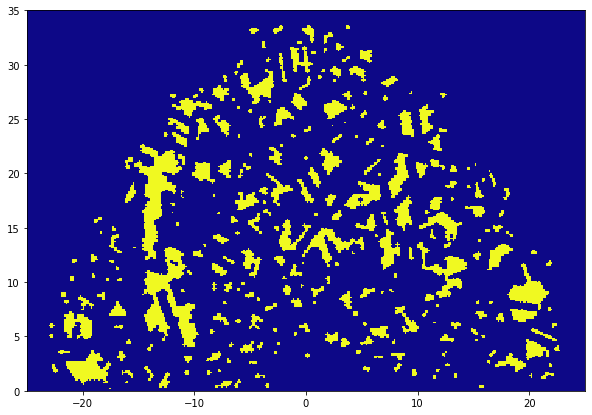

7500
(329,)


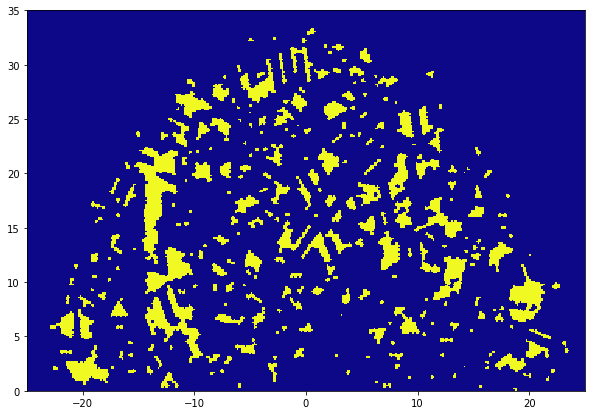

7600
(329,)


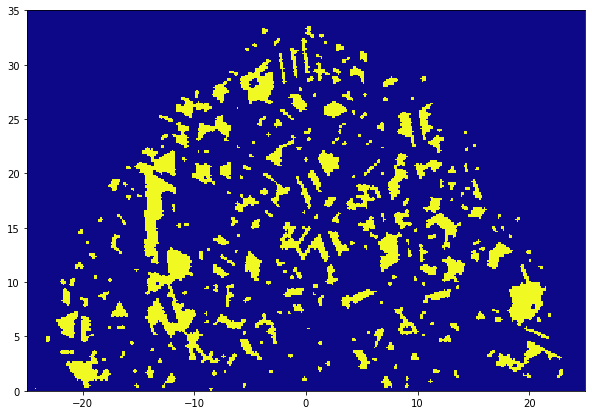

7700
(329,)


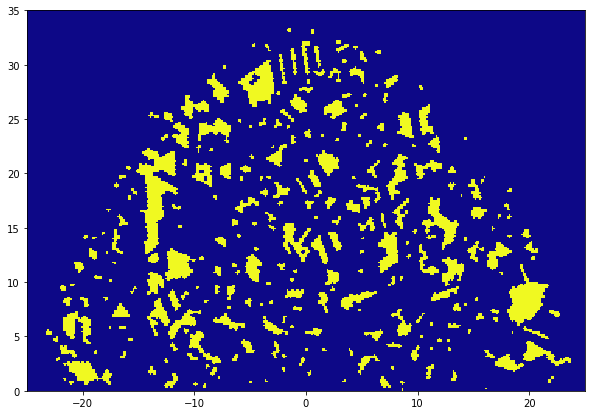

7800
(329,)


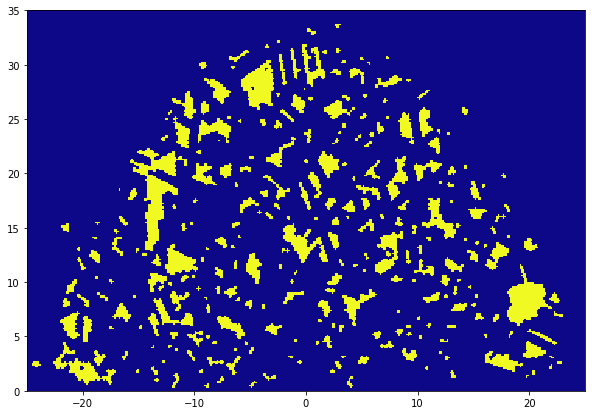

7900
(329,)


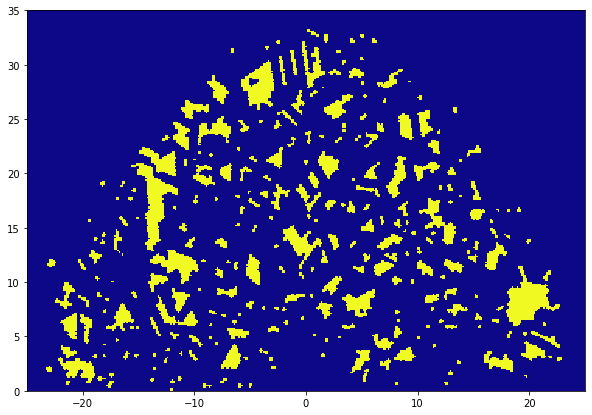

8000
(329,)


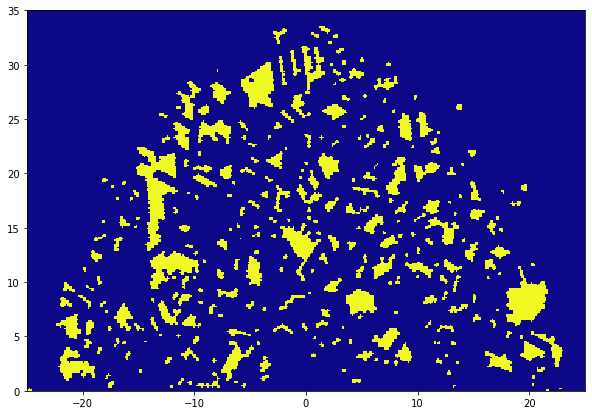

8100
(329,)


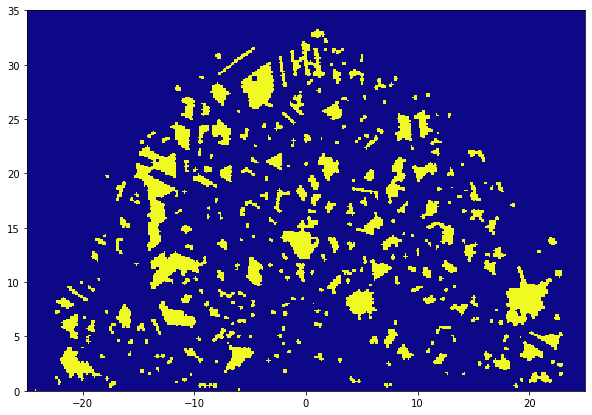

8200
(329,)


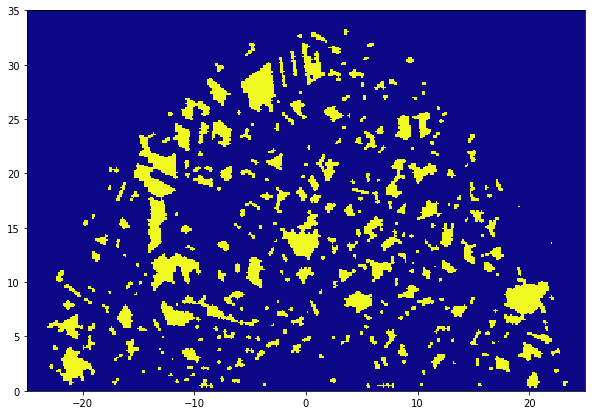

8300
(329,)


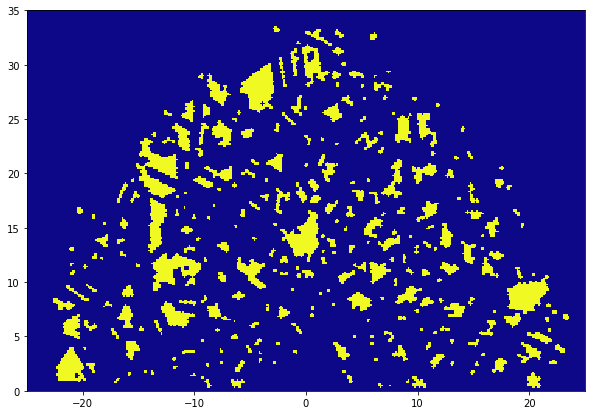

8400
(329,)


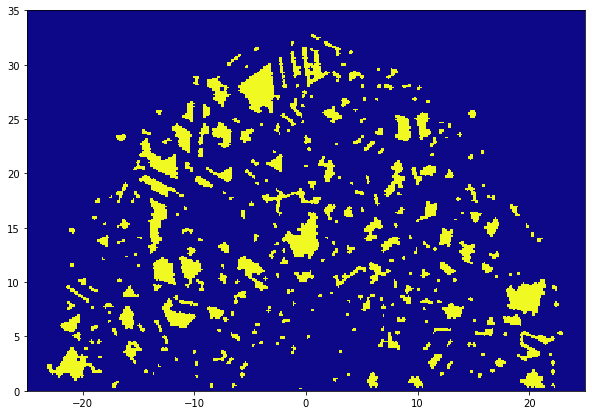

8500
(329,)


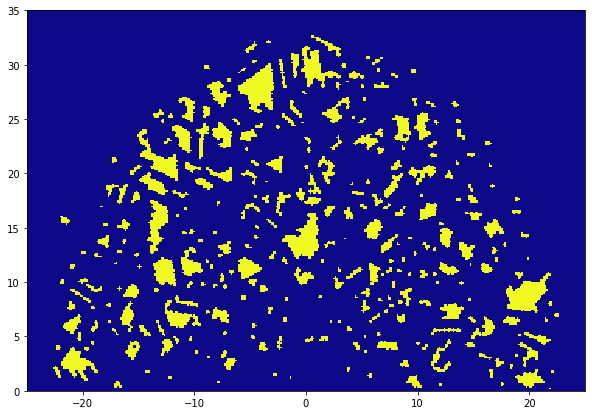

8600
(329,)


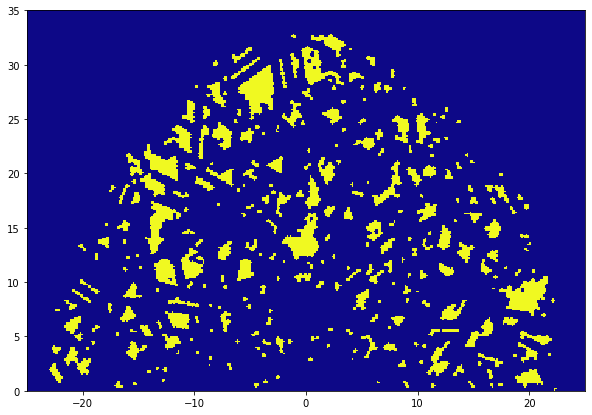

8700
(329,)


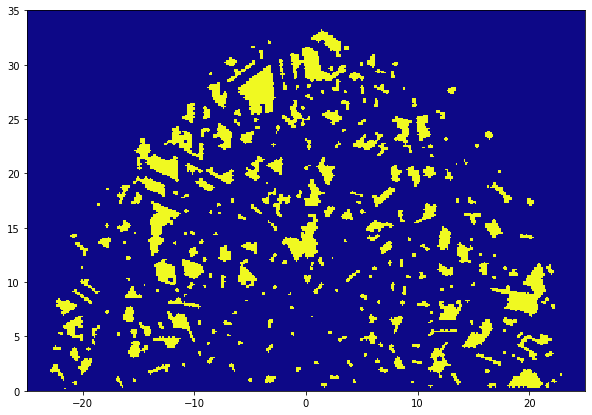

8800
(329,)


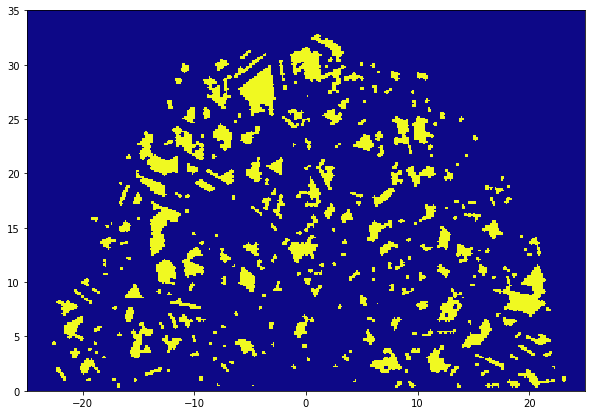

8900
(329,)


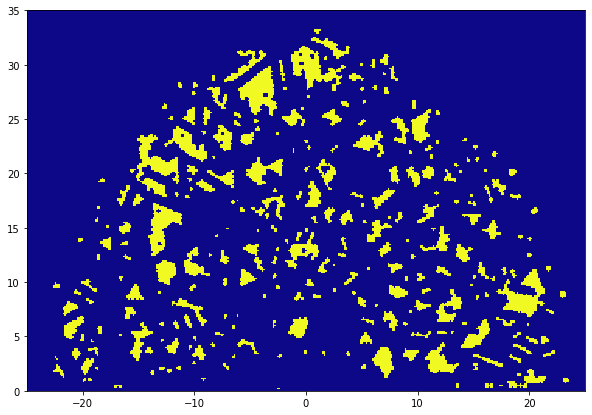

9000
(329,)


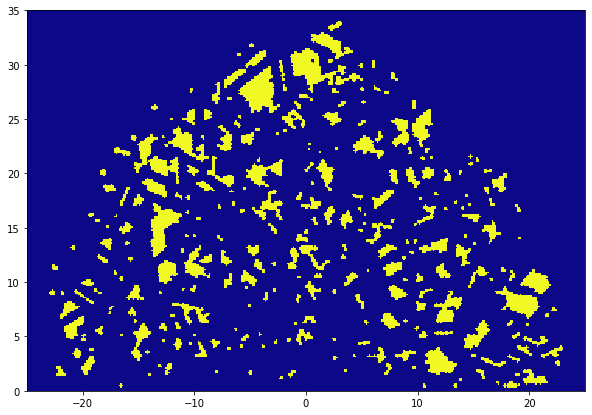

9100
(329,)


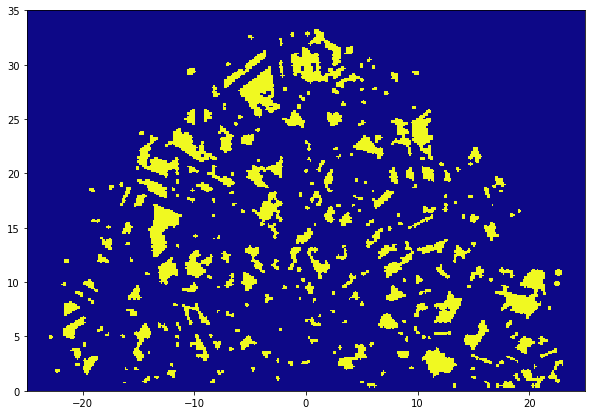

9200
(329,)


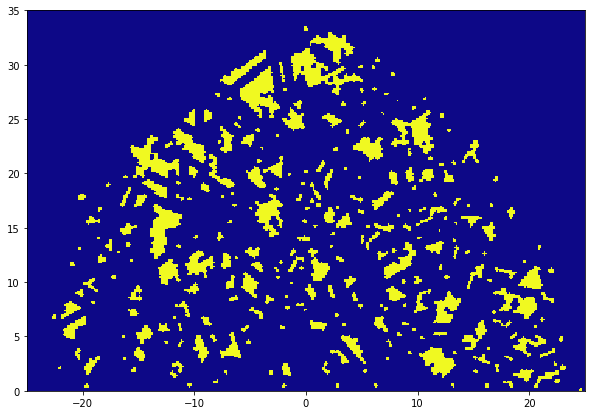

9300
(329,)


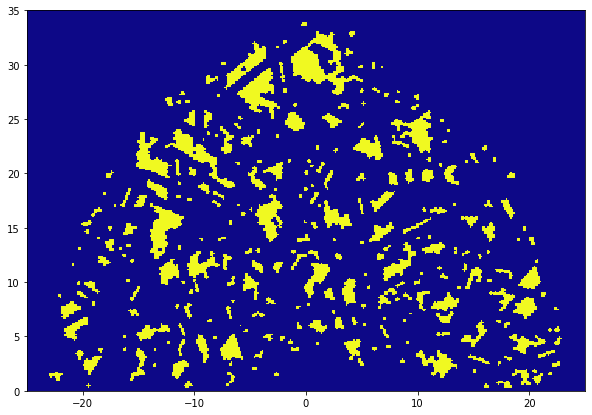

9400
(329,)


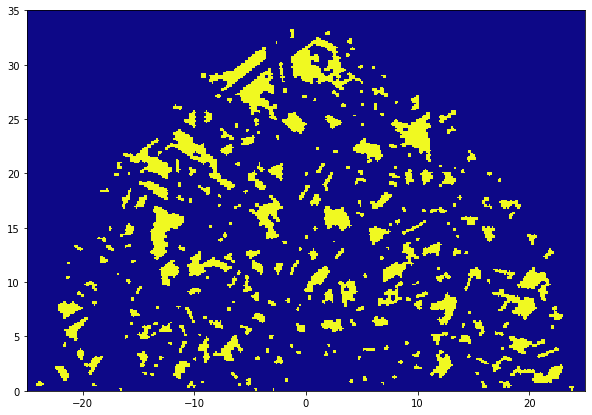

9500
(329,)


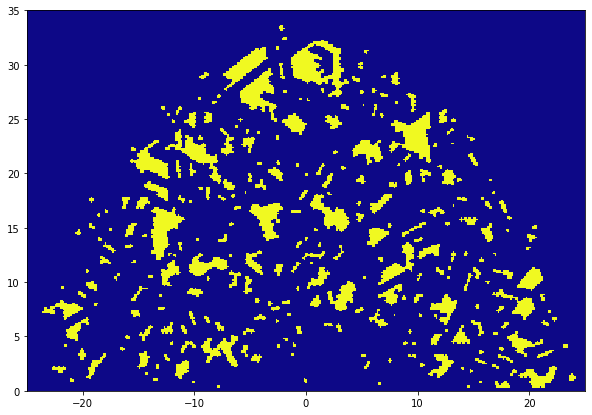

9600
(329,)


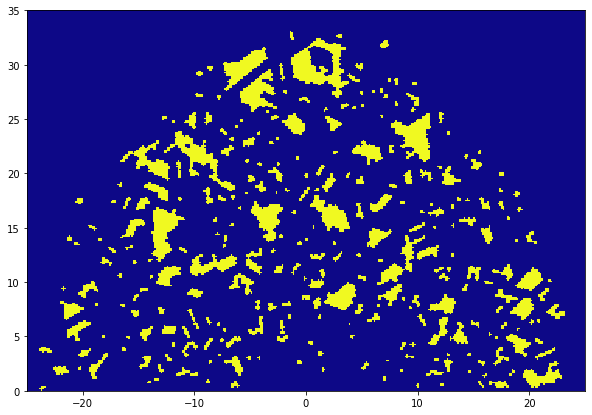

9700
(329,)


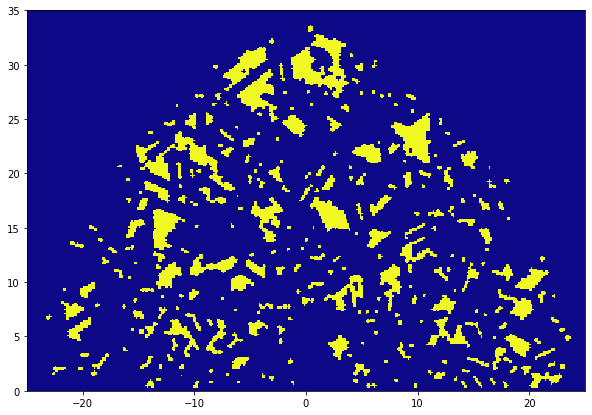

9800
(329,)


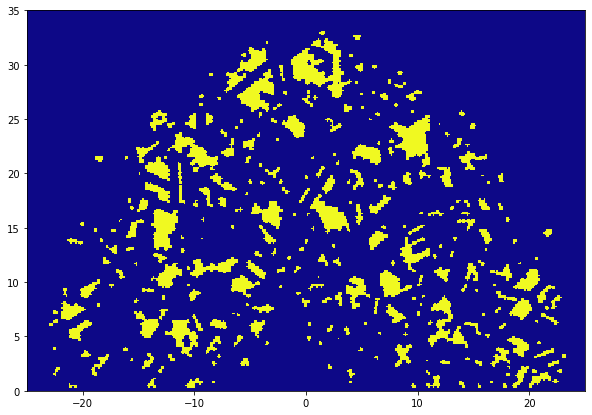

9900
(329,)


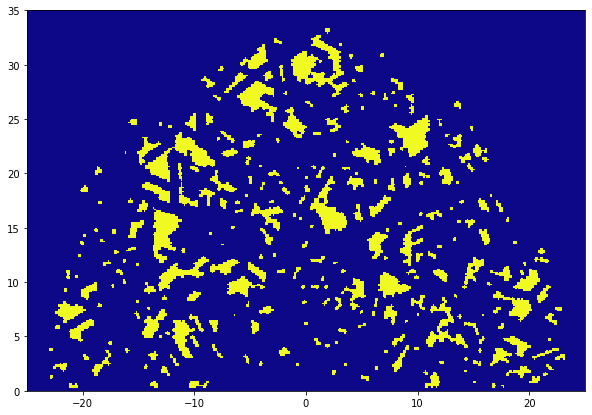

10000
(329,)


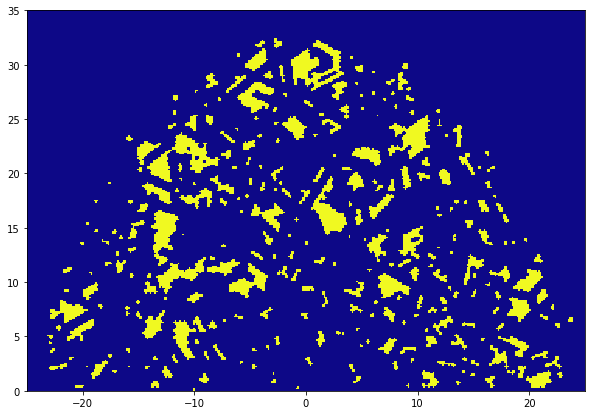

10100
(329,)


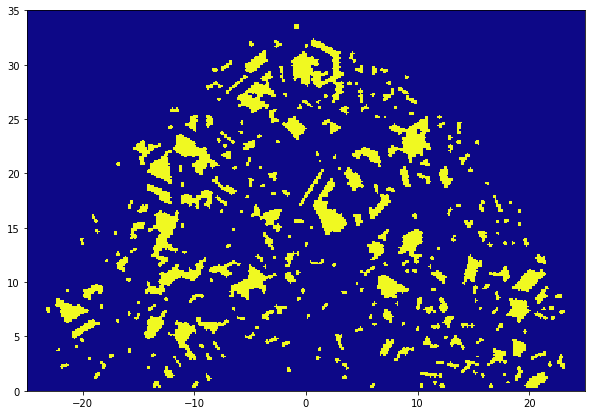

10200
(329,)


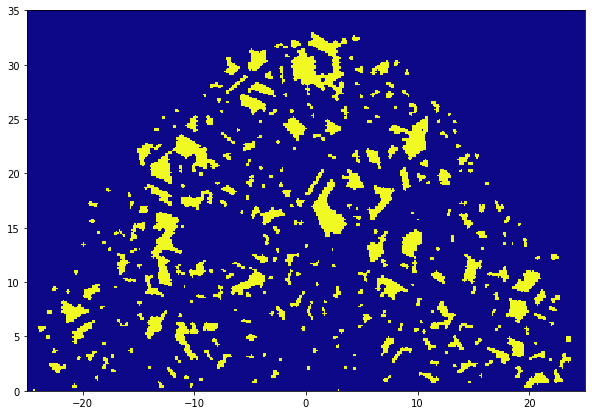

10300
(329,)


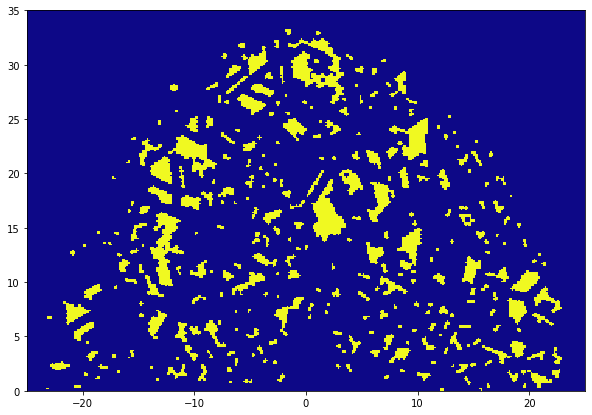

10400
(329,)


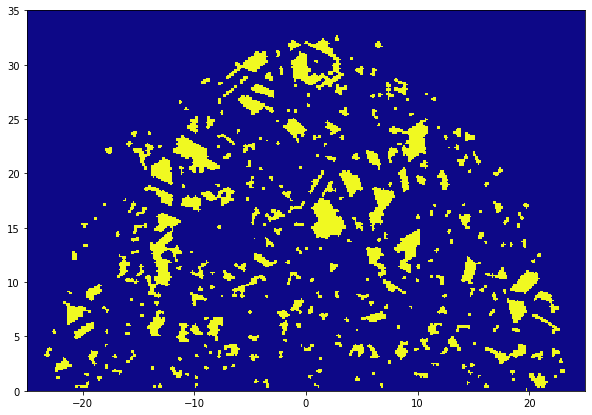

10500
(329,)


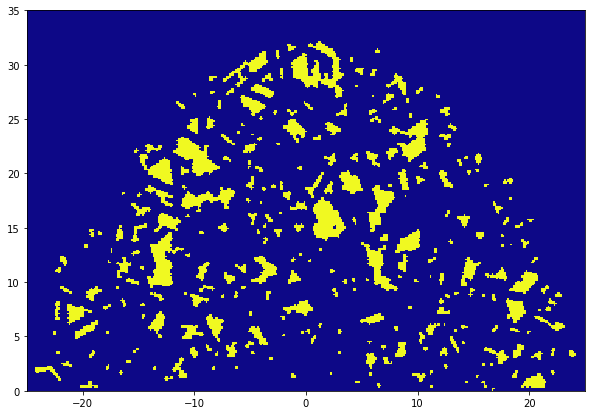

10600
(329,)


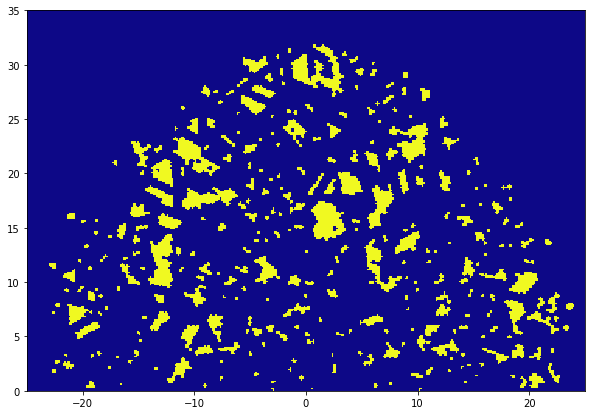

10700
(329,)


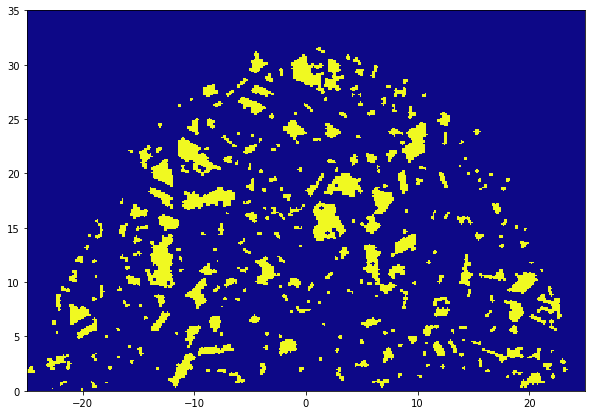

10800
(329,)


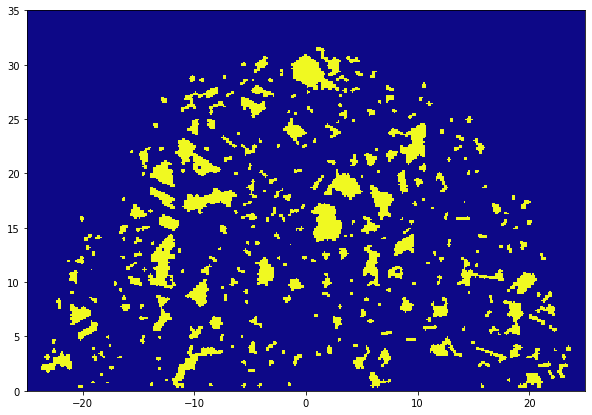

10900
(329,)


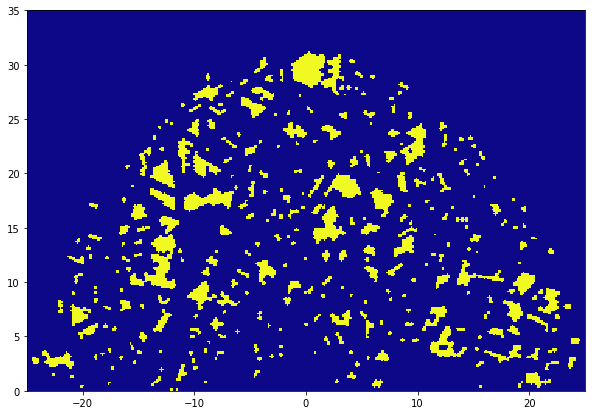

In [299]:
order_thrashold = 0.9
times = np.arange(100,11000,100)
plotpath = "texfiles/16_09_2021_videos/cluster_time_evolution" + str(th) 
os.system("mkdir " + plotpath)
for second, i  in zip(times,range(times.shape[0])):
    print(second)
    ordermatrix = np.load("texfiles/" + "field_N_ped_8000_Esigma_3/fieldtemp_large/order" + str(second) + ".npy")
    densnorm = np.load("texfiles/" + "field_N_ped_8000_Esigma_3/fieldtemp_large/densnorm" + str(second) + ".npy") 

    densnorm = np.array(densnorm)
    densnorm = densnorm.mean(axis=0)
    #random_number = random.randint(1,28)
    random_number = 23
    densnorm = densnorm[random_number]

    ordermatrix = np.array(ordermatrix)
    ordermatrix = ordermatrix.mean(axis=0)
    ordermatrix = ordermatrix[random_number]

    where_0 = np.where(np.isnan(ordermatrix))
    ordermatrix[where_0] = 0

    #where_dens = np.where(densnorm <= 0.4)

    ordermatrix = fieldFilter(ordermatrix,densnorm,0.2,0,False)
    #speed = ax.pcolormesh(x_array, y_array, ordermatrix,color = "green" ,vmin = 1)

    #x,y = np.meshgrid(x_array,y_array)
    #distfield = np.sqrt(x ** 2 + y ** 2)
    #ordermatrix = fieldFilter(ordermatrix,distfield,10,0,False)
    #ordermatrix = fieldFilter(ordermatrix,distfield,25,0,True)

    ordermatrix = fieldFilter(ordermatrix,ordermatrix,order_thrashold,1,True)
    ordermatrix = fieldFilter(ordermatrix,ordermatrix,order_thrashold,0,False)
    #densnorm = fieldFilter(densnorm,densnorm,0.4,0,False)
    

    #label = hoshen_kopelman(ordermatrix)

    print(val.shape)
    fig, ax = plt.subplots(1,1, figsize = (7 * 50/35,7))
    #plt.pcolormesh(x_array, y_array, label,cmap = cmap,vmin = 6)
    #plt.show()
    cmap = "plasma"
    #cmap = plt.get_cmap('flag', val.shape[0])
    #cmap.set_under('gray')
    #speed = ax[0].pcolormesh(x_array, y_array, ordermatrix,cmap = "plasma" ,vmin = 0)
    speed = ax.pcolormesh(x_array, y_array, ordermatrix,cmap = cmap ,vmin = 0,vmax = 1)
    fig.savefig(plotpath + "/" + imgName(i) + ".png")

    plt.show()

In [283]:
print(order_thrashold
     )

0.9


In [966]:

import itertools

def find(x):
    """x = int(x)
    y = int(x)
    while (labels[y] != y):
        y = labels[y]

    while (labels[x] != x):
        z = int(labels[x]);
        labels[x] = y
        x = z"""
    y = np.where(labels == x)
    return y

def union(left_label,above_label,label):
    #print(above_label)
    #print(above_label)
    where_above = np.where(label == above_label)
    label[where_above] = left_label
    return label

    
def hoshen_kopelman(occupied):
    largest_label = 0
    n_columns = occupied.shape[0]
    n_rows = occupied.shape[1]
    label = np.zeros([n_columns,n_rows])

    labels = np.arange(0,int(n_columns*n_rows) ,1)
    
    
    #for x in np.arange(0,n_columns, 1):
        #for y in np.arange(0,n_rows, 1):
            
    for x, y in itertools.product(range(n_columns),range(n_rows)):
        if occupied[x,y]:
            left = 0
            above = 0
            if x - 1 >= 0:
                left = occupied[x-1,y]
            if y - 1 >= 0:
                above = occupied[x,y-1]
            if (left == 0) and (above == 0):
                largest_label += 1
                label[x,y] = largest_label 
            elif (left != 0) and (above == 0):
                label[x,y] = label[x - 1,y]
            elif (left == 0) and (above != 0):
                label[x,y] = label[x,y - 1]
            else: 
                label[x,y] = label[x,y-1]
                label = union(label[x-1,y],label[x,y-1],label)
    return label


def hoshen_kopelman_efficient(occupied):
    largest_label = 0
    n_columns = occupied.shape[0]
    n_rows = occupied.shape[1]
    label = np.zeros([n_columns,n_rows])

    labels = np.arange(0,int(n_columns*n_rows) ,1)
    
    
    #for x in np.arange(0,n_columns, 1):
        #for y in np.arange(0,n_rows, 1):
            
    for x, y in itertools.product(range(n_columns),range(n_rows)):
        if occupied[x,y]:
            left = 0
            above = 0
            if x - 1 >= 0:
                left = occupied[x-1,y]
            if y - 1 >= 0:
                above = occupied[x,y-1]
            if (left == 0) and (above == 0):
                largest_label += 1
                label[x,y] = largest_label 
            elif (left != 0) and (above == 0):
                label[x,y] = label[x - 1,y]
            elif (left == 0) and (above != 0):
                label[x,y] = label[x,y - 1]
            else: 
                label[x,y] = label[x,y-1]
                label = union(label[x-1,y],label[x,y-1],label)
    return label
                

In [1513]:
occupied = np.array([[1,0,0,1,0,0],[0,1,1,1,1,0],[0,0,1,0,0,0],[1,1,0,1,1,0],[0,0,1,1,0,1],[0,0,0,0,1,1]])
print(occupied.shape)

label = hoshen_kopelman(occupied)

#plt.pcolormesh(occupied.shape[0], occupied.shape[1], label,vmin = 0)
print(label)
#plt.pcolormesh(np.arange(0,img.shape[0]), np.arange(0,img.shape[1]), label,vmin = 0)


(6, 6)
[[1. 0. 0. 2. 0. 0.]
 [0. 3. 3. 3. 3. 0.]
 [0. 0. 3. 0. 0. 0.]
 [4. 4. 0. 5. 5. 0.]
 [0. 0. 6. 6. 0. 7.]
 [0. 0. 0. 0. 8. 8.]]


In [186]:
#def union(x,y,labels):
@jit
def hoschen_wiki(occupied,label,n_columns,n_rows):
    largest_label = 0
    for x in range(n_columns): 
        for y in range(n_rows): 
            if occupied[x, y]:
                left = label[x-1, y]
                above = label[x, y-1]
                if (left == 0) and (above == 0):  #/* Neither a label above nor to the left. */
                    largest_label += 1 #/* Make a new, as-yet-unused cluster label. */
                    label[x, y] = largest_label
                    #labels[largest_label] = 1
                elif (left != 0) and (above == 0): #then /* One neighbor, to the left. */
                    label[x, y] = left
                    #labels[int(left)].append([x,y])
                elif (left == 0) and (above != 0): #then /* One neighbor, above. */
                    label[x, y] = above
                    #labels[int(above)].append([x,y])
                else: #/* Neighbors BOTH to the left and above. */
                    #labels = union(left,above,labels) #/* Link the left and above clusters. */
                    label[x, y] = above
                    #labels[int(above)].append([x,y])
        return label


def hoschen_wiki_ini(occupied):
    largest_label = 0
    n_columns = occupied.shape[0]
    n_rows = occupied.shape[1]
    label = np.zeros([n_columns,n_rows])
    #labels = np.arange(0,n_columns*n_rows ) # Array containing integers from 0 to the size of the image. */
    labels = [i for i in range(n_columns * n_rows)]
    print(labels)
    label =  hoschen_wiki(occupied,label,n_columns,n_rows)
    
                    #union(int(above),labels)
            #print(labels)
    #print(labels)
    return label


In [187]:
occupied = np.array([[1,0,0,1,0,0],[0,1,1,1,1,0],[0,0,1,0,0,0],[1,1,0,1,1,0],[0,0,1,1,0,1],[0,0,0,0,1,1]])
print(occupied.shape)

label = hoschen_wiki_ini(occupied)b
#label = hoschen_wiki(label)
print(label)
#plt.pcolormesh(occupied.shape[0], occupied.shape[1], label,vmin = 0)
#plt.pcolormesh(np.arange(0,img.shape[0]), np.arange(0,img.shape[1]), label,vmin = 0)


(6, 6)
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35]
[[1. 0. 0. 2. 0. 0.]
 [0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0.]]


# Experimental data

In [309]:
#df = df[df['y'] > 0]
#Calculation Shape Factor
def calculateShapeFactor(df):
    import ShapeFactor as shape
    #import shape
    shape_factor_array = np.empty(df.shape[0])
    counter = 0
    frames = []
    times_frames = []
    for esig in np.unique(df.esigma.to_numpy()):
        df_esig = df.loc[df['esigma'] == esig]
        for i in np.sort(np.unique(df.i.to_numpy())):
            #print(i)
            df_i = df_esig.loc[df_esig['i'] == i]
            for t in np.sort(np.unique(df_i.second.to_numpy())):
                df_time = df_i.loc[df_i['second'] == t]
                df_time = df_time.sort_values(by = ['x','y'])
                #if df_time.shape[0] > 0:
                print("esigma = ", esig, "i = ", i, "t = ", t)
                x_max = df_time['x'].max()
                x_min = df_time['x'].min()
                y_max = df_time['y'].max()
                y_min = df_time['y'].min() 
                #print(x_min,x_max,y_min,y_max)
                room = [x_min - 0.3, x_max + 0.3, y_min - 0.3, y_max + 0.3]
                pointframe = addPedFrame([x_min - 0.5, x_max + 0.5, y_min - 0.5, y_max + 0.5])
                lat = np.vstack((df_time['x'].to_numpy(),df_time['y'].to_numpy())).T
                lat = np.vstack([lat,pointframe])
                #vor = Voronoi(lat)
                """fig = voronoi_plot_2d(vor, show_vertices=False, line_colors='orange',
                           line_width=2, line_alpha=0.6, point_size=2)
                plt.show()"""
                #print(lat.shape)
                shapefactor,centroidx,centroidy = ShapeFactor(lat,room)
                #print(centroidx.shape,centroidy.shape,shapefactor.shape)
                new_frame = pd.DataFrame({'x':np.round(centroidx,2),'y':np.round(centroidy,2),"ShapeFactor": shapefactor})
                new_frame = new_frame.sort_values(by = ['x','y'])
                #frames.append(new_frame)
                #print(df_time.shape,new_frame.shape)
                #print(new_frame)
                df_time['ShapeFactor'] = new_frame['ShapeFactor'].to_numpy()
                #times_frames.append(df_time)
                #df_time['ShapeFactor'] = new_frame['ShapeFactor'].to_numpy()
                arange = np.arange(counter,counter + shapefactor.shape[0])
                np.put(shape_factor_array,arange,new_frame['ShapeFactor'].to_numpy())
                counter += new_frame['ShapeFactor'].shape[0]
    df = df.sort_values(by = ['esigma','i','second','x','y'])
    df['ShapeFactor'] = shape_factor_array
    return df



        


In [458]:
#col = ["id", "frame", "x/cm", "y/cm"]
col = ["id", "frame", "x", "y"]


#df_exp = pd.read_csv("exp_results/trajectories/ao-240-400_combine.txt",header = 0,comment = "#",sep = "\s+",usecols = col ) 
df_exp = pd.read_csv("exp_results/trajectories/ao-240-400_combine.txt",header = 0,comment = "#",sep = "\s+") 
print(df_exp)
#df_exp = df_exp.rename(columns = {"x/cm":"x","y/cm":"y"})

      id    frame          x        y
1     30 -194.198  408.00100  163.111
1     31 -194.198  408.00100  163.111
1     32 -194.274  407.95100  163.111
1     33 -194.139  407.98300  163.111
1     34 -194.189  407.72200  163.111
..   ...      ...        ...      ...
352  839  183.141    8.77139  163.175
352  840  181.561    3.20791  163.175
352  841  180.223   -1.96877  163.175
352  842  179.102   -7.21923  163.175
352  843  178.852  -12.08370  163.175

[150256 rows x 4 columns]


In [492]:
df_exp = pd.read_csv("exp_results/trajectories_navarra_large/20170505_000001/20170505_000001tracorr001.dat",names = ["frame","x","frame"],comment = "#",sep = "\s+" ) 

In [467]:
#df_exp.keys() = ['x','y','t']
print(df_exp)

             x         y   frame
0    -2.660549  1.153394     1.0
1    -2.660550  1.153279     2.0
2    -2.660343  1.152792     3.0
3    -2.660252  1.152560     4.0
4    -2.659928  1.151636     5.0
...        ...       ...     ...
1002 -0.558174 -1.054562  1003.0
1003 -0.557854 -1.067347  1004.0
1004 -0.557403 -1.082499  1005.0
1005 -0.556204 -1.099483  1006.0
1006 -0.555807 -1.114076  1007.0

[1007 rows x 3 columns]


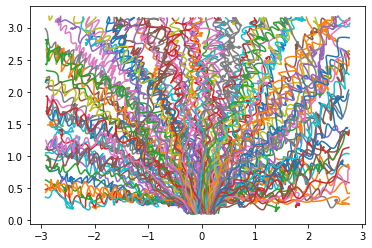

In [500]:
dfs = []
for i in np.arange(1,189):
    ID = i 
    i = imgName(i)
    df_exp = pd.read_csv("exp_results/trajectories_navarra_large/20170505_000001/20170505_000001tracorr" + str(i) + ".dat",names = ["frame","x","y"],comment = "#",sep = "\s+" ) 
    plt.plot(df_exp.x,df_exp.y)
    df_exp['id'] = sf.listMaker(ID,df_exp.shape[0])
    dfs.append(df_exp)

#plt.xlim([-2.5,2])
#plt.ylim([-2,2])
df_exp = pd.concat(dfs)

In [501]:
df_exp['i'] = sf.listMaker(0,df_exp.shape[0])
df_exp['esigma'] = sf.listMaker(0,df_exp.shape[0])

In [502]:
df_exp['second'] = df_exp.frame/16

In [503]:
df_exp

,frame,x,y,id,i,esigma,second
0,30.0,0.809757,0.223247,1.0,0.0,0.0,1.8750
1,31.0,0.806531,0.220298,1.0,0.0,0.0,1.9375
2,32.0,0.803030,0.217834,1.0,0.0,0.0,2.0000
3,33.0,0.799889,0.215545,1.0,0.0,0.0,2.0625
4,34.0,0.796273,0.214048,1.0,0.0,0.0,2.1250
...,...,...,...,...,...,...,...
384,1781.0,0.233148,0.319077,188.0,0.0,0.0,111.3125
385,1782.0,0.215128,0.275309,188.0,0.0,0.0,111.3750
386,1783.0,0.195469,0.227997,188.0,0.0,0.0,111.4375
387,1784.0,0.173815,0.180380,188.0,0.0,0.0,111.5000


In [425]:
df_exp.x = df_exp.x/100
df_exp.y = df_exp.y/100

In [504]:
df_exp['r'] = np.sqrt(df_exp.x**2 + df_exp.y**2)

In [505]:
import ShapeFactor as shape
df_exp = calculateShapeFactor(df_exp)

esigma =  0.0 i =  0.0 t =  1.875
esigma =  0.0 i =  0.0 t =  1.9375
esigma =  0.0 i =  0.0 t =  2.0
esigma =  0.0 i =  0.0 t =  2.0625
esigma =  0.0 i =  0.0 t =  2.125
esigma =  0.0 i =  0.0 t =  2.1875
esigma =  0.0 i =  0.0 t =  2.25
esigma =  0.0 i =  0.0 t =  2.3125
esigma =  0.0 i =  0.0 t =  2.375
esigma =  0.0 i =  0.0 t =  2.4375
esigma =  0.0 i =  0.0 t =  2.5
esigma =  0.0 i =  0.0 t =  2.5625
esigma =  0.0 i =  0.0 t =  2.625
esigma =  0.0 i =  0.0 t =  2.6875
esigma =  0.0 i =  0.0 t =  2.75
esigma =  0.0 i =  0.0 t =  2.8125
esigma =  0.0 i =  0.0 t =  2.875
esigma =  0.0 i =  0.0 t =  2.9375
esigma =  0.0 i =  0.0 t =  3.0
esigma =  0.0 i =  0.0 t =  3.0625
esigma =  0.0 i =  0.0 t =  3.125
esigma =  0.0 i =  0.0 t =  3.1875
esigma =  0.0 i =  0.0 t =  3.25
esigma =  0.0 i =  0.0 t =  3.3125
esigma =  0.0 i =  0.0 t =  3.375
esigma =  0.0 i =  0.0 t =  3.4375
esigma =  0.0 i =  0.0 t =  3.5
esigma =  0.0 i =  0.0 t =  3.5625
esigma =  0.0 i =  0.0 t =  3.625
esigma =  0

esigma =  0.0 i =  0.0 t =  16.6875
esigma =  0.0 i =  0.0 t =  16.75
esigma =  0.0 i =  0.0 t =  16.8125
esigma =  0.0 i =  0.0 t =  16.875
esigma =  0.0 i =  0.0 t =  16.9375
esigma =  0.0 i =  0.0 t =  17.0
esigma =  0.0 i =  0.0 t =  17.0625
esigma =  0.0 i =  0.0 t =  17.125
esigma =  0.0 i =  0.0 t =  17.1875
esigma =  0.0 i =  0.0 t =  17.25
esigma =  0.0 i =  0.0 t =  17.3125
esigma =  0.0 i =  0.0 t =  17.375
esigma =  0.0 i =  0.0 t =  17.4375
esigma =  0.0 i =  0.0 t =  17.5
esigma =  0.0 i =  0.0 t =  17.5625
esigma =  0.0 i =  0.0 t =  17.625
esigma =  0.0 i =  0.0 t =  17.6875
esigma =  0.0 i =  0.0 t =  17.75
esigma =  0.0 i =  0.0 t =  17.8125
esigma =  0.0 i =  0.0 t =  17.875
esigma =  0.0 i =  0.0 t =  17.9375
esigma =  0.0 i =  0.0 t =  18.0
esigma =  0.0 i =  0.0 t =  18.0625
esigma =  0.0 i =  0.0 t =  18.125
esigma =  0.0 i =  0.0 t =  18.1875
esigma =  0.0 i =  0.0 t =  18.25
esigma =  0.0 i =  0.0 t =  18.3125
esigma =  0.0 i =  0.0 t =  18.375
esigma =  0.0 i 

esigma =  0.0 i =  0.0 t =  31.5625
esigma =  0.0 i =  0.0 t =  31.625
esigma =  0.0 i =  0.0 t =  31.6875
esigma =  0.0 i =  0.0 t =  31.75
esigma =  0.0 i =  0.0 t =  31.8125
esigma =  0.0 i =  0.0 t =  31.875
esigma =  0.0 i =  0.0 t =  31.9375
esigma =  0.0 i =  0.0 t =  32.0
esigma =  0.0 i =  0.0 t =  32.0625
esigma =  0.0 i =  0.0 t =  32.125
esigma =  0.0 i =  0.0 t =  32.1875
esigma =  0.0 i =  0.0 t =  32.25
esigma =  0.0 i =  0.0 t =  32.3125
esigma =  0.0 i =  0.0 t =  32.375
esigma =  0.0 i =  0.0 t =  32.4375
esigma =  0.0 i =  0.0 t =  32.5
esigma =  0.0 i =  0.0 t =  32.5625
esigma =  0.0 i =  0.0 t =  32.625
esigma =  0.0 i =  0.0 t =  32.6875
esigma =  0.0 i =  0.0 t =  32.75
esigma =  0.0 i =  0.0 t =  32.8125
esigma =  0.0 i =  0.0 t =  32.875
esigma =  0.0 i =  0.0 t =  32.9375
esigma =  0.0 i =  0.0 t =  33.0
esigma =  0.0 i =  0.0 t =  33.0625
esigma =  0.0 i =  0.0 t =  33.125
esigma =  0.0 i =  0.0 t =  33.1875
esigma =  0.0 i =  0.0 t =  33.25
esigma =  0.0 i 

esigma =  0.0 i =  0.0 t =  46.6875
esigma =  0.0 i =  0.0 t =  46.75
esigma =  0.0 i =  0.0 t =  46.8125
esigma =  0.0 i =  0.0 t =  46.875
esigma =  0.0 i =  0.0 t =  46.9375
esigma =  0.0 i =  0.0 t =  47.0
esigma =  0.0 i =  0.0 t =  47.0625
esigma =  0.0 i =  0.0 t =  47.125
esigma =  0.0 i =  0.0 t =  47.1875
esigma =  0.0 i =  0.0 t =  47.25
esigma =  0.0 i =  0.0 t =  47.3125
esigma =  0.0 i =  0.0 t =  47.375
esigma =  0.0 i =  0.0 t =  47.4375
esigma =  0.0 i =  0.0 t =  47.5
esigma =  0.0 i =  0.0 t =  47.5625
esigma =  0.0 i =  0.0 t =  47.625
esigma =  0.0 i =  0.0 t =  47.6875
esigma =  0.0 i =  0.0 t =  47.75
esigma =  0.0 i =  0.0 t =  47.8125
esigma =  0.0 i =  0.0 t =  47.875
esigma =  0.0 i =  0.0 t =  47.9375
esigma =  0.0 i =  0.0 t =  48.0
esigma =  0.0 i =  0.0 t =  48.0625
esigma =  0.0 i =  0.0 t =  48.125
esigma =  0.0 i =  0.0 t =  48.1875
esigma =  0.0 i =  0.0 t =  48.25
esigma =  0.0 i =  0.0 t =  48.3125
esigma =  0.0 i =  0.0 t =  48.375
esigma =  0.0 i 

esigma =  0.0 i =  0.0 t =  61.3125
esigma =  0.0 i =  0.0 t =  61.375
esigma =  0.0 i =  0.0 t =  61.4375
esigma =  0.0 i =  0.0 t =  61.5
esigma =  0.0 i =  0.0 t =  61.5625
esigma =  0.0 i =  0.0 t =  61.625
esigma =  0.0 i =  0.0 t =  61.6875
esigma =  0.0 i =  0.0 t =  61.75
esigma =  0.0 i =  0.0 t =  61.8125
esigma =  0.0 i =  0.0 t =  61.875
esigma =  0.0 i =  0.0 t =  61.9375
esigma =  0.0 i =  0.0 t =  62.0
esigma =  0.0 i =  0.0 t =  62.0625
esigma =  0.0 i =  0.0 t =  62.125
esigma =  0.0 i =  0.0 t =  62.1875
esigma =  0.0 i =  0.0 t =  62.25
esigma =  0.0 i =  0.0 t =  62.3125
esigma =  0.0 i =  0.0 t =  62.375
esigma =  0.0 i =  0.0 t =  62.4375
esigma =  0.0 i =  0.0 t =  62.5
esigma =  0.0 i =  0.0 t =  62.5625
esigma =  0.0 i =  0.0 t =  62.625
esigma =  0.0 i =  0.0 t =  62.6875
esigma =  0.0 i =  0.0 t =  62.75
esigma =  0.0 i =  0.0 t =  62.8125
esigma =  0.0 i =  0.0 t =  62.875
esigma =  0.0 i =  0.0 t =  62.9375
esigma =  0.0 i =  0.0 t =  63.0
esigma =  0.0 i =

esigma =  0.0 i =  0.0 t =  76.625
esigma =  0.0 i =  0.0 t =  76.6875
esigma =  0.0 i =  0.0 t =  76.75
esigma =  0.0 i =  0.0 t =  76.8125
esigma =  0.0 i =  0.0 t =  76.875
esigma =  0.0 i =  0.0 t =  76.9375
esigma =  0.0 i =  0.0 t =  77.0
esigma =  0.0 i =  0.0 t =  77.0625
esigma =  0.0 i =  0.0 t =  77.125
esigma =  0.0 i =  0.0 t =  77.1875
esigma =  0.0 i =  0.0 t =  77.25
esigma =  0.0 i =  0.0 t =  77.3125
esigma =  0.0 i =  0.0 t =  77.375
esigma =  0.0 i =  0.0 t =  77.4375
esigma =  0.0 i =  0.0 t =  77.5
esigma =  0.0 i =  0.0 t =  77.5625
esigma =  0.0 i =  0.0 t =  77.625
esigma =  0.0 i =  0.0 t =  77.6875
esigma =  0.0 i =  0.0 t =  77.75
esigma =  0.0 i =  0.0 t =  77.8125
esigma =  0.0 i =  0.0 t =  77.875
esigma =  0.0 i =  0.0 t =  77.9375
esigma =  0.0 i =  0.0 t =  78.0
esigma =  0.0 i =  0.0 t =  78.0625
esigma =  0.0 i =  0.0 t =  78.125
esigma =  0.0 i =  0.0 t =  78.1875
esigma =  0.0 i =  0.0 t =  78.25
esigma =  0.0 i =  0.0 t =  78.3125
esigma =  0.0 i 

esigma =  0.0 i =  0.0 t =  92.25
esigma =  0.0 i =  0.0 t =  92.3125
esigma =  0.0 i =  0.0 t =  92.375
esigma =  0.0 i =  0.0 t =  92.4375
esigma =  0.0 i =  0.0 t =  92.5
esigma =  0.0 i =  0.0 t =  92.5625
esigma =  0.0 i =  0.0 t =  92.625
esigma =  0.0 i =  0.0 t =  92.6875
esigma =  0.0 i =  0.0 t =  92.75
esigma =  0.0 i =  0.0 t =  92.8125
esigma =  0.0 i =  0.0 t =  92.875
esigma =  0.0 i =  0.0 t =  92.9375
esigma =  0.0 i =  0.0 t =  93.0
esigma =  0.0 i =  0.0 t =  93.0625
esigma =  0.0 i =  0.0 t =  93.125
esigma =  0.0 i =  0.0 t =  93.1875
esigma =  0.0 i =  0.0 t =  93.25
esigma =  0.0 i =  0.0 t =  93.3125
esigma =  0.0 i =  0.0 t =  93.375
esigma =  0.0 i =  0.0 t =  93.4375
esigma =  0.0 i =  0.0 t =  93.5
esigma =  0.0 i =  0.0 t =  93.5625
esigma =  0.0 i =  0.0 t =  93.625
esigma =  0.0 i =  0.0 t =  93.6875
esigma =  0.0 i =  0.0 t =  93.75
esigma =  0.0 i =  0.0 t =  93.8125
esigma =  0.0 i =  0.0 t =  93.875
esigma =  0.0 i =  0.0 t =  93.9375
esigma =  0.0 i 

esigma =  0.0 i =  0.0 t =  107.25
esigma =  0.0 i =  0.0 t =  107.3125
esigma =  0.0 i =  0.0 t =  107.375
esigma =  0.0 i =  0.0 t =  107.4375
esigma =  0.0 i =  0.0 t =  107.5
esigma =  0.0 i =  0.0 t =  107.5625
esigma =  0.0 i =  0.0 t =  107.625
esigma =  0.0 i =  0.0 t =  107.6875
esigma =  0.0 i =  0.0 t =  107.75
esigma =  0.0 i =  0.0 t =  107.8125
esigma =  0.0 i =  0.0 t =  107.875
esigma =  0.0 i =  0.0 t =  107.9375
esigma =  0.0 i =  0.0 t =  108.0
esigma =  0.0 i =  0.0 t =  108.0625
esigma =  0.0 i =  0.0 t =  108.125
esigma =  0.0 i =  0.0 t =  108.1875
esigma =  0.0 i =  0.0 t =  108.25
esigma =  0.0 i =  0.0 t =  108.3125
esigma =  0.0 i =  0.0 t =  108.375
esigma =  0.0 i =  0.0 t =  108.4375
esigma =  0.0 i =  0.0 t =  108.5
esigma =  0.0 i =  0.0 t =  108.5625
esigma =  0.0 i =  0.0 t =  108.625
esigma =  0.0 i =  0.0 t =  108.6875
esigma =  0.0 i =  0.0 t =  108.75
esigma =  0.0 i =  0.0 t =  108.8125
esigma =  0.0 i =  0.0 t =  108.875
esigma =  0.0 i =  0.0 t 

In [486]:
def localBondOrientationFactorneu(p_index,tri,filtered,filterbox):
    neigh = find_neighbors(p_index,tri,filtered,filterbox)
    Nb = neigh.shape[0]
    bond_orientation_list = np.empty(Nb)
    exp_sum = 0
    for n in range(Nb - 1):
        bond1 = tri.points[neigh[n]] - tri.points[p_index]
        bond2 = tri.points[neigh[n+1]] - tri.points[p_index]
        leng1 = np.linalg.norm(bond1)
        leng2 = np.linalg.norm(bond2)
        bond1 = bond1/leng1
        bond2 = bond2/leng2
        #print(round(np.dot(bond1,bond2),4))
        #print(np.dot(bond1,bond2) - pi/6)
        #bond_angle = np.cos(6 * np.arccos(round(np.dot(bond1,bond2),4)))
        #cos_sum += bond_angle
        angle =  np.arccos(round(np.dot(bond1,bond2),4))
        bond_angle = cmath.exp(6j * angle)
        exp_sum += bond_angle
        nb_sum = 1/Nb * exp_sum

    bond1 = tri.points[neigh[0]] - tri.points[p_index]
    bond2 = tri.points[neigh[-1]] - tri.points[p_index]
    leng1 = np.linalg.norm(bond1)
    leng2 = np.linalg.norm(bond2)
    bond1 = bond1/leng1
    bond2 = bond2/leng2
    #print(round(np.dot(bond1,bond2),4))
    #print(np.dot(bond1,bond2) - pi/6)
    angle =  np.arccos(round(np.dot(bond1,bond2),4))
    bond_angle = cmath.exp(6j * angle)
    exp_sum += bond_angle
    nb_sum = 1/Nb * exp_sum
    #print(nb_sum)
    #bond_angle = np.cos(6 * np.arccos(round(np.dot(bond1,bond2),4)))
    #cos_sum += bond_angle
    #nb_sum = 1/Nb * cos_sum
    nb_sum = np.sqrt(nb_sum.real**2 + nb_sum.imag**2)
    return nb_sum

def localOrientationMeasures(tri,N,filtered,filterbox):
    neighbour_list = np.empty(N)
    neigh_dist_list = np.empty(N)
    local_bond_list = np.empty(N)
    mean_neighdist_list = np.empty(N)
    #dist_tri, dist = latticeDistance(tri,filterbox)
    #distmean = dist.mean()
    for p_index in range(N):
        neigh_dist = indexDistance(p_index,tri,filtered,filterbox)
        neighbour_list[p_index] = len(find_neighbors(p_index,tri,filtered,filterbox))
        neigh_dist_list[p_index] = np.var(neigh_dist/neigh_dist.mean())#np.sum(np.abs(np.round(neigh_dist/distmean - 1,3)))/neigh_dist.shape[0] #np.var(neigh_dist/neigh_dist.mean())#
        local_bond_list[p_index] = localBondOrientationFactorneu(p_index,tri,filtered,filterbox)
        mean_neighdist_list[p_index] = neigh_dist.mean()
    return neighbour_list, neigh_dist_list, local_bond_list, mean_neighdist_list

def indexDistance(p_index,tri,filtered,filterbox):
    neigh = find_neighbors(p_index,tri,filtered,filterbox)
    dist_list = np.empty(neigh.shape[0])
    for n in range(neigh.shape[0]):
        bond = tri.points[neigh[n]] - tri.points[p_index]
        dist = np.linalg.norm(bond)
        dist_list[n] = dist
    return dist_list

def find_neighbors(pindex, tri,filtered,filterbox):
    neigh = tri.vertex_neighbor_vertices[1][tri.vertex_neighbor_vertices[0][pindex]:tri.vertex_neighbor_vertices[0][pindex+1]]
    if filtered:
        return neighboursFilter(neigh,filterbox,tri)
    else:
        return neigh


def XYLocalAppend(XY,filtered,box):
    x = XY['x'].values
    y = XY['y'].values
    tri,points = sf.delaunayMaker(x,y)
    N = tri.points.shape[0]
    neighbour_list, neigh_dist_list, local_bond_list, mean_neighdist_list = localOrientationMeasures(tri,N,filtered,box)
    XY['Nn'] = neighbour_list
    XY['Dm'] = neigh_dist_list/0.18
    XY['Bf'] = local_bond_list
    XY['Nd'] = mean_neighdist_list
    #XY['second'] = listMaker(second,x.shape[0])
    #XY_red = pedReducer(XY,x_min,x_max,y_min,y_max,300)
    return XY

In [408]:
df_exp = df_exp[df_exp.frame % 25 == 0]

In [429]:
df_exp_t = XYLocalAppend(df_exp[df_exp.frame == 400],False,[])

/Users/jonas/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:79: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/Users/jonas/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:80: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/Users/jonas/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:81: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentati

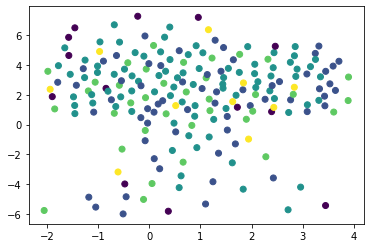

In [506]:
plt.scatter(df_exp_t.x,df_exp_t.y,c = df_exp_t.Nn)

In [403]:

import cmath
a.real

1.0

1


ValueError: No points given

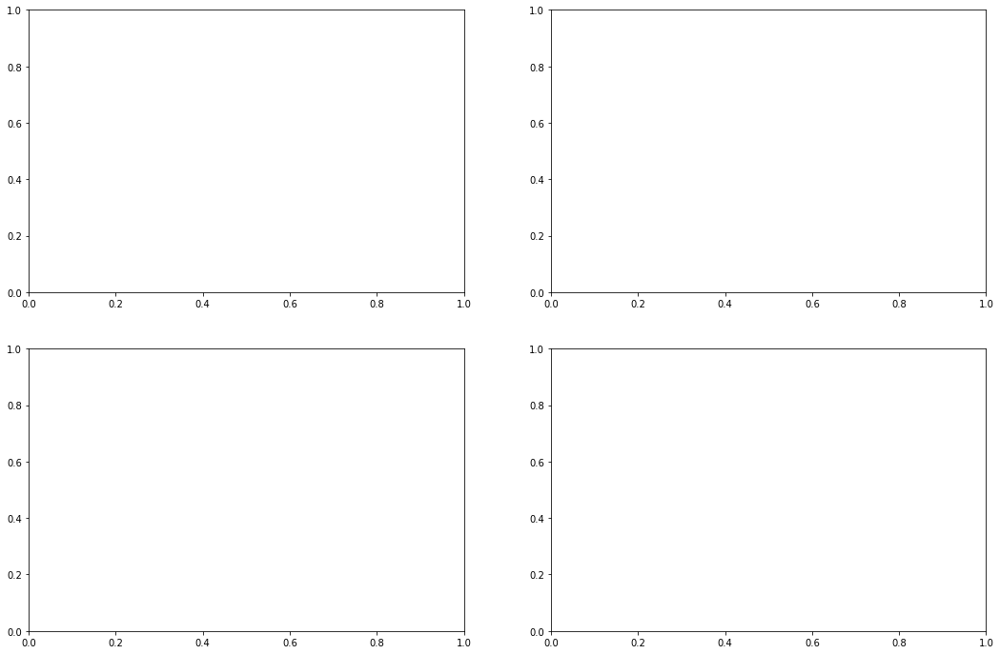

In [507]:
for i in [0]:
    df_i = df_exp[df_exp.i == i]
    #df_i = df_i[df_i.esigma == .8]

    #id_list = df_dist[(df_dist.dist > 0.75) & (df_dist.i == i)].id
    plotpath = "texfiles/StructureInBottleneckFlow/Figures/ShapeDefect"
    os.system("mkdir " + plotpath)
    t = time_list[-1]
    th = 0.88
    #[10,50,100,400,1400]
    fig, axis = plt.subplots(2,2,figsize = (2 * 9 , 2 * 9 * 20/30))
    for ti, axi in zip([[1,10],[20,20]], axis):
        for t , ax in zip(ti,axi):
            print(t)
            #'df_t = df_i[(df_i.second == t) & (df_i.id < 10001)]
            df_t = df_i[df_i.frame == t * 25]
            df_t = XYLocalAppend(df_t,False,[])
            
            #df_t.Nn = df_t.Nn + 1
            #df_6 = df_t[df_t.Nn == 6]
            df_57 = df_t[df_t.Nn != 6]
            #df_id = df_t[df_t.id.isin(id_list)]

            x = df_t.x.to_numpy()
            y = df_t.y.to_numpy()
            x_min = x.min()
            x_max = x.max()
            y_min = y.min()
            y_max = y.max()

            room = [x_min - 0.3, x_max + 0.3, y_min - 0.3, y_max + 0.3]
            pointframe = addPedFrame([x_min - 0.5, x_max + 0.5, y_min - 0.5, y_max + 0.5])
            lat = np.vstack((x,y)).T
            lat = np.vstack([lat,pointframe])
            vor = Voronoi(lat,qhull_options='Qbb Qc Qx')
            #plt.scatter(vor.vertices[:,0],vor.vertices[:,1])
            #fig, ax = plt.subplots(1,figsize = (9 * 1.4, 9 * 20/20))

            VoronoiRidges(vor,ax)
            #cmap = cm.get_cmap('Blues_r')
            cmap = cm.get_cmap('twilight')

            shapescatter = ax.scatter(df_t.x,df_t.y,c=df_t.ShapeFactor, vmin=1.05, vmax=1.3, cmap = cmap,alpha = 1.)
            #sc = ax.scatter(df_t.x,df_t.y,color="grey")

            sc = ax.scatter(df_57.x,df_57.y,c=df_57.Nn, vmin=3., vmax=9., cmap = cm.get_cmap('PiYG', 5),alpha = 1.)

            ax.set_xlim([-4.,4.])
            add_wall(2.5,50,ax)  
            ax.set_ylim([0.,8])
            ax.set_title("time = " + str(t) + " s")

    #fig.colorbar(sc, ticks = [4,5,6,7,8], label = "Coordination Number")
    #fig.colorbar(shapescatter, label = "$\\zeta$")
    #fig.savefig(plotpath + "/" + "DefectBottleneck" + ".pdf")
    #plt.close()
    plt.show()

In [519]:
i = 0
df_i = df_exp[df_exp.i == i]
#id_list = df_dist[(df_dist.dist > 0.75) & (df_dist.i == i)].id

t = time_list[-1]

def imgName1000(i):
    if i < 10:
        return "000" + str(i)
    if i >= 10 and i < 100:
        return "00" + str(i) 
    if i < 1000:
        return "0" + str(i)
    if i < 10000:
        return str(i)

th = 0.88
#[10,50,100,400,1400]
#time_list = time_list[time_list > 2000]
#fig, axis = plt.subplots(2,4,figsize=(5 * 4 ,5 * 2))
frame_list = np.arange(1,df_i.frame.max(),25)
for esig in np.unique(df_i.esigma.to_numpy()):
    plotpath = "texfiles/16_09_2021_videos/experiment_navara0_0/order" 
    os.system("mkdir " + plotpath)
    
    print(plotpath)

    df_esig = df_i[df_i.esigma == 0]
    print(print("\sigma^2 = ", esig))
    print(time_list)
    dfs = []
    for t,i in zip(np.unique(df_esig.frame.to_numpy()),range(np.unique(df_esig.frame.to_numpy()).shape[0])):
        df_t = df_esig[df_esig.frame == t]
        df_t = XYLocalAppend(df_t,False,[])
        dfs.append(df_t)
        #df_57 = df_t[df_t.Nn != 6]
        print(df_t.shape,t)
        #df_6 = df_t[df_t.Nn == 6]
        df_57 = df_t[df_t.Nn != 6]
        #df_id = df_t[df_t.id.isin(id_list)]

        x = df_t.x.to_numpy()
        y = df_t.y.to_numpy()
        x_min = x.min()
        x_max = x.max()
        y_min = y.min()
        y_max = y.max()

        room = [x_min - 0.3, x_max + 0.3, y_min - 0.3, y_max + 0.3]
        pointframe = addPedFrame([x_min - 0.5, x_max + 0.5, y_min - 0.5, y_max + 0.5])
        lat = np.vstack((x,y)).T
        lat = np.vstack([lat,pointframe])
        vor = Voronoi(lat,qhull_options='Qbb Qc Qx')
        fig, ax = plt.subplots(1,figsize = (10 * 1., 10 * 10/10))

        VoronoiRidges(vor,ax)
        b
        cmap = cm.get_cmap('plasma')
        #shapescatter = ax.scatter(df_t.x,df_t.y,color = "grey")
        #df_t = df_t[df_t.Bf >= 0.8]
        #shapescatter = ax.scatter(df_t.x,df_t.y,c=df_t.ShapeFactor, vmin=1.05, vmax=1.3, cmap = cmap,alpha = 1.)
        shapescatter = ax.scatter(df_t.x,df_t.y,c=df_t.Bf, vmin=0, vmax=1., cmap = cmap,alpha = 1.)
        #shapescatter = ax.scatter(df_t.x,df_t.y,c=df_t.ShapeFactor, vmin=1.05, vmax=1.3, cmap = cmap,alpha = 1.)
        #sc = ax.scatter(df_t.x,df_t.y,color="grey")

        #sc = ax.scatter(df_57.x,df_57.y,c=df_57.Nn, vmin=3., vmax=9., cmap = cm.get_cmap('PiYG', 5),alpha = 1.)

        ax.set_xlim([-4,4])
        #add_wall(2.5,50,ax)  
        ax.set_ylim([-1,6])
        ax.set_title("time = " + str(t) + " s")

        #fig.colorbar(sc, ticks = [4,5,6,7,8], label = "Coordination Number")
        #fig.colorbar(shapescatter, label = "$\\zeta$")

        fig.savefig(plotpath + "/" + imgName1000(i) + ".png")
        #fig.savefig(plotpath + "/" + af.b_data_name(esig,3) + ".png")
        plt.close()
df_exp = pd.concat(dfs)
        #plt.show()
        #break

texfiles/16_09_2021_videos/experiment_navara0_0/order
\sigma^2 =  0.0
None
[    0    10    20    30    40    50    60    70    80    90   100   110
   120   130   140   150   160   170   180   190   200   210   220   230
   240   250   260   270   280   290   300   310   320   330   340   350
   360   370   380   390   400   410   420   430   440   450   460   470
   480   490   500   510   520   530   540   550   560   570   580   590
   600   610   620   630   640   650   660   670   680   690   700   710
   720   730   740   750   760   770   780   790   800   810   820   830
   840   850   860   870   880   890   900   910   920   930   940   950
   960   970   980   990  1000  1050  1100  1150  1200  1250  1300  1350
  1400  1450  1500  1550  1600  1650  1700  1750  1800  1850  1900  1950
  2000  2050  2100  2150  2200  2250  2300  2350  2400  2450  2500  2550
  2600  2650  2700  2750  2800  2850  2900  2950  3000  3050  3100  3150
  3200  3250  3300  3350  3400  3450  3500  3550 

/Users/jonas/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:79: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/Users/jonas/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:80: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/Users/jonas/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:81: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentati

(78, 13) 32.0
(78, 13) 33.0
(78, 13) 34.0
(78, 13) 35.0
(78, 13) 36.0
(78, 13) 37.0
(78, 13) 38.0
(78, 13) 39.0
(78, 13) 40.0
(78, 13) 41.0
(78, 13) 42.0
(78, 13) 43.0
(78, 13) 44.0
(78, 13) 45.0
(78, 13) 46.0
(78, 13) 47.0
(78, 13) 48.0
(78, 13) 49.0
(79, 13) 50.0
(79, 13) 51.0
(79, 13) 52.0
(79, 13) 53.0
(79, 13) 54.0
(79, 13) 55.0
(79, 13) 56.0
(79, 13) 57.0
(79, 13) 58.0
(79, 13) 59.0
(79, 13) 60.0
(79, 13) 61.0
(79, 13) 62.0
(79, 13) 63.0
(79, 13) 64.0
(79, 13) 65.0
(79, 13) 66.0
(79, 13) 67.0
(79, 13) 68.0
(79, 13) 69.0
(79, 13) 70.0
(79, 13) 71.0
(78, 13) 72.0
(78, 13) 73.0
(78, 13) 74.0
(78, 13) 75.0
(78, 13) 76.0
(78, 13) 77.0
(78, 13) 78.0
(78, 13) 79.0
(78, 13) 80.0
(79, 13) 81.0
(79, 13) 82.0
(79, 13) 83.0
(79, 13) 84.0
(79, 13) 85.0
(79, 13) 86.0
(79, 13) 87.0
(79, 13) 88.0
(79, 13) 89.0
(79, 13) 90.0
(79, 13) 91.0
(78, 13) 92.0
(78, 13) 93.0
(78, 13) 94.0
(78, 13) 95.0
(78, 13) 96.0
(78, 13) 97.0
(79, 13) 98.0
(79, 13) 99.0
(79, 13) 100.0
(79, 13) 101.0
(79, 13) 102.0
(79

(87, 13) 583.0
(86, 13) 584.0
(86, 13) 585.0
(86, 13) 586.0
(86, 13) 587.0
(87, 13) 588.0
(87, 13) 589.0
(87, 13) 590.0
(87, 13) 591.0
(86, 13) 592.0
(86, 13) 593.0
(86, 13) 594.0
(85, 13) 595.0
(85, 13) 596.0
(85, 13) 597.0
(85, 13) 598.0
(85, 13) 599.0
(85, 13) 600.0
(85, 13) 601.0
(85, 13) 602.0
(85, 13) 603.0
(86, 13) 604.0
(86, 13) 605.0
(86, 13) 606.0
(86, 13) 607.0
(86, 13) 608.0
(86, 13) 609.0
(85, 13) 610.0
(84, 13) 611.0
(84, 13) 612.0
(83, 13) 613.0
(83, 13) 614.0
(83, 13) 615.0
(84, 13) 616.0
(84, 13) 617.0
(84, 13) 618.0
(84, 13) 619.0
(83, 13) 620.0
(83, 13) 621.0
(83, 13) 622.0
(83, 13) 623.0
(82, 13) 624.0
(82, 13) 625.0
(82, 13) 626.0
(82, 13) 627.0
(82, 13) 628.0
(82, 13) 629.0
(82, 13) 630.0
(82, 13) 631.0
(82, 13) 632.0
(83, 13) 633.0
(83, 13) 634.0
(84, 13) 635.0
(85, 13) 636.0
(85, 13) 637.0
(84, 13) 638.0
(84, 13) 639.0
(84, 13) 640.0
(83, 13) 641.0
(83, 13) 642.0
(83, 13) 643.0
(84, 13) 644.0
(84, 13) 645.0
(84, 13) 646.0
(84, 13) 647.0
(85, 13) 648.0
(85, 13) 6

(63, 13) 1122.0
(63, 13) 1123.0
(64, 13) 1124.0
(64, 13) 1125.0
(64, 13) 1126.0
(64, 13) 1127.0
(64, 13) 1128.0
(64, 13) 1129.0
(63, 13) 1130.0
(62, 13) 1131.0
(62, 13) 1132.0
(62, 13) 1133.0
(62, 13) 1134.0
(62, 13) 1135.0
(62, 13) 1136.0
(62, 13) 1137.0
(62, 13) 1138.0
(62, 13) 1139.0
(62, 13) 1140.0
(63, 13) 1141.0
(63, 13) 1142.0
(63, 13) 1143.0
(63, 13) 1144.0
(62, 13) 1145.0
(62, 13) 1146.0
(62, 13) 1147.0
(62, 13) 1148.0
(62, 13) 1149.0
(62, 13) 1150.0
(62, 13) 1151.0
(62, 13) 1152.0
(62, 13) 1153.0
(62, 13) 1154.0
(61, 13) 1155.0
(61, 13) 1156.0
(61, 13) 1157.0
(61, 13) 1158.0
(61, 13) 1159.0
(61, 13) 1160.0
(61, 13) 1161.0
(61, 13) 1162.0
(61, 13) 1163.0
(61, 13) 1164.0
(61, 13) 1165.0
(61, 13) 1166.0
(61, 13) 1167.0
(61, 13) 1168.0
(61, 13) 1169.0
(60, 13) 1170.0
(60, 13) 1171.0
(60, 13) 1172.0
(60, 13) 1173.0
(60, 13) 1174.0
(60, 13) 1175.0
(60, 13) 1176.0
(60, 13) 1177.0
(60, 13) 1178.0
(60, 13) 1179.0
(60, 13) 1180.0
(60, 13) 1181.0
(60, 13) 1182.0
(60, 13) 1183.0
(58, 13)

(14, 13) 1635.0
(14, 13) 1636.0
(14, 13) 1637.0
(14, 13) 1638.0
(14, 13) 1639.0
(14, 13) 1640.0
(14, 13) 1641.0
(14, 13) 1642.0
(14, 13) 1643.0
(14, 13) 1644.0
(13, 13) 1645.0
(13, 13) 1646.0
(13, 13) 1647.0
(13, 13) 1648.0
(13, 13) 1649.0
(13, 13) 1650.0
(13, 13) 1651.0
(13, 13) 1652.0
(12, 13) 1653.0
(12, 13) 1654.0
(12, 13) 1655.0
(12, 13) 1656.0
(12, 13) 1657.0
(12, 13) 1658.0
(12, 13) 1659.0
(12, 13) 1660.0
(12, 13) 1661.0
(12, 13) 1662.0
(11, 13) 1663.0
(11, 13) 1664.0
(11, 13) 1665.0
(11, 13) 1666.0
(11, 13) 1667.0
(11, 13) 1668.0
(11, 13) 1669.0
(11, 13) 1670.0
(11, 13) 1671.0
(11, 13) 1672.0
(11, 13) 1673.0
(11, 13) 1674.0
(11, 13) 1675.0
(10, 13) 1676.0
(10, 13) 1677.0
(10, 13) 1678.0
(10, 13) 1679.0
(10, 13) 1680.0
(10, 13) 1681.0
(10, 13) 1682.0
(10, 13) 1683.0
(9, 13) 1684.0
(8, 13) 1685.0
(8, 13) 1686.0
(8, 13) 1687.0
(8, 13) 1688.0
(8, 13) 1689.0
(8, 13) 1690.0
(8, 13) 1691.0
(8, 13) 1692.0
(8, 13) 1693.0
(8, 13) 1694.0
(8, 13) 1695.0
(8, 13) 1696.0
(8, 13) 1697.0
(8, 13

QhullError: QH6214 qhull input error: not enough points(2) to construct initial simplex (need 4)

While executing:  | qhull d Q12 Qt Qc Qz Qbb
Options selected for Qhull 2015.2.r 2016/01/18:
  run-id 38524800  delaunay  Q12-no-wide-dup  Qtriangulate  Qcoplanar-keep
  Qz-infinity-point  Qbbound-last  _pre-merge  _zero-centrum  Qinterior-keep


In [513]:
t_list = []
nn = []
bf = []
for t,i in zip(np.unique(df_esig.frame.to_numpy()[::10]),range(np.unique(df_esig.frame.to_numpy()).shape[0])):
        print(t)
        df_t = df_esig[df_esig.frame == t]
        df_t = XYLocalAppend(df_t,False,[])
       
        t_list.append(t)
        nn.append(df_t[df_t.Nn == 6].shape[0]/df_t.shape[0])
        bf.append(df_t.Bf.mean())

30.0
31.0
32.0
33.0
34.0
35.0
36.0
37.0
38.0
39.0


/Users/jonas/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:79: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/Users/jonas/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:80: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/Users/jonas/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:81: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentati

40.0
41.0
42.0
43.0
44.0
45.0
46.0
47.0
48.0
49.0
50.0
51.0
52.0
53.0
54.0
55.0
56.0
57.0
58.0
59.0
60.0
61.0
62.0
63.0
64.0
65.0
66.0
67.0
68.0
69.0
70.0
71.0
72.0
73.0
74.0
75.0
76.0
77.0
78.0
79.0
80.0
81.0
82.0
83.0
84.0
85.0
86.0
87.0
88.0
89.0
90.0
91.0
92.0
93.0
94.0
95.0
96.0
97.0
98.0
99.0
100.0
101.0
102.0
103.0
104.0
105.0
106.0
107.0
108.0
109.0
110.0
111.0
112.0
113.0
114.0
115.0
116.0
117.0
118.0
119.0
120.0
121.0
122.0
123.0
124.0
125.0
126.0
127.0
128.0
129.0
130.0
131.0
132.0
133.0
134.0
135.0
136.0
137.0
138.0
139.0
140.0
141.0
142.0
143.0
144.0
145.0
146.0
147.0
148.0
149.0
150.0
151.0
152.0
153.0
154.0
155.0
156.0
157.0
158.0
159.0
160.0
161.0
162.0
163.0
164.0
165.0
166.0
167.0
168.0
169.0
170.0
171.0
172.0
173.0
174.0
175.0
176.0
177.0
178.0
179.0
180.0
181.0
182.0
183.0
184.0
185.0
186.0
187.0
188.0
189.0
190.0
191.0
192.0
193.0
194.0
195.0
196.0
197.0
198.0
199.0
200.0
201.0
202.0
203.0
204.0
205.0
206.0
207.0
208.0
209.0
210.0
211.0
212.0
213.0
214.0
215.0
216.

1370.0
1371.0
1372.0
1373.0
1374.0
1375.0
1376.0
1377.0
1378.0
1379.0
1380.0
1381.0
1382.0
1383.0
1384.0
1385.0
1386.0
1387.0
1388.0
1389.0
1390.0
1391.0
1392.0
1393.0
1394.0
1395.0
1396.0
1397.0
1398.0
1399.0
1400.0
1401.0
1402.0
1403.0
1404.0
1405.0
1406.0
1407.0
1408.0
1409.0
1410.0
1411.0
1412.0
1413.0
1414.0
1415.0
1416.0
1417.0
1418.0
1419.0
1420.0
1421.0
1422.0
1423.0
1424.0
1425.0
1426.0
1427.0
1428.0
1429.0
1430.0
1431.0
1432.0
1433.0
1434.0
1435.0
1436.0
1437.0
1438.0
1439.0
1440.0
1441.0
1442.0
1443.0
1444.0
1445.0
1446.0
1447.0
1448.0
1449.0
1450.0
1451.0
1452.0
1453.0
1454.0
1455.0
1456.0
1457.0
1458.0
1459.0
1460.0
1461.0
1462.0
1463.0
1464.0
1465.0
1466.0
1467.0
1468.0
1469.0
1470.0
1471.0
1472.0
1473.0
1474.0
1475.0
1476.0
1477.0
1478.0
1479.0
1480.0
1481.0
1482.0
1483.0
1484.0
1485.0
1486.0
1487.0
1488.0
1489.0
1490.0
1491.0
1492.0
1493.0
1494.0
1495.0
1496.0
1497.0
1498.0
1499.0
1500.0
1501.0
1502.0
1503.0
1504.0
1505.0
1506.0
1507.0
1508.0
1509.0
1510.0
1511.0
1512.0

QhullError: QH6214 qhull input error: not enough points(2) to construct initial simplex (need 4)

While executing:  | qhull d Q12 Qt Qc Qz Qbb
Options selected for Qhull 2015.2.r 2016/01/18:
  run-id 21684186  delaunay  Q12-no-wide-dup  Qtriangulate  Qcoplanar-keep
  Qz-infinity-point  Qbbound-last  _pre-merge  _zero-centrum  Qinterior-keep


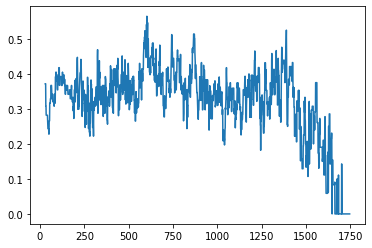

In [514]:
plt.plot(t_list,nn)

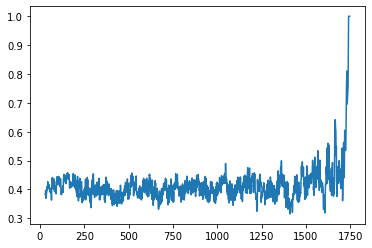

In [515]:
plt.plot(t_list,bf)

AttributeError: 'DataFrameGroupBy' object has no attribute 'Nn'

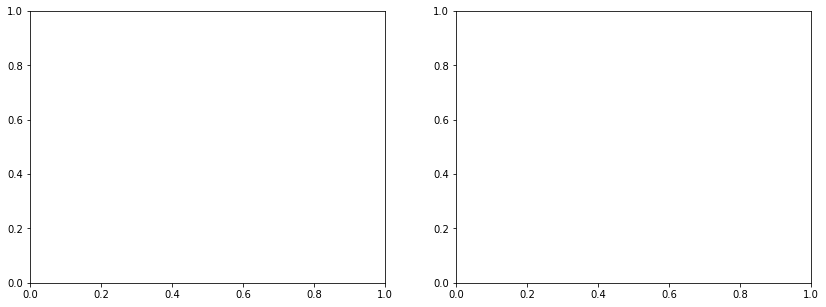

In [528]:
plotpath = "texfiles/14_09_2021_consise_structure/Figures/TimeDensity"
os.system("mkdir " + plotpath)


fig, ax = plt.subplots(1,2,figsize=(14,5))
#df_h_far = df_histo[(df_histo.r >= 12) & (df_histo.r < 25)]
df_h_close = df_exp
times = np.unique(df_exp.frame.to_numpy())

#order_fraction = df_h_far.groupby('t').order_fraction.mean()
#Nn_6 = df_h_far.groupby('t').Nn_6.mean()

#order_fraction_close = df_h_close.groupby('frame').Bf.mean()
Nn_6_close = df_h_close.groupby('frame').Nn.mean()


#ax[0].plot(times,order_fraction, label = "$r$ in [12,25] m")
#ax[1].plot(times,Nn_6)

ax[0].plot(times,order_fraction_close, label = "$r$ in [0,10] m")
ax[1].plot(times,Nn_6_close)
ax[0].legend()
ax[0].set_xlabel('$t$ in s')
#ax[1].set_xlabel('$t$ in s')

ax[0].set_ylabel('fraction of agents with <$\\Psi_6$> > 0.7')
ax[1].set_ylabel('fraction of agents with $N_n = 6$')
#plt.savefig(plotpath + "/order_frac_Nn_6_timeseries.pdf")
